In [1]:
#!/usr/bin/env python
import sys
import argparse
import matplotlib.pyplot as plt
import numpy as np
#import fitsio
from desiutil.log import get_logger
from desispec.io import read_spectra, read_table
from desispec.interpolation import resample_flux
from astropy.table import Table
import redrock.templates
import os

In [2]:
night=20231107; petal=0; tileid=5060
infile = os.path.join('/global/cfs/cdirs/desi/','spectro/redux/daily/tiles/cumulative/', 
                      str(tileid), str(night), 'coadd-{}-{}-thru{}.fits'.format(petal, tileid, night))
only_valid = True
print(infile)
spec=read_spectra(infile)

/global/cfs/cdirs/desi/spectro/redux/daily/tiles/cumulative/5060/20231107/coadd-0-5060-thru20231107.fits
INFO:spectra.py:291:read_spectra: iotime 0.475 sec to read coadd-0-5060-thru20231107.fits at 2023-11-08T10:25:17.885380


In [3]:
redrockfile = os.path.join('/global/cfs/cdirs/desi/','spectro/redux/daily/tiles/cumulative/', 
                      str(tileid), str(night), 'redrock-{}-{}-thru{}.fits'.format(petal, tileid, night))
redshifts=read_table(redrockfile, "REDSHIFTS")

39633117383753792
39633121863271502
39633121863272668
39633121867465285
39633121867466573
39633121863272320
39633121863274000
39633121863273990
39633117383754684
39633117383755494
39633121867465021


In [4]:
selection = np.where(redshifts["ZWARN"]==0)[0]
print(selection)
targetids=np.unique(spec.fibermap["TARGETID"][selection])

[  0   1   2   3   4   5   6   7   8   9  10  13  15  16  18  19  20  21
  22  24  26  27  28  29  30  31  32  36  37  38  39  40  41  42  43  44
  45  46  47  48  51  53  55  57  58  59  60  62  63  64  65  66  67  68
  69  70  71  72  75  76  77  78  79  80  81  83  85  87  88  89  90  91
  92  95  96  97  98 100 101 102 103 104 105 107 108 109 111 112 113 114
 117 119 120 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136
 139 142 143 144 145 146 147 148 149 150 151 153 154 155 156 157 160 161
 163 164 165 166 167 169 170 172 173 174 175 176 177 178 180 181 182 183
 187 189 190 191 192 193 194 195 197 198 199 200 201 203 204 205 207 208
 209 210 212 213 214 215 217 218 220 221 222 223 224 225 226 227 228 231
 232 234 235 236 237 239 240 242 243 244 245 246 247 248 249 250 251 252
 253 255 256 257 258 259 260 261 262 263 264 265 266 268 269 270 271 272
 274 276 277 279 280 281 282 283 284 285 287 289 292 293 295 296 298 299
 300 302 303 304 305 307 311 312 313 314 315 316 31

In [5]:
targetids

2715910477447171
2843462797885442
2852254419779584
3146923531829253
3155724104368131
39633112883267334
39633112883268161
39633112883268403
39633112883268459
39633112883268673
39633112883268966


TARGETID=2715910477447171
    TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
---------------- --------- ---------- ... -------------- --------------
2715910477447171         0        400 ... 60256.45965609 60256.45965609


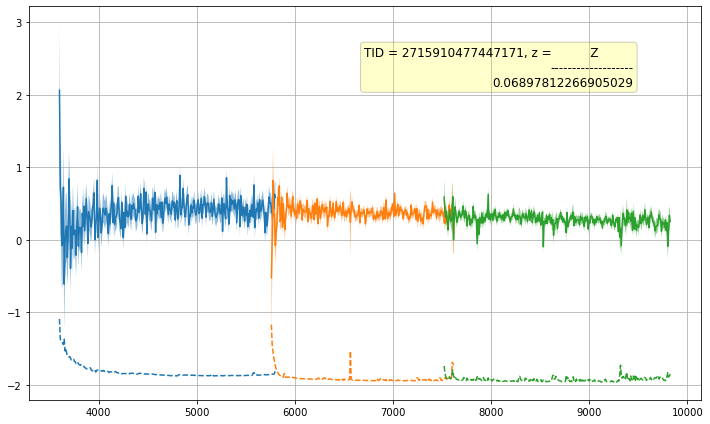

TARGETID=2843462797885442
    TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
---------------- --------- ---------- ... -------------- --------------
2843462797885442         0        174 ... 60256.45965609 60256.45965609


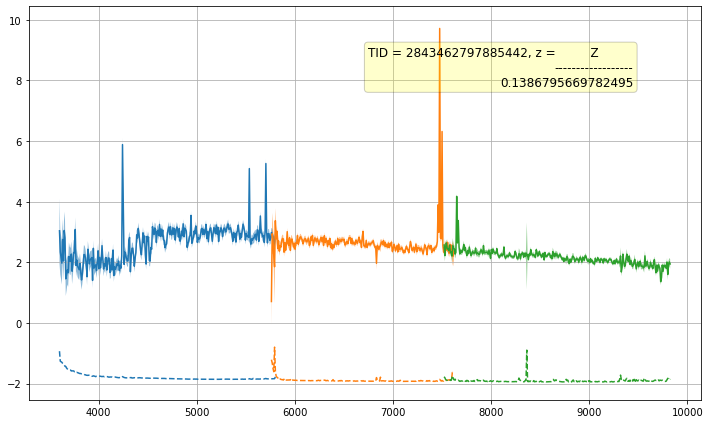

TARGETID=2852254419779584
    TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
---------------- --------- ---------- ... -------------- --------------
2852254419779584         0        280 ... 60256.45965609 60256.45965609


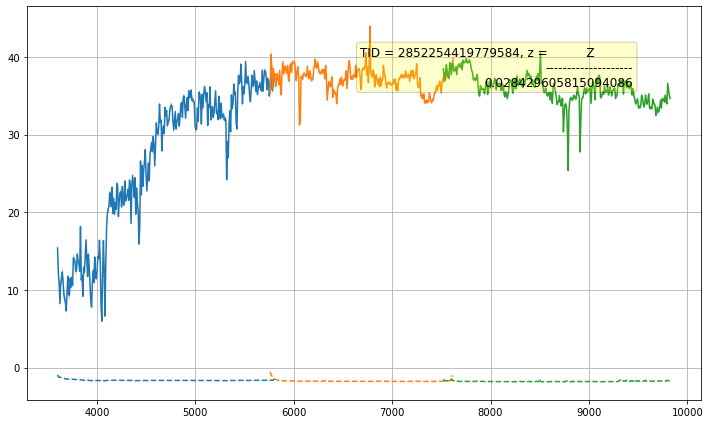

TARGETID=3146923531829253
    TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
---------------- --------- ---------- ... -------------- --------------
3146923531829253         0        343 ... 60256.45965609 60256.45965609


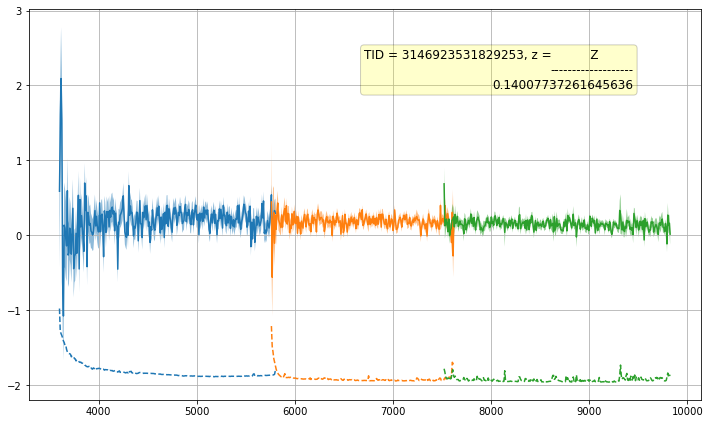

TARGETID=3155724104368131
    TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
---------------- --------- ---------- ... -------------- --------------
3155724104368131         0        230 ... 60256.45965609 60256.45965609


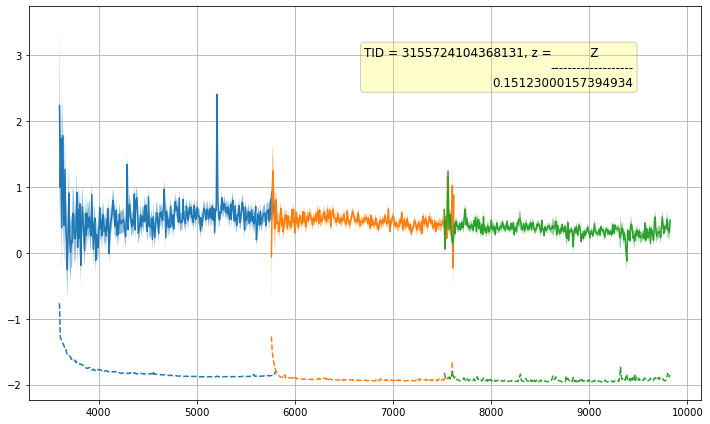

TARGETID=39633112883267334
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112883267334         0        459 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


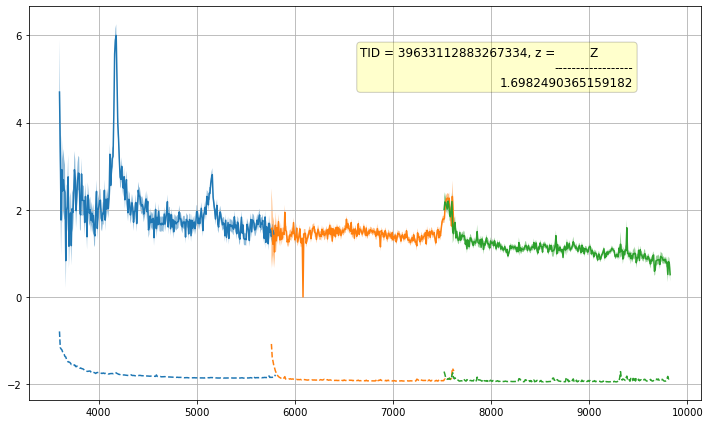

TARGETID=39633112883268161
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112883268161         0        457 ... 60256.45965609 60256.45965609


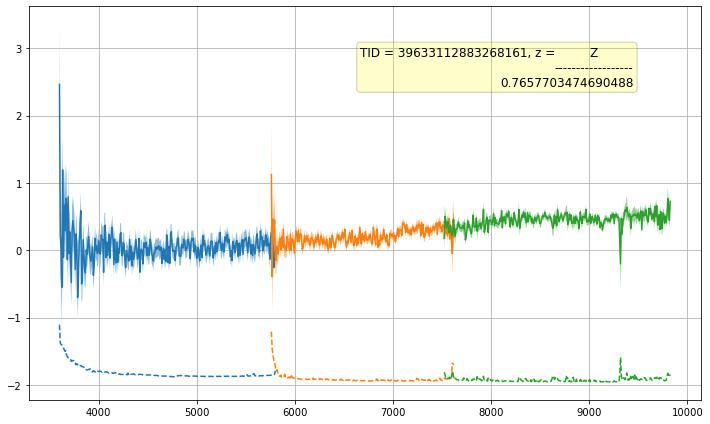

TARGETID=39633112883268403
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112883268403         0        512 ... 60256.45965609 60256.45965609


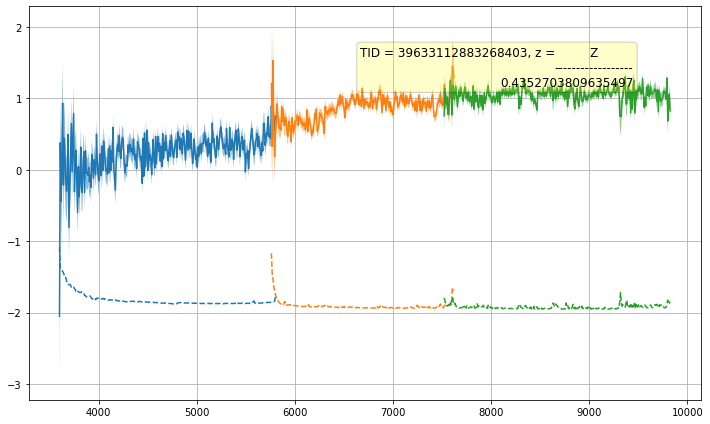

TARGETID=39633112883268459
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112883268459         0        525 ... 60256.45965609 60256.45965609


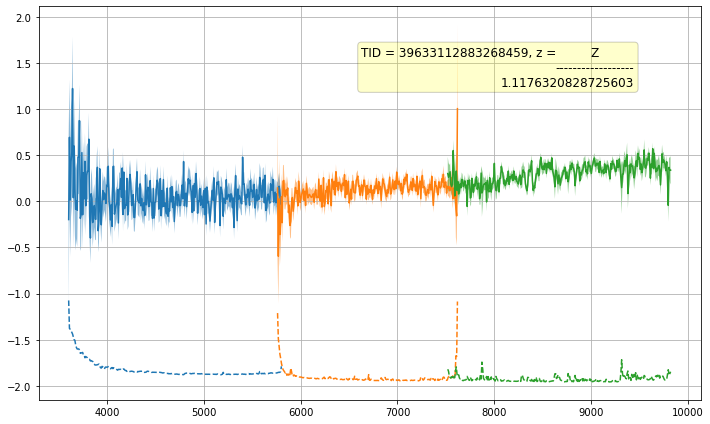

TARGETID=39633112883268673
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112883268673         0        495 ... 60256.45965609 60256.45965609


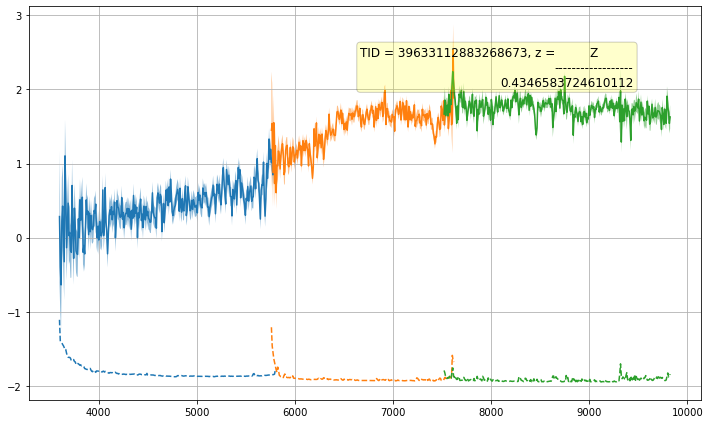

TARGETID=39633112883268966
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112883268966         0        476 ... 60256.45965609 60256.45965609


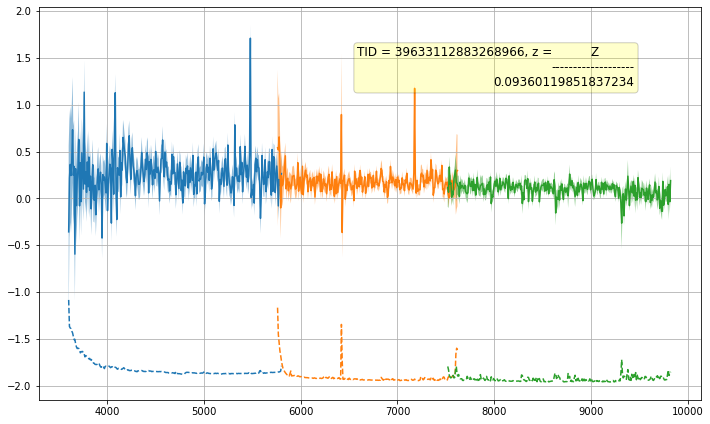

TARGETID=39633112883269044
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112883269044         0        456 ... 60256.45965609 60256.45965609


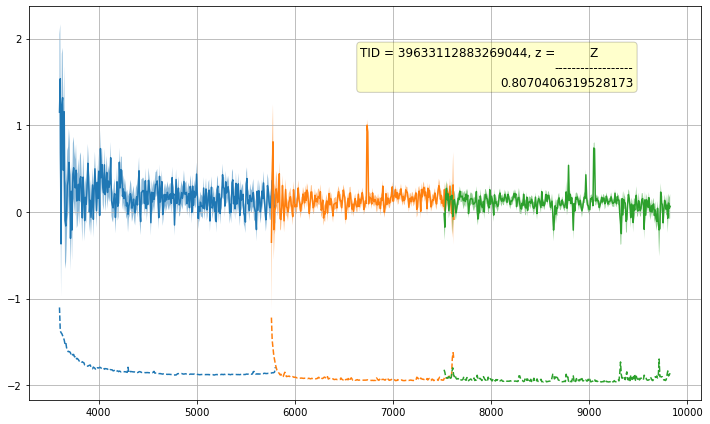

TARGETID=39633112883269249
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112883269249         0        511 ... 60256.45965609 60256.45965609


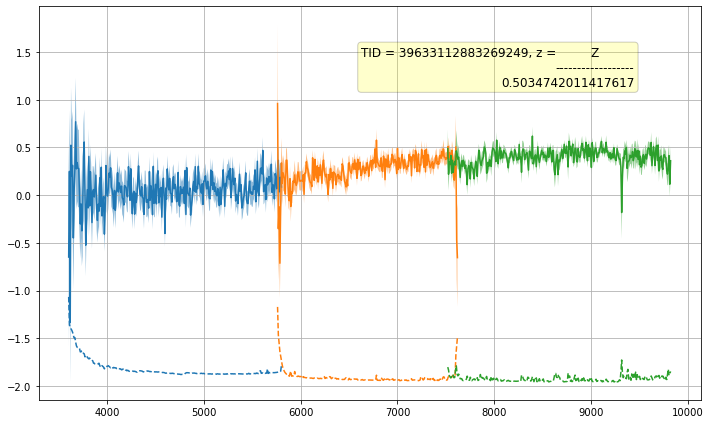

TARGETID=39633112887459874
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887459874         0        524 ... 60256.45965609 60256.45965609


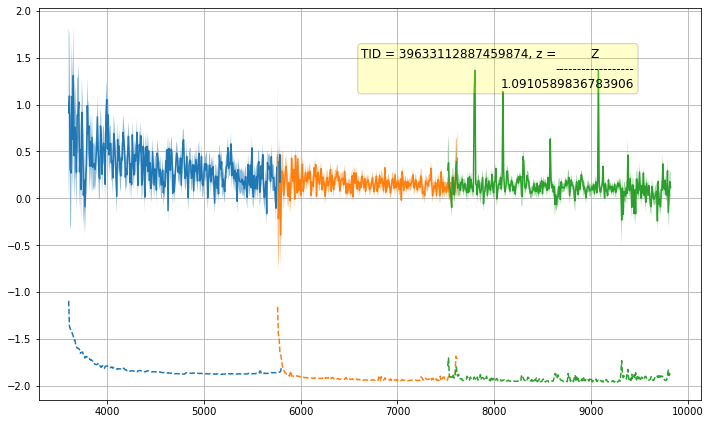

TARGETID=39633112887460000
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887460000         0        433 ... 60256.45965609 60256.45965609


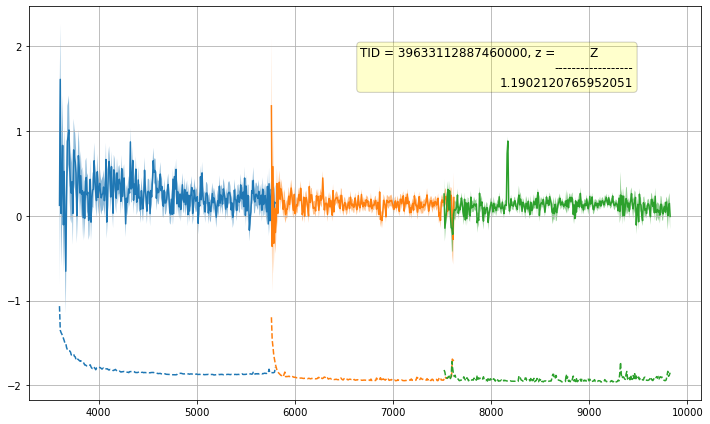

TARGETID=39633112887460006
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887460006         0        455 ... 60256.45965609 60256.45965609


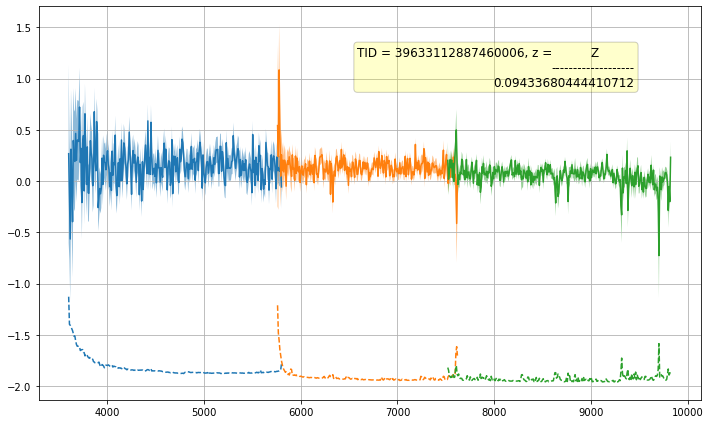

TARGETID=39633112887460189
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887460189         0        494 ... 60256.45965609 60256.45965609


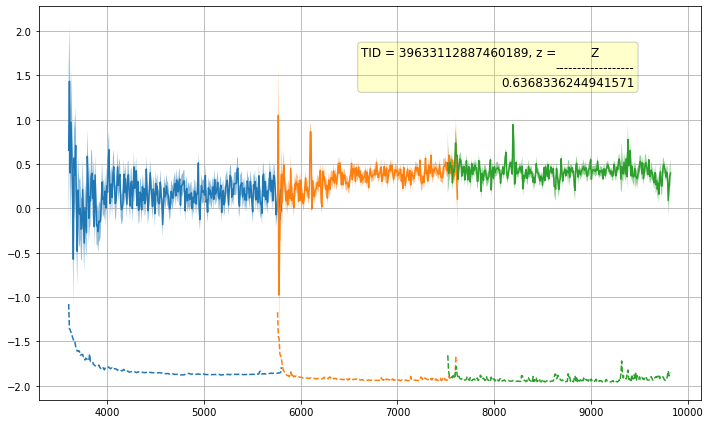

TARGETID=39633112887460420
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887460420         0        475 ... 60256.45965609 60256.45965609


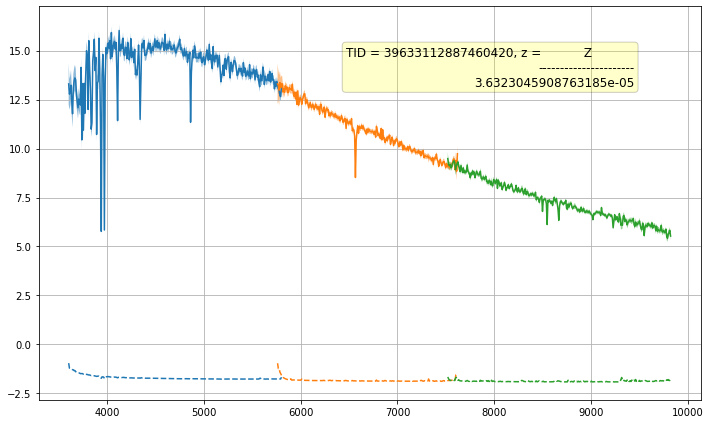

TARGETID=39633112887460546
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887460546         0        510 ... 60256.45965609 60256.45965609


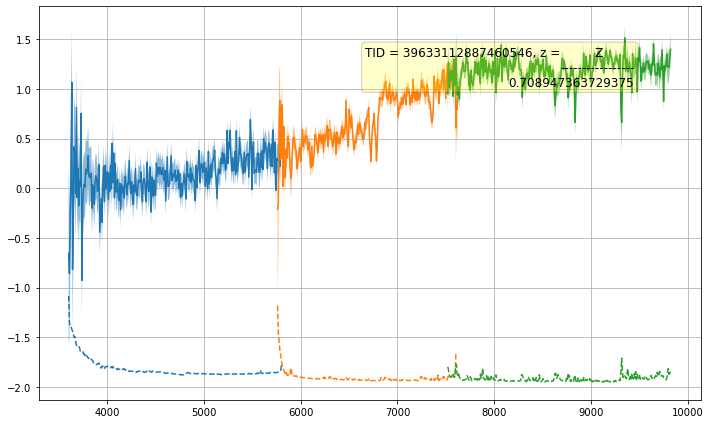

TARGETID=39633112887460668
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887460668         0        523 ... 60256.45965609 60256.45965609


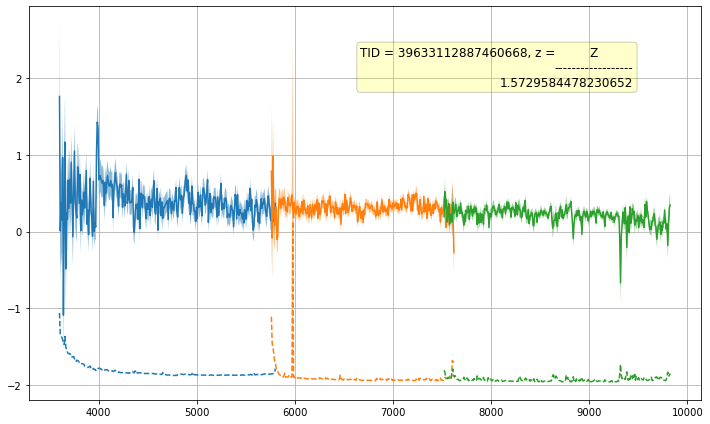

TARGETID=39633112887460712
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887460712         0        454 ... 60256.45965609 60256.45965609


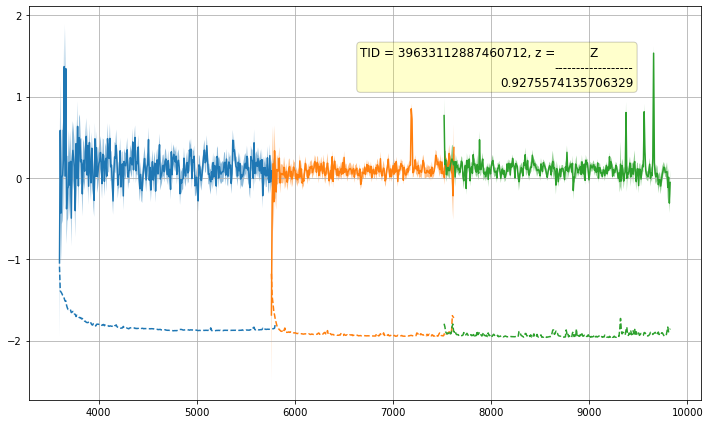

TARGETID=39633112887460835
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887460835         0        493 ... 60256.45965609 60256.45965609


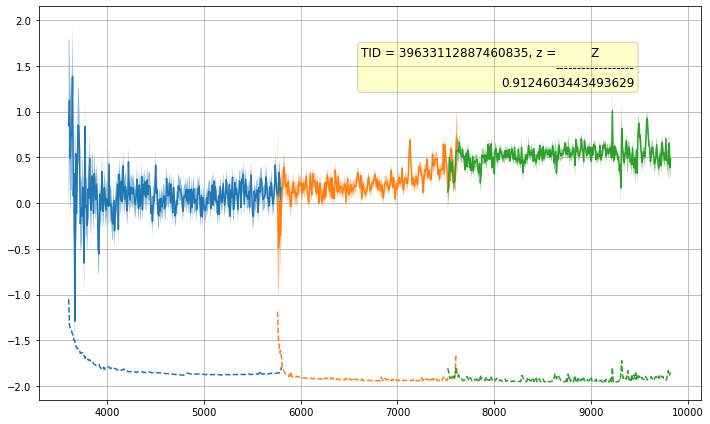

TARGETID=39633112887460961
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887460961         0        509 ... 60256.45965609 60256.45965609


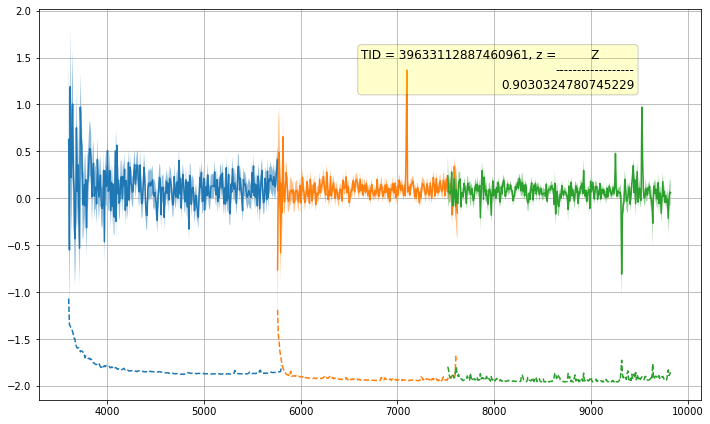

TARGETID=39633112887461038
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887461038         0        474 ... 60256.45965609 60256.45965609


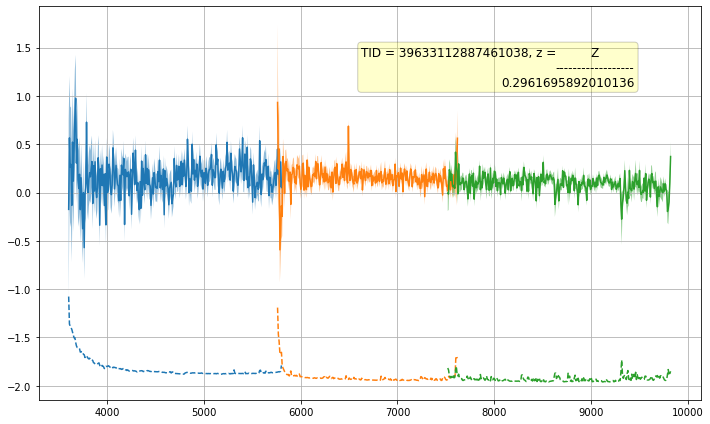

TARGETID=39633112887461056
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887461056         0        431 ... 60256.45965609 60256.45965609


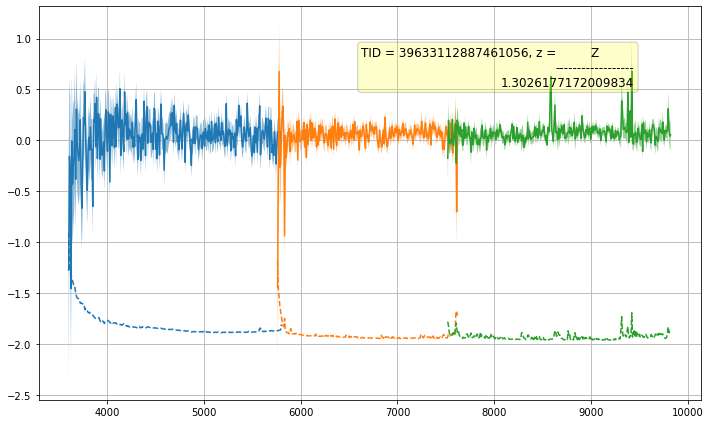

TARGETID=39633112887461145
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887461145         0        522 ... 60256.45965609 60256.45965609


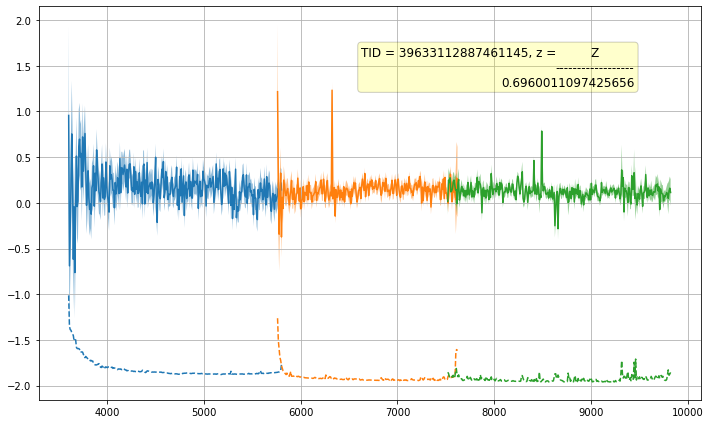

TARGETID=39633112887461299
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887461299         0        508 ... 60256.45965609 60256.45965609


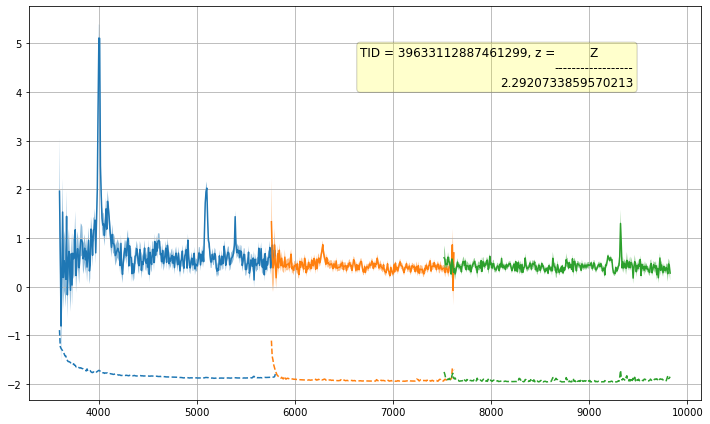

TARGETID=39633112887461368
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887461368         0        492 ... 60256.45965609 60256.45965609


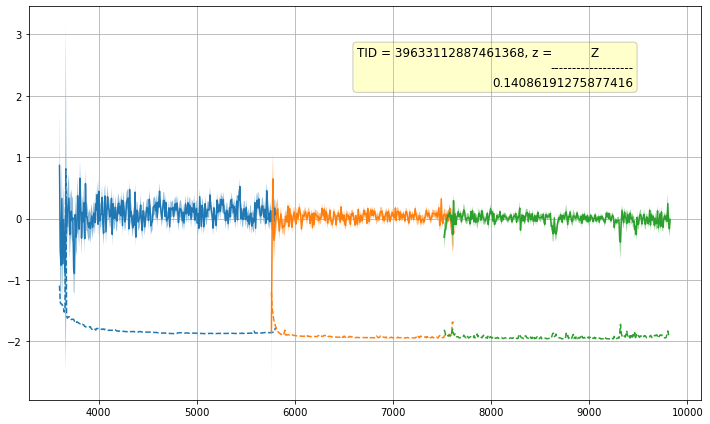

TARGETID=39633112887461527
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887461527         0        453 ... 60256.45965609 60256.45965609


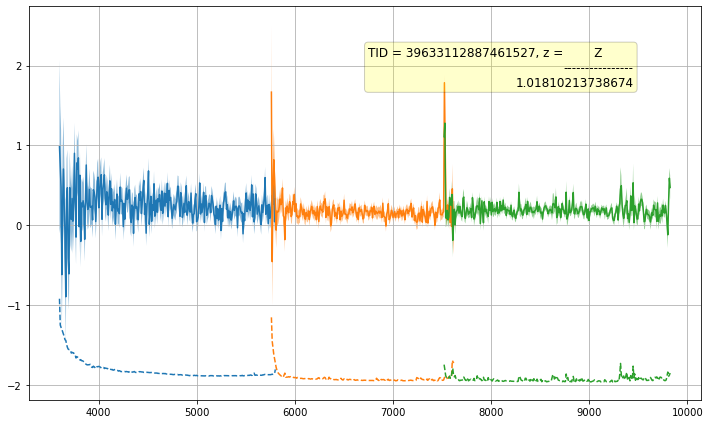

TARGETID=39633112887461567
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887461567         0        521 ... 60256.45965609 60256.45965609


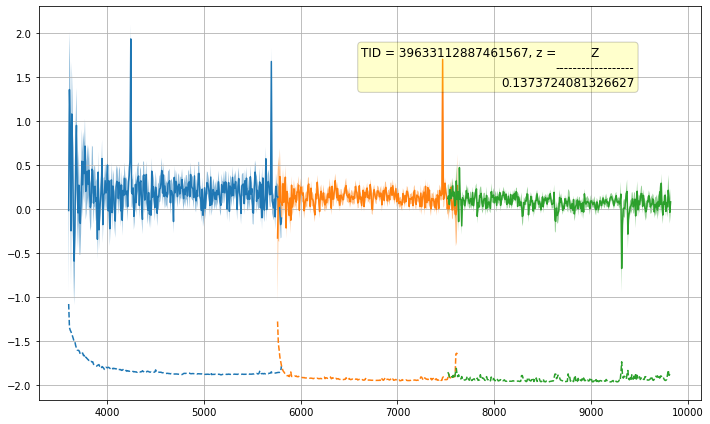

TARGETID=39633112887461881
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887461881         0        491 ... 60256.45965609 60256.45965609


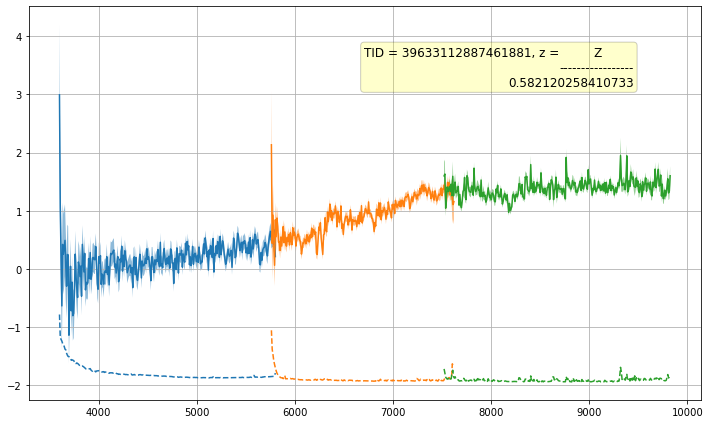

TARGETID=39633112887462008
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887462008         0        507 ... 60256.45965609 60256.45965609


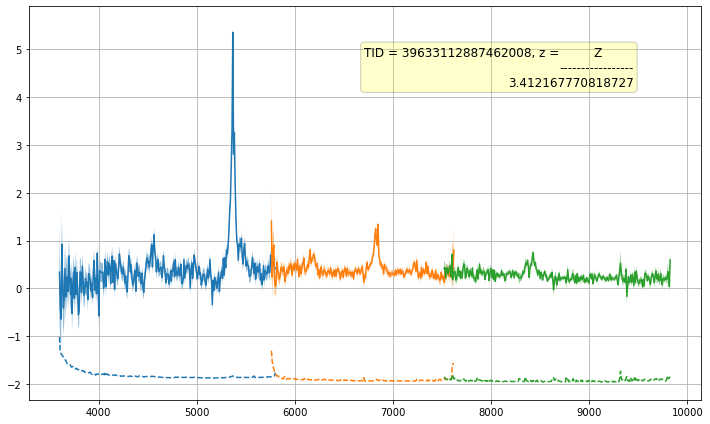

TARGETID=39633112887462016
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887462016         0        473 ... 60256.45965609 60256.45965609


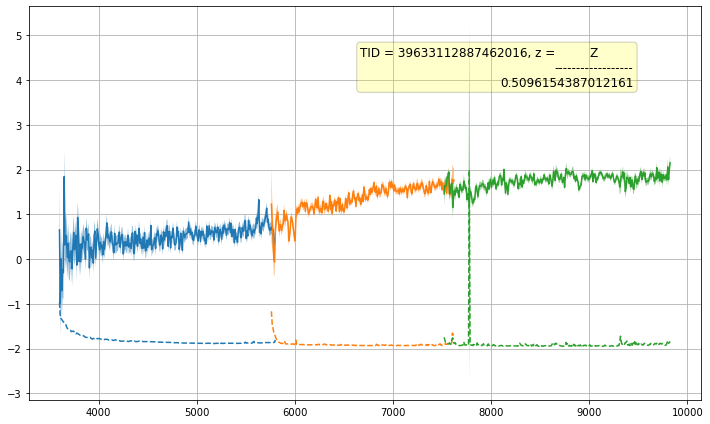

TARGETID=39633112887462162
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887462162         0        520 ... 60256.45965609 60256.45965609


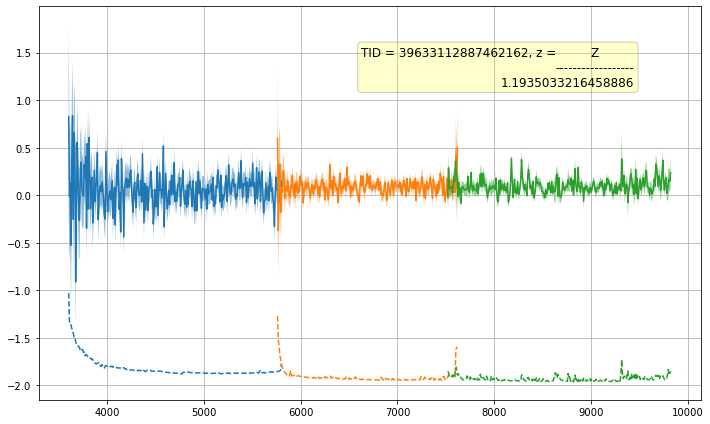

TARGETID=39633112887462246
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887462246         0        452 ... 60256.45965609 60256.45965609


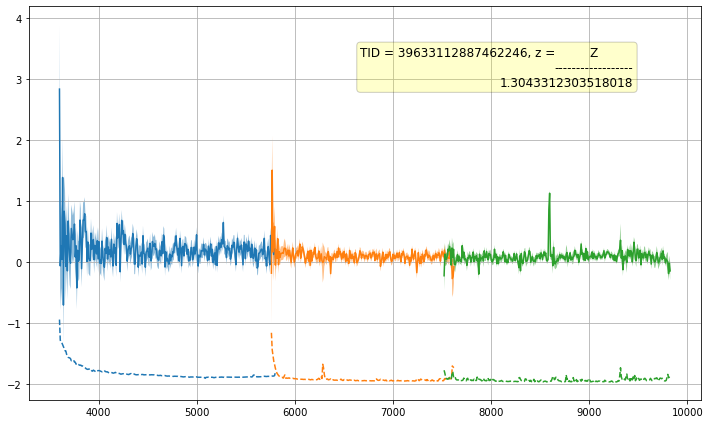

TARGETID=39633112887462279
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887462279         0        430 ... 60256.45965609 60256.45965609


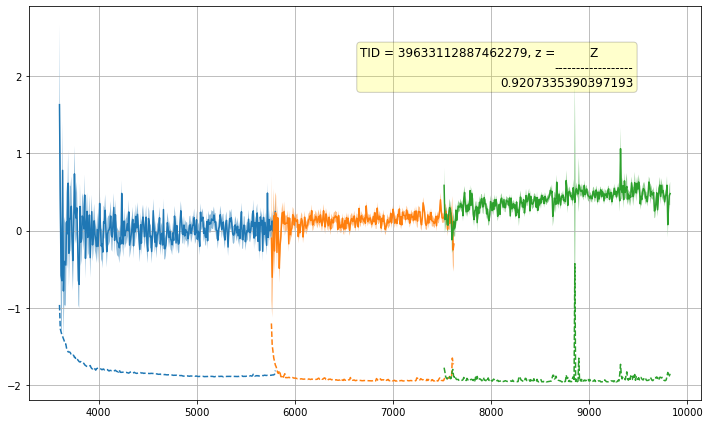

TARGETID=39633112887462486
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887462486         0        490 ... 60256.45965609 60256.45965609


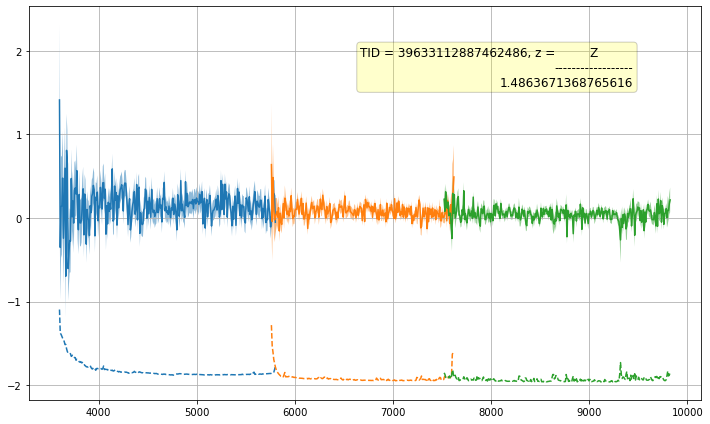

TARGETID=39633112887462606
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887462606         0        429 ... 60256.45965609 60256.45965609


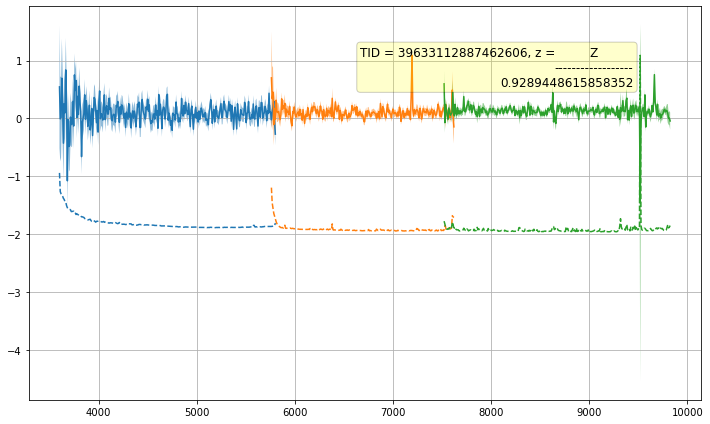

TARGETID=39633112887462936
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887462936         0        406 ... 60256.45965609 60256.45965609


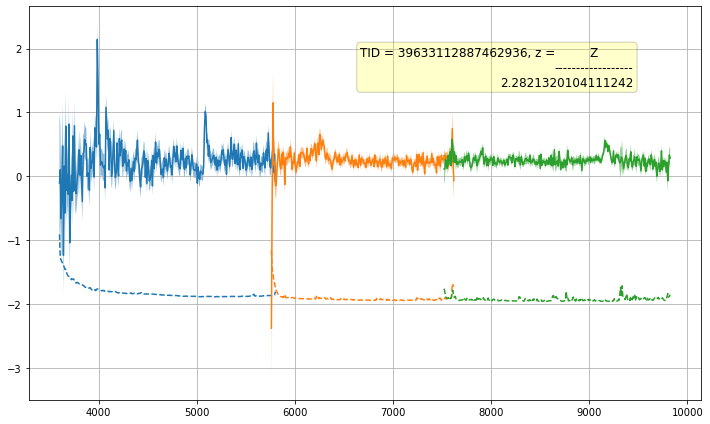

TARGETID=39633112887463050
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887463050         0        471 ... 60256.45965609 60256.45965609


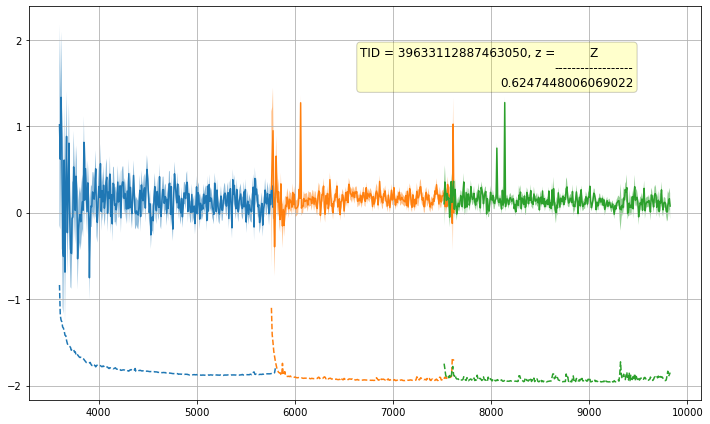

TARGETID=39633112887463100
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887463100         0        428 ... 60256.45965609 60256.45965609


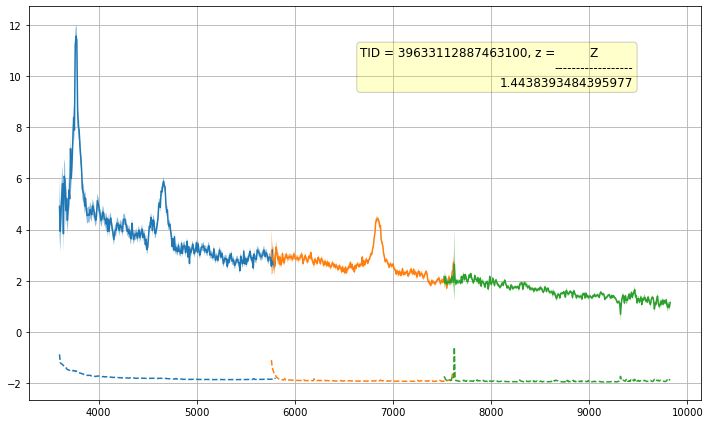

TARGETID=39633112887463294
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887463294         0        489 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


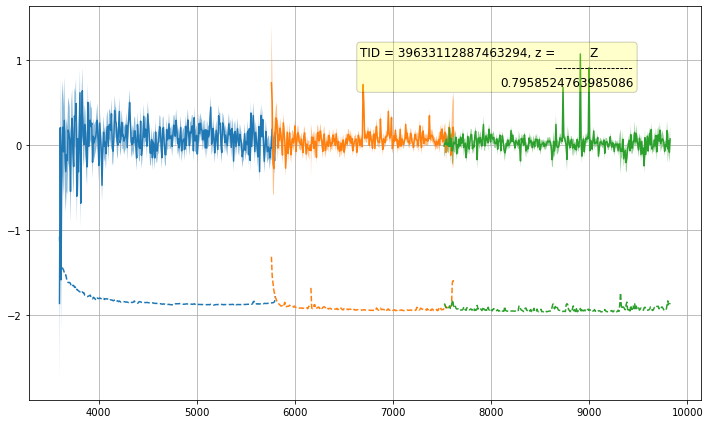

TARGETID=39633112887463312
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887463312         0        384 ... 60256.45965609 60256.45965609


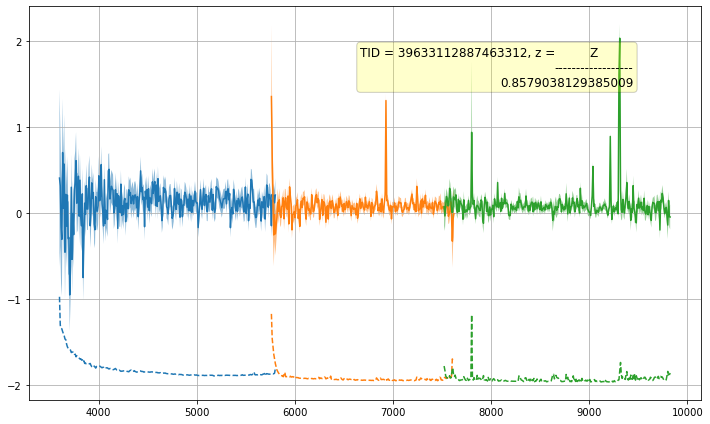

TARGETID=39633112887463461
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887463461         0        505 ... 60256.45965609 60256.45965609


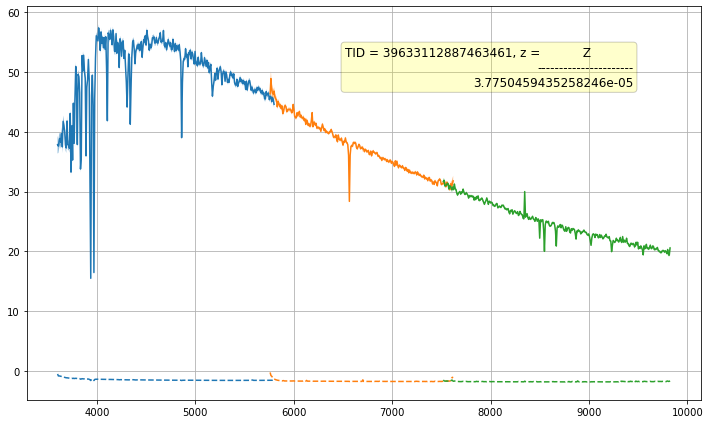

TARGETID=39633112887463949
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887463949         0        470 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


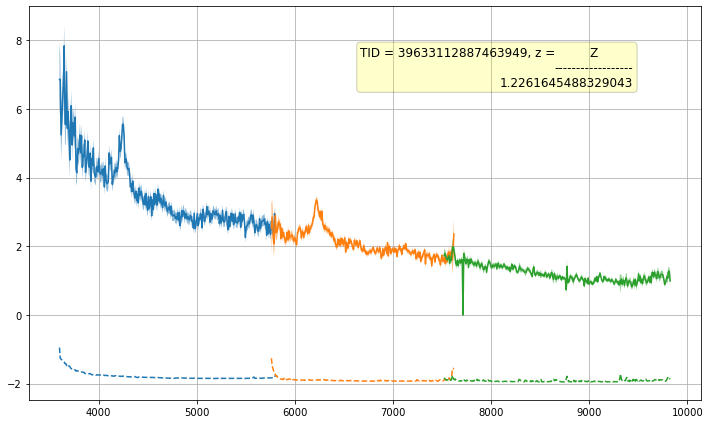

TARGETID=39633112887463969
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112887463969         0        427 ... 60256.45965609 60256.45965609


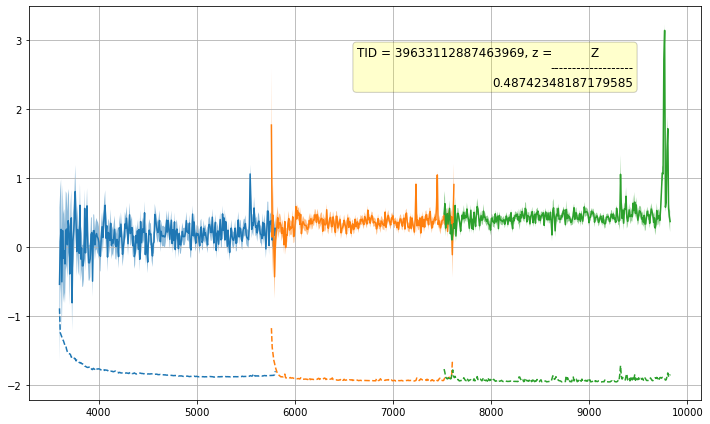

TARGETID=39633112891654237
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891654237         0        405 ... 60256.45965609 60256.45965609


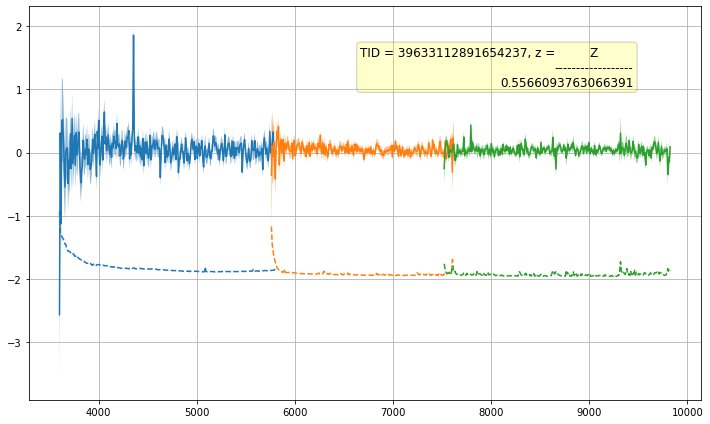

TARGETID=39633112891654291
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891654291         0        488 ... 60256.45965609 60256.45965609


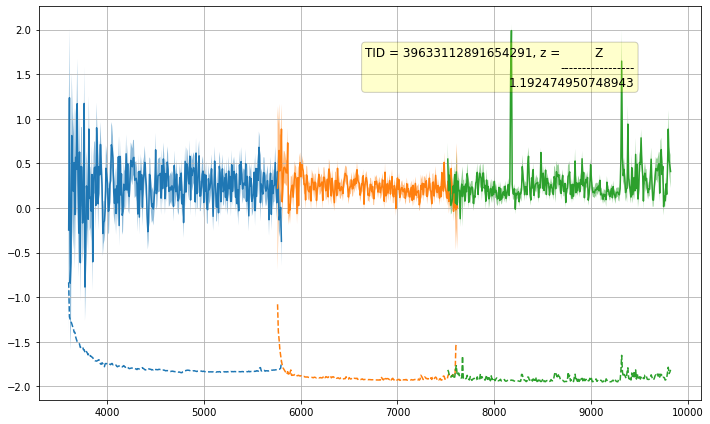

TARGETID=39633112891654343
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891654343         0        449 ... 60256.45965609 60256.45965609


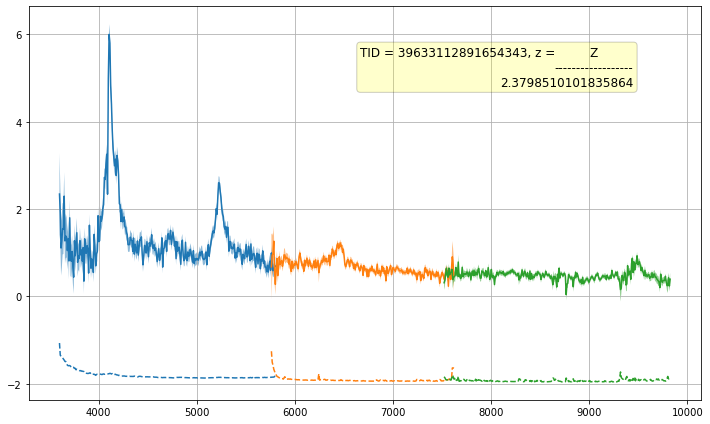

TARGETID=39633112891654375
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891654375         0        469 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


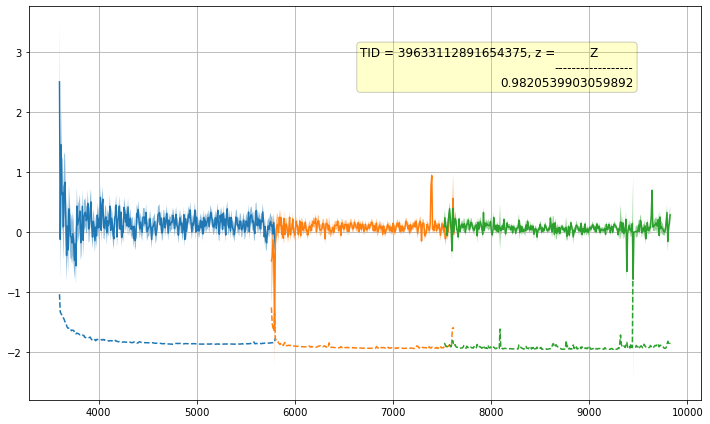

TARGETID=39633112891654687
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891654687         0        404 ... 60256.45965609 60256.45965609


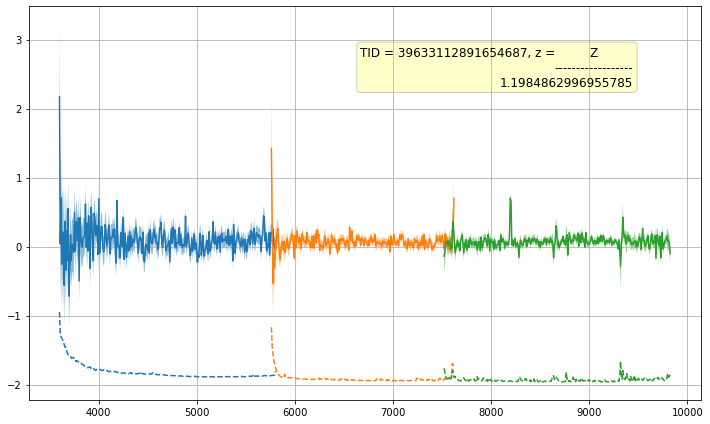

TARGETID=39633112891654899
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891654899         0        426 ... 60256.45965609 60256.45965609


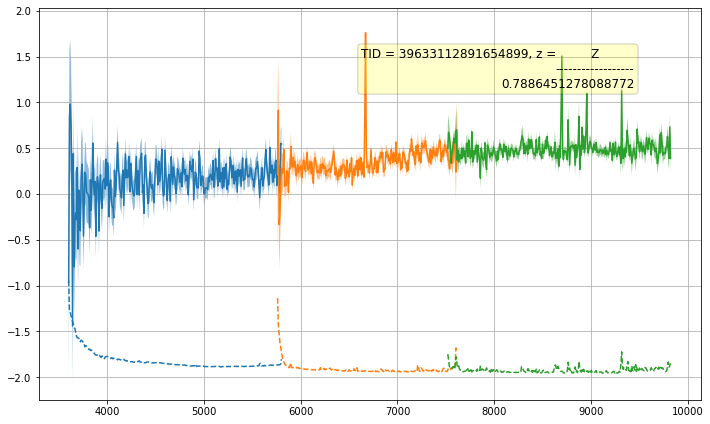

TARGETID=39633112891654970
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891654970         0        487 ... 60256.45965609 60256.45965609


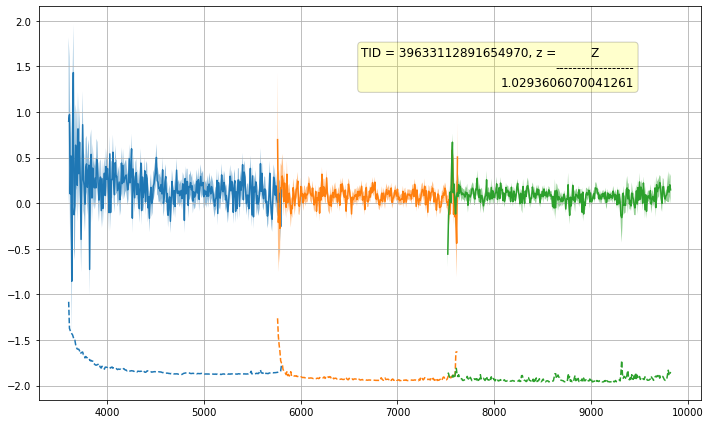

TARGETID=39633112891655137
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891655137         0        448 ... 60256.45965609 60256.45965609


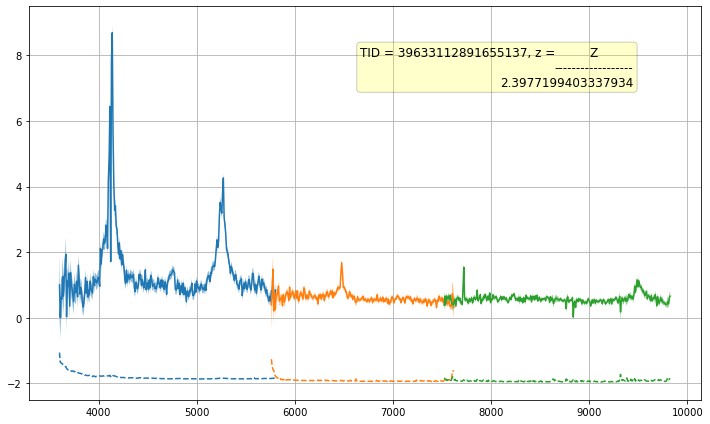

TARGETID=39633112891655461
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891655461         0        486 ... 60256.45965609 60256.45965609


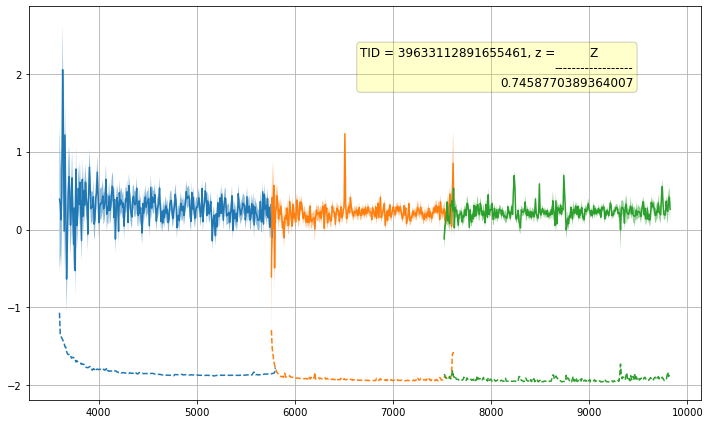

TARGETID=39633112891655471
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891655471         0        403 ... 60256.45965609 60256.45965609


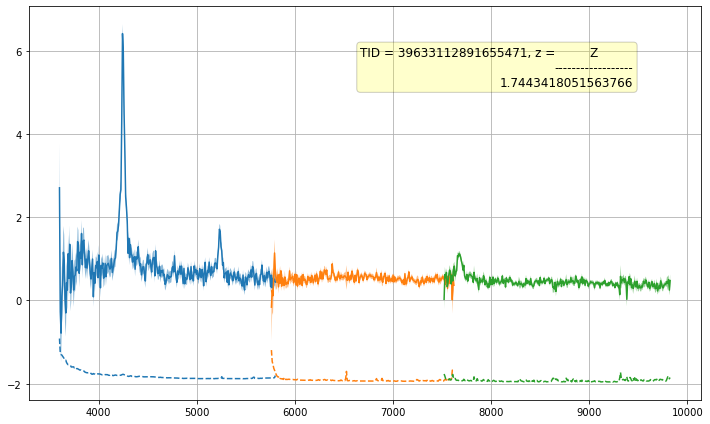

TARGETID=39633112891655488
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891655488         0        503 ... 60256.45965609 60256.45965609


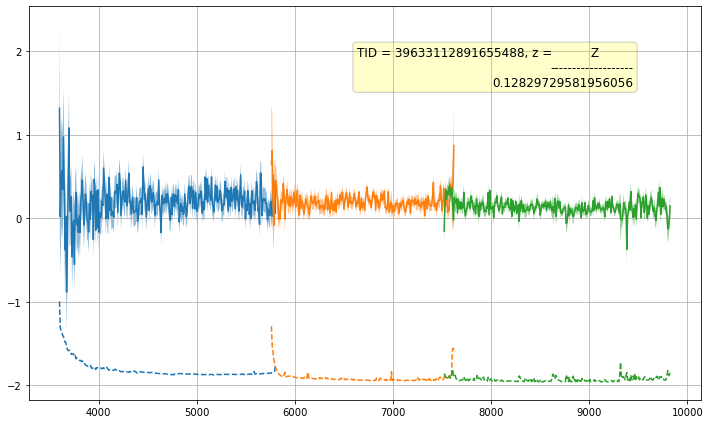

TARGETID=39633112891655593
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891655593         0        425 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


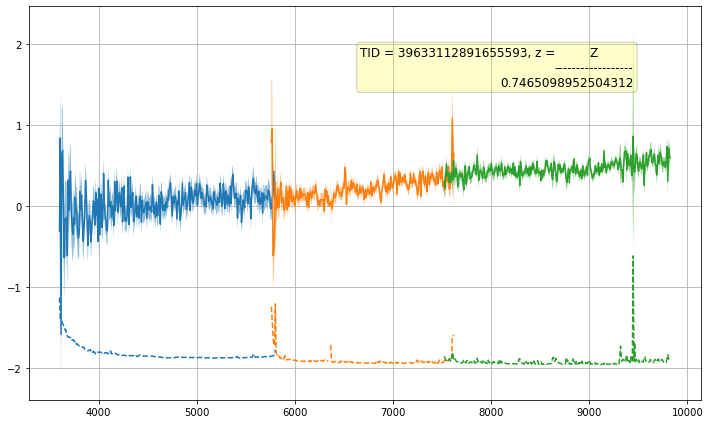

TARGETID=39633112891655614
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891655614         0        382 ... 60256.45965609 60256.45965609


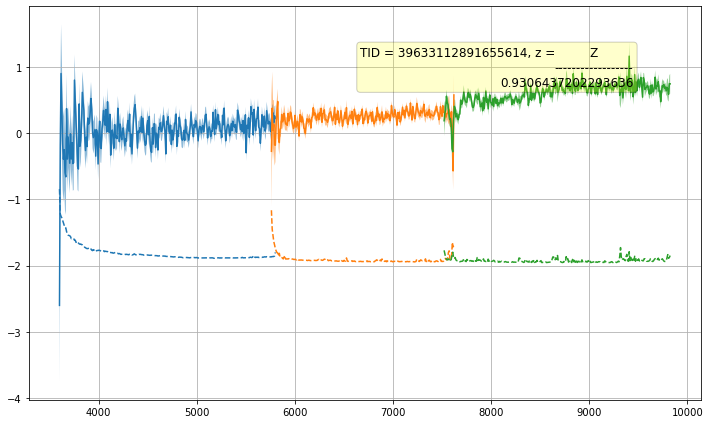

TARGETID=39633112891655865
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891655865         0        402 ... 60256.45965609 60256.45965609


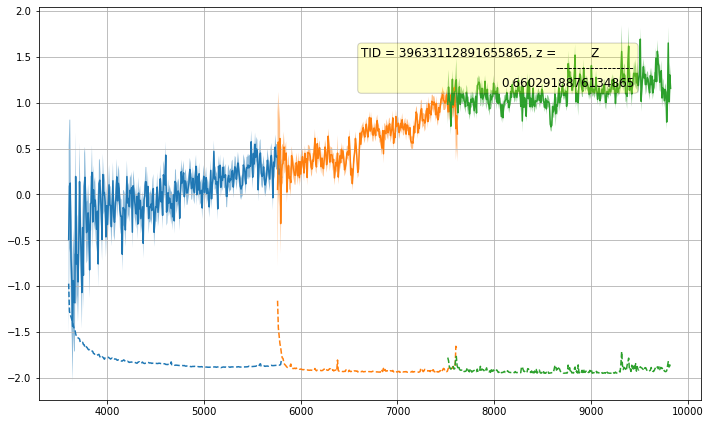

TARGETID=39633112891655955
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891655955         0        467 ... 60256.45965609 60256.45965609


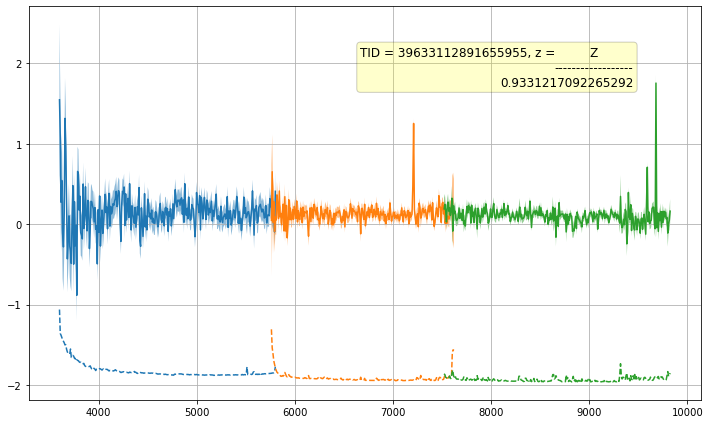

TARGETID=39633112891655981
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891655981         0        381 ... 60256.45965609 60256.45965609


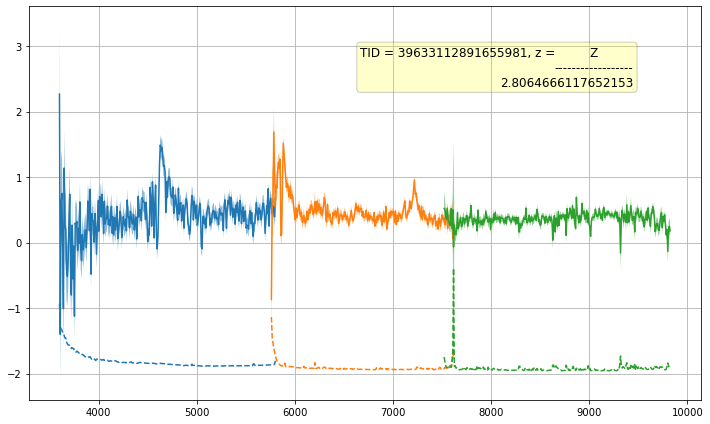

TARGETID=39633112891656552
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891656552         0        485 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


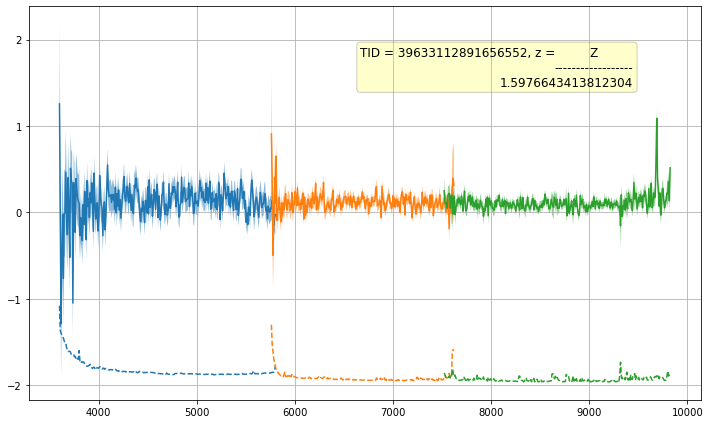

TARGETID=39633112891656604
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891656604         0        401 ... 60256.45965609 60256.45965609


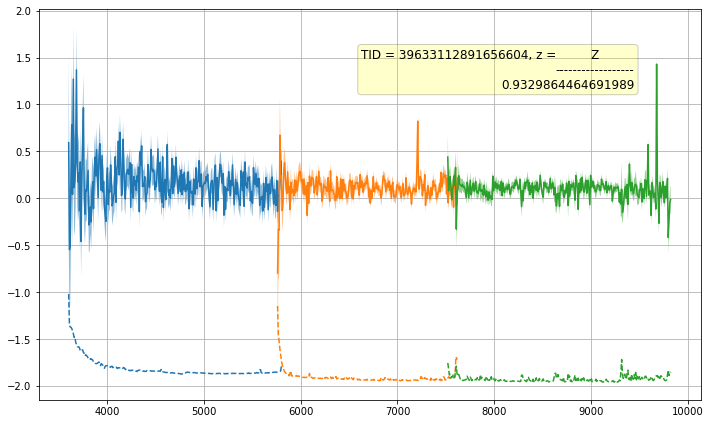

TARGETID=39633112891657115
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891657115         0        484 ... 60256.45965609 60256.45965609


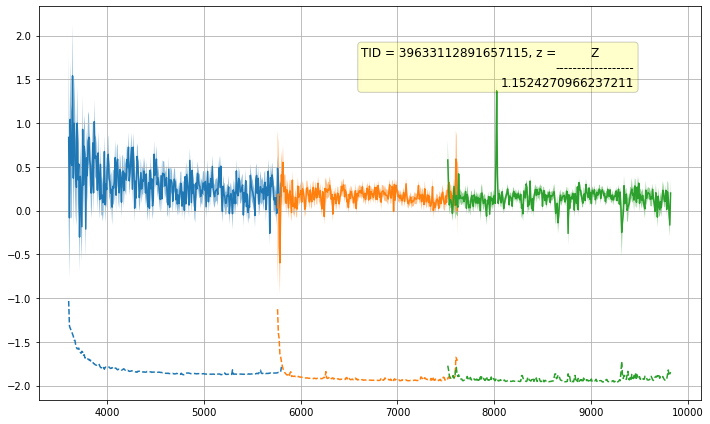

TARGETID=39633112891657274
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891657274         0        423 ... 60256.45965609 60256.45965609


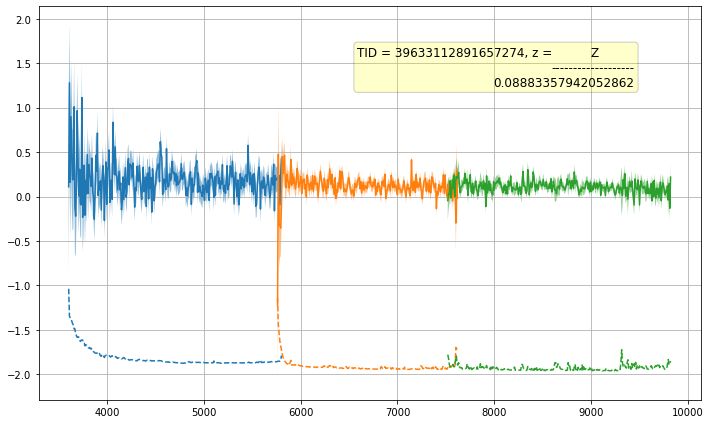

TARGETID=39633112891657529
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891657529         0        465 ... 60256.45965609 60256.45965609


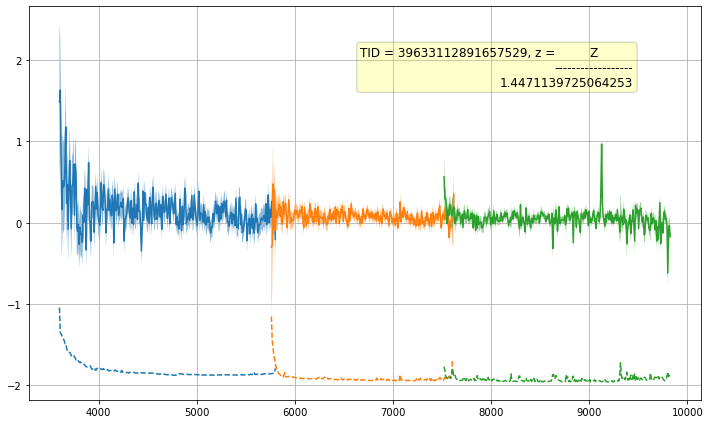

TARGETID=39633112891657596
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891657596         0        422 ... 60256.45965609 60256.45965609


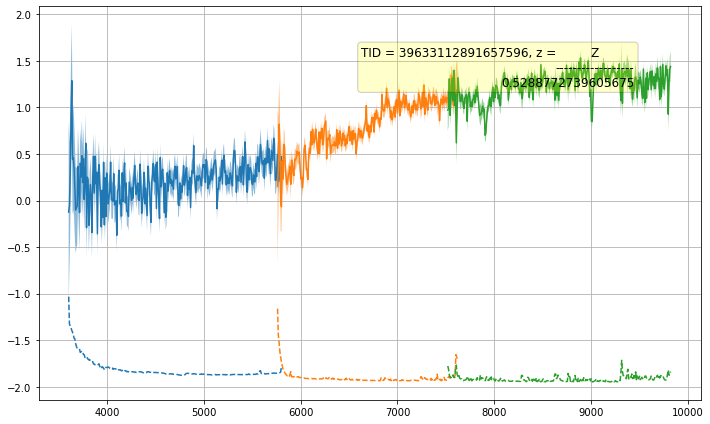

TARGETID=39633112891657630
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891657630         0        483 ... 60256.45965609 60256.45965609


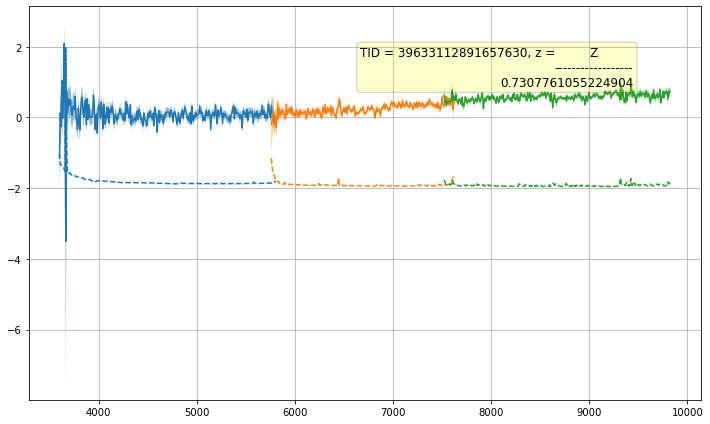

TARGETID=39633112891657799
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891657799         0        444 ... 60256.45965609 60256.45965609


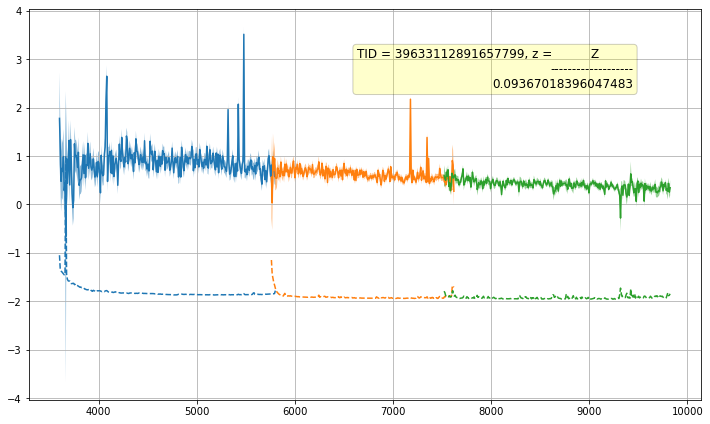

TARGETID=39633112891657868
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891657868         0        464 ... 60256.45965609 60256.45965609


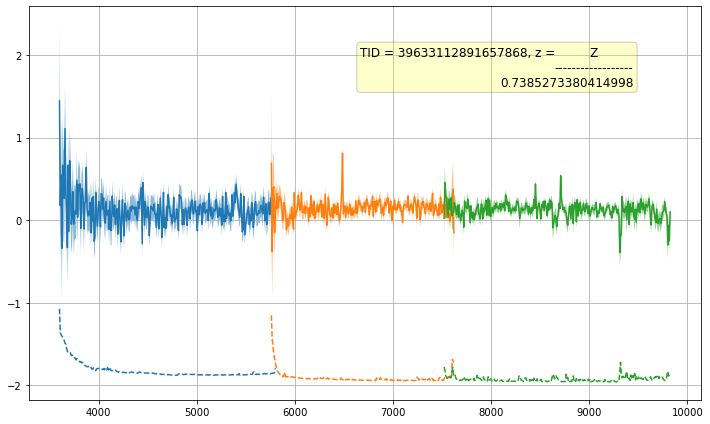

TARGETID=39633112891657939
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891657939         0        378 ... 60256.45965609 60256.45965609


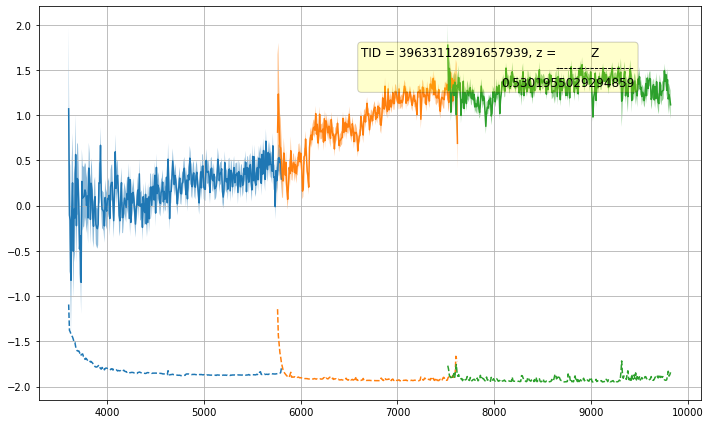

TARGETID=39633112891658000
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891658000         0        399 ... 60256.45965609 60256.45965609


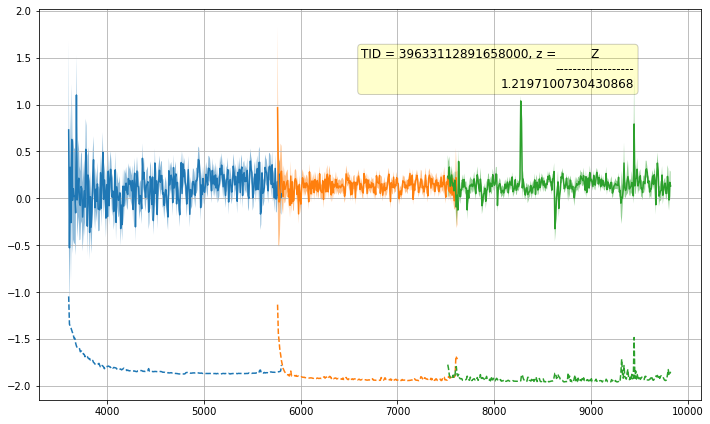

TARGETID=39633112891658165
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891658165         0        421 ... 60256.45965609 60256.45965609


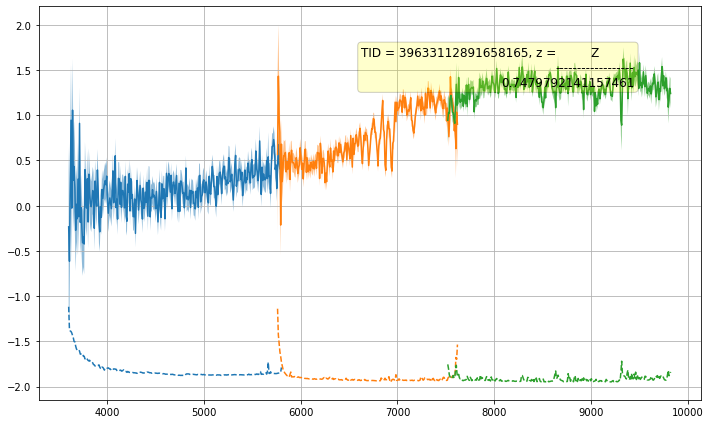

TARGETID=39633112891658179
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112891658179         0        443 ... 60256.45965609 60256.45965609


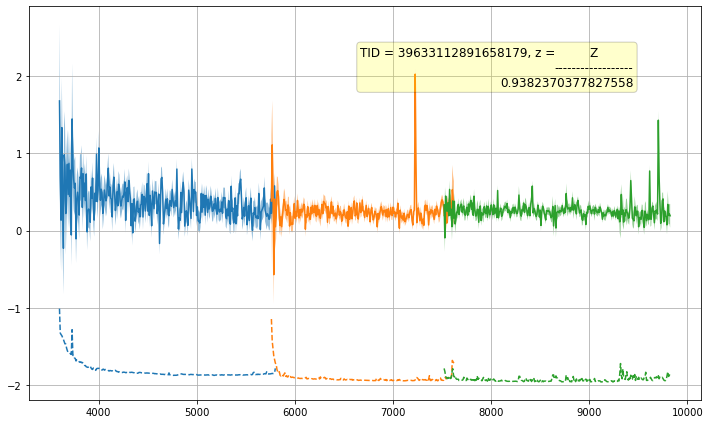

TARGETID=39633112895848507
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895848507         0        356 ... 60256.45965609 60256.45965609


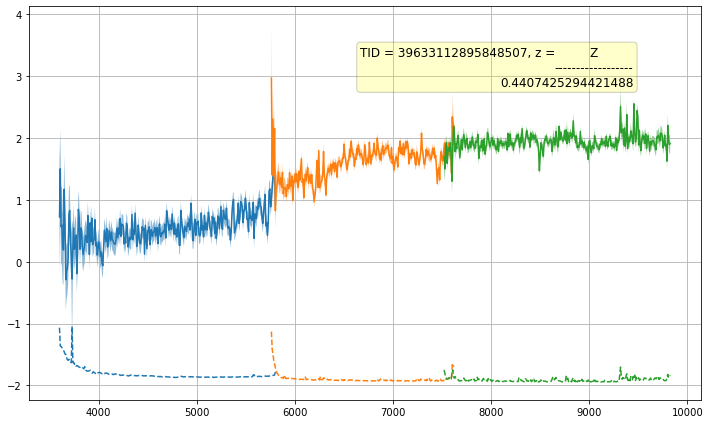

TARGETID=39633112895848581
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895848581         0        377 ... 60256.45965609 60256.45965609


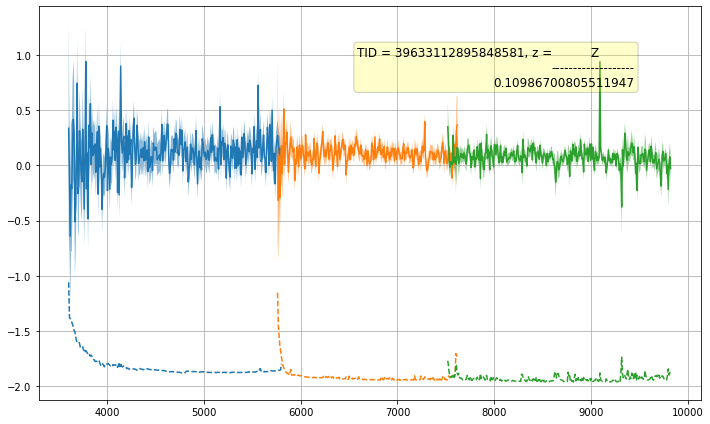

TARGETID=39633112895848748
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895848748         0        463 ... 60256.45965609 60256.45965609


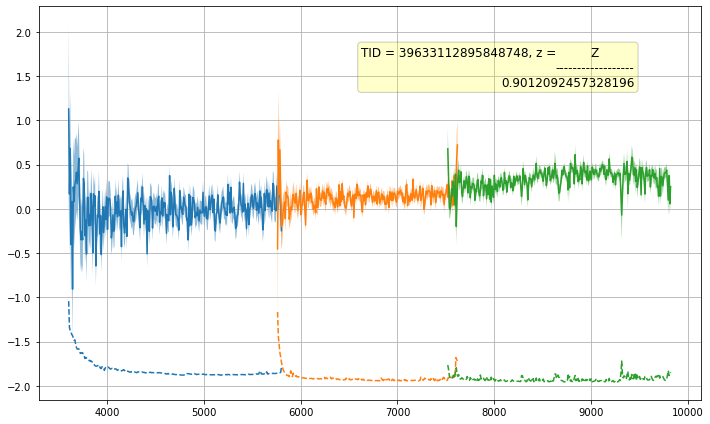

TARGETID=39633112895849014
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895849014         0        355 ... 60256.45965609 60256.45965609


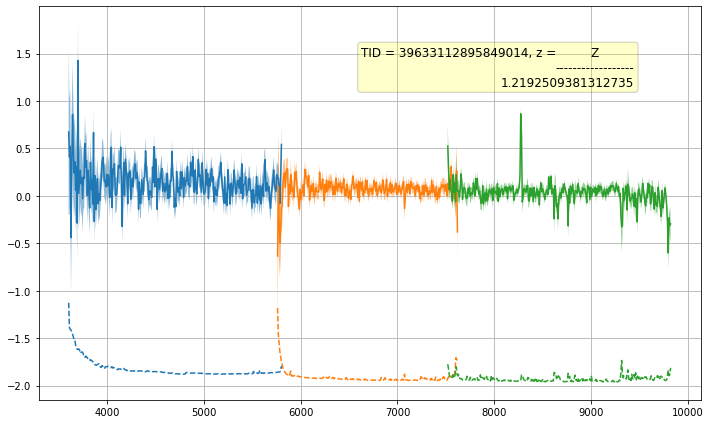

TARGETID=39633112895849245
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895849245         0        376 ... 60256.45965609 60256.45965609


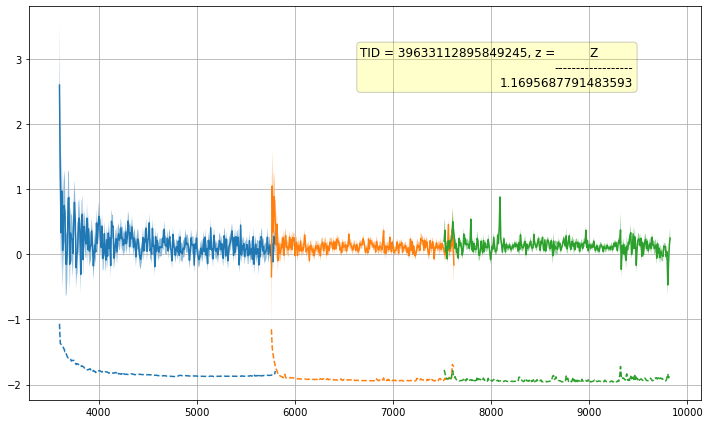

TARGETID=39633112895849290
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895849290         0        442 ... 60256.45965609 60256.45965609


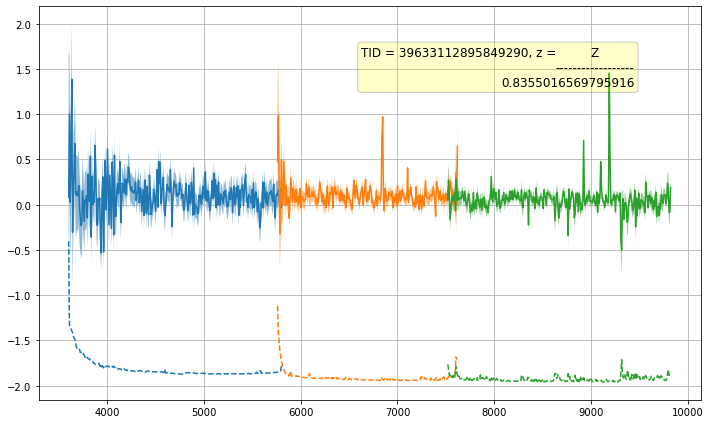

TARGETID=39633112895849591
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895849591         0        462 ... 60256.45965609 60256.45965609


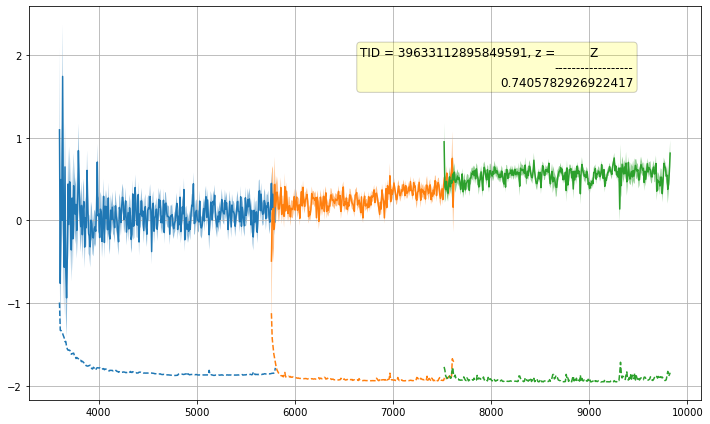

TARGETID=39633112895849600
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895849600         0        354 ... 60256.45965609 60256.45965609


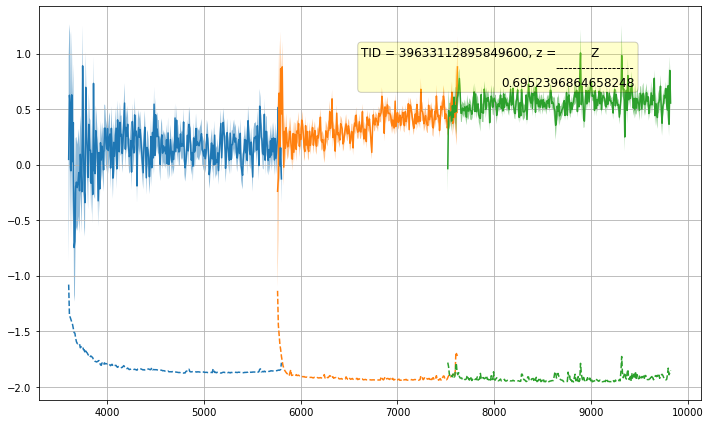

TARGETID=39633112895849621
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895849621         0        397 ... 60256.45965609 60256.45965609


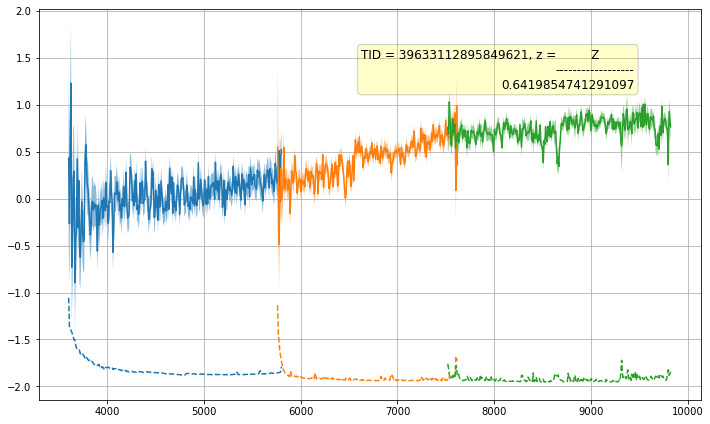

TARGETID=39633112895849662
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895849662         0        441 ... 60256.45965609 60256.45965609


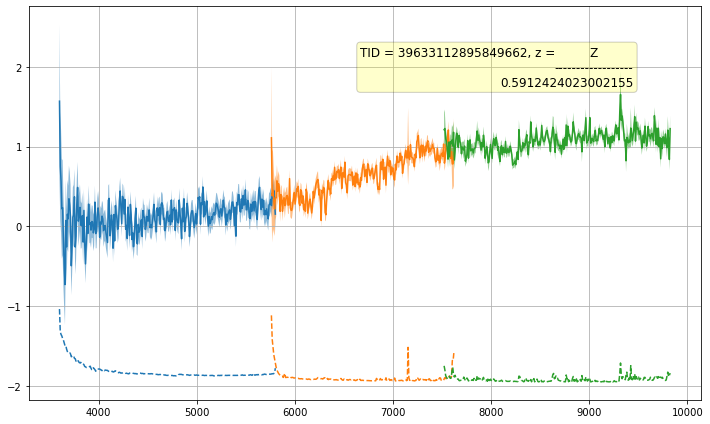

TARGETID=39633112895849725
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895849725         0        419 ... 60256.45965609 60256.45965609


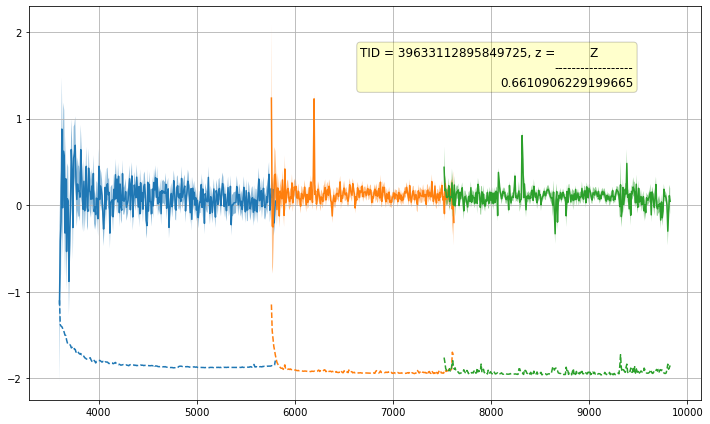

TARGETID=39633112895850026
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895850026         0        396 ... 60256.45965609 60256.45965609


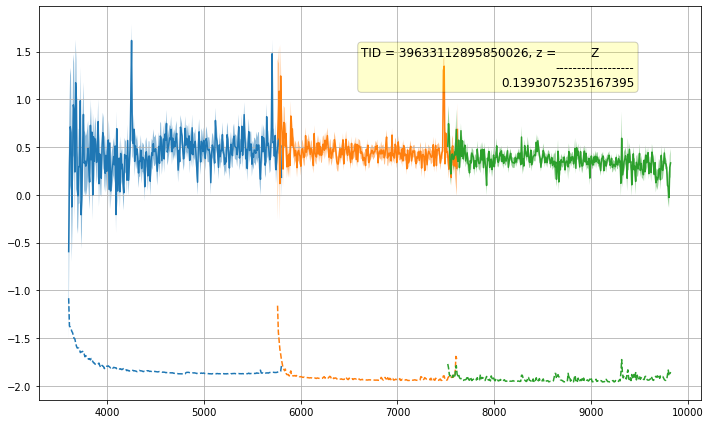

TARGETID=39633112895850200
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895850200         0        418 ... 60256.45965609 60256.45965609


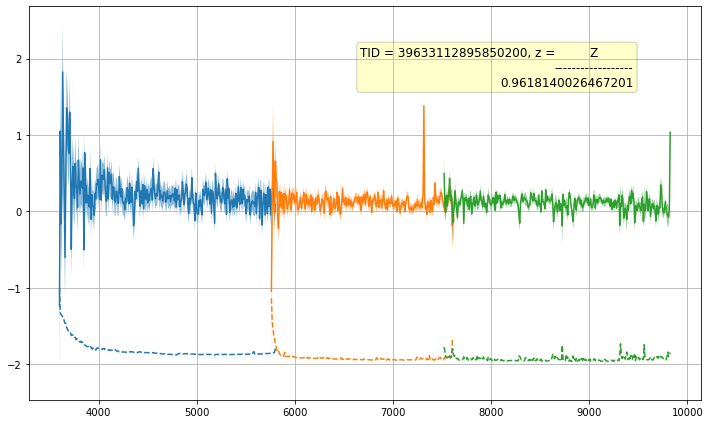

TARGETID=39633112895850381
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895850381         0        374 ... 60256.45965609 60256.45965609


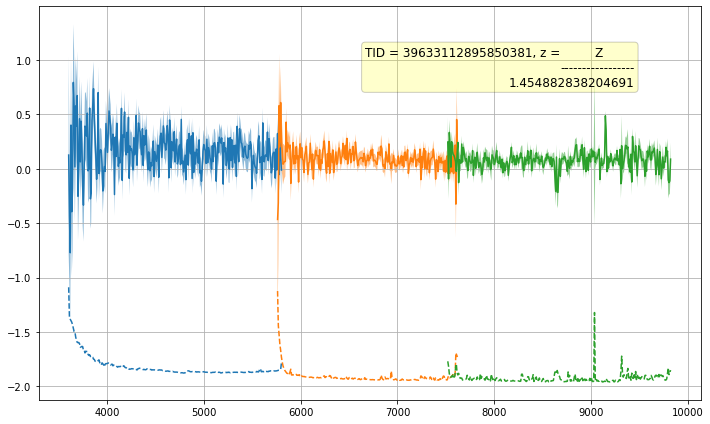

TARGETID=39633112895850427
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895850427         0        353 ... 60256.45965609 60256.45965609


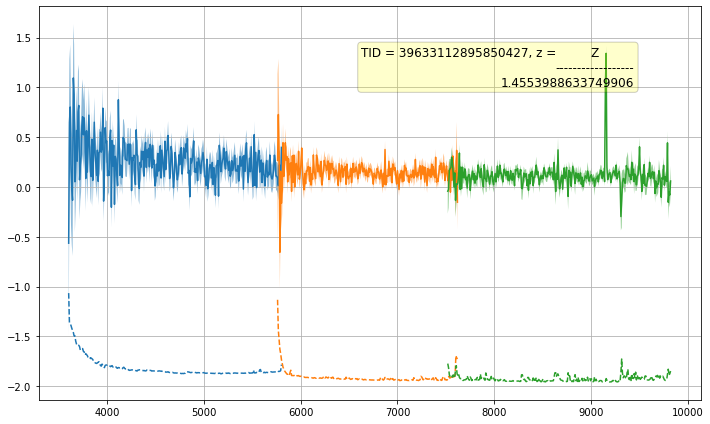

TARGETID=39633112895850589
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895850589         0        395 ... 60256.45965609 60256.45965609


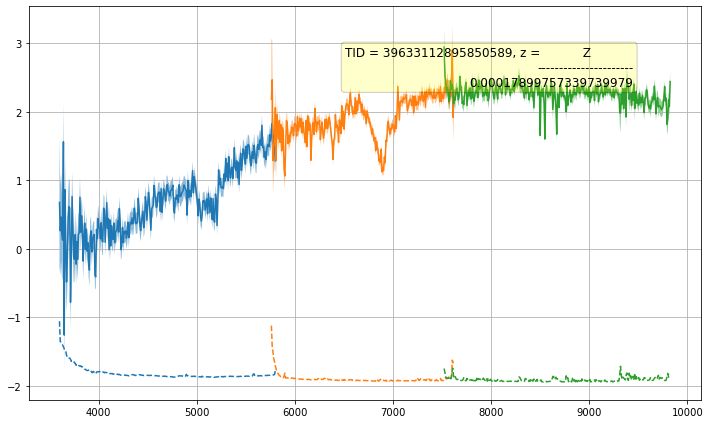

TARGETID=39633112895850726
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895850726         0        440 ... 60256.45965609 60256.45965609


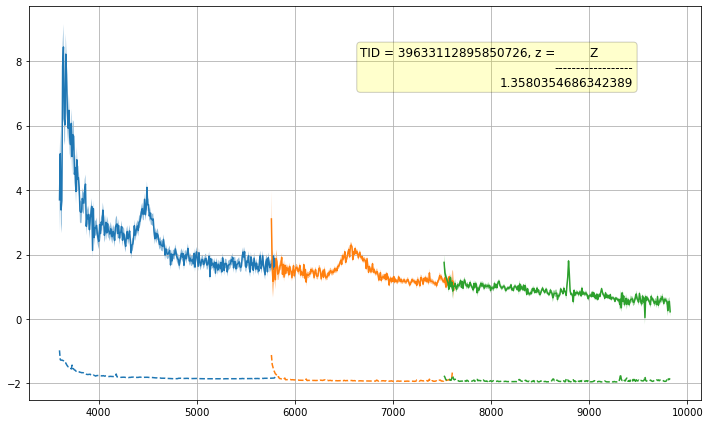

TARGETID=39633112895850984
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895850984         0        332 ... 60256.45965609 60256.45965609


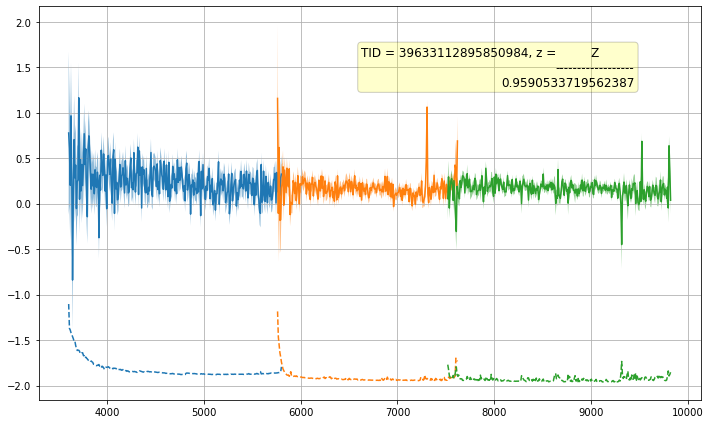

TARGETID=39633112895851071
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895851071         0        373 ... 60256.45965609 60256.45965609


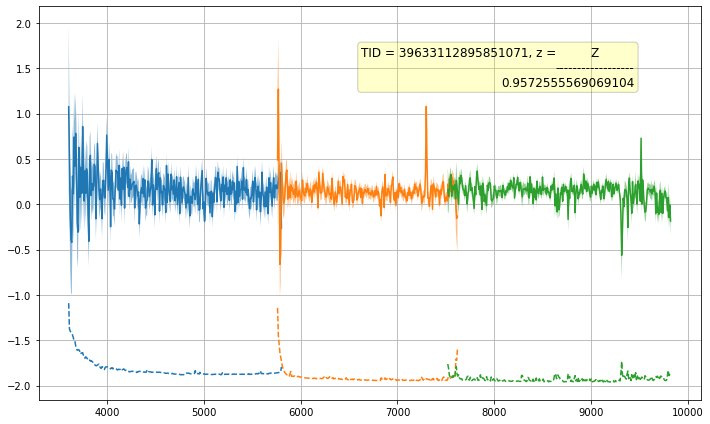

TARGETID=39633112895851117
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895851117         0        417 ... 60256.45965609 60256.45965609


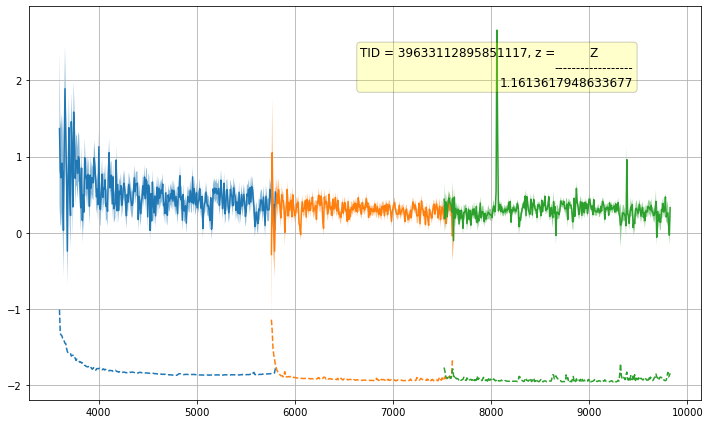

TARGETID=39633112895851119
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895851119         0        352 ... 60256.45965609 60256.45965609


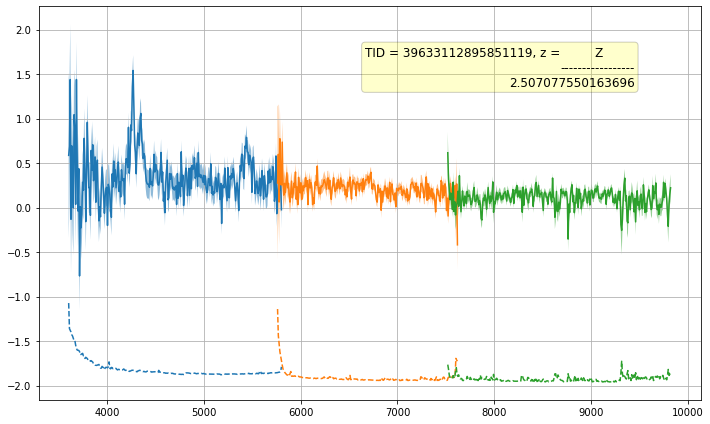

TARGETID=39633112895851386
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633112895851386         0        416 ... 60256.45965609 60256.45965609


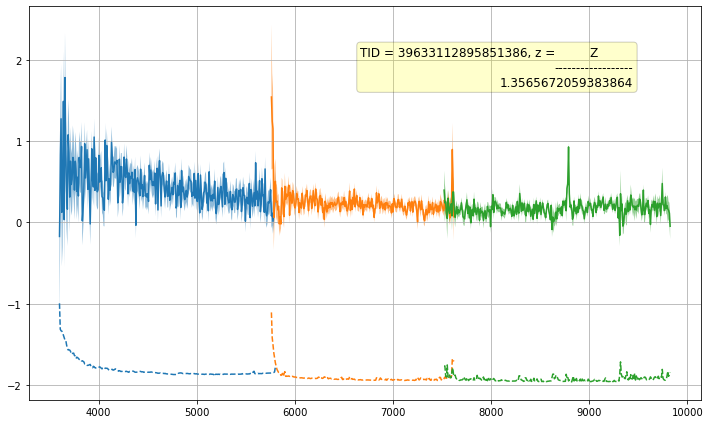

TARGETID=39633117379562335
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117379562335         0        372 ... 60256.45965609 60256.45965609


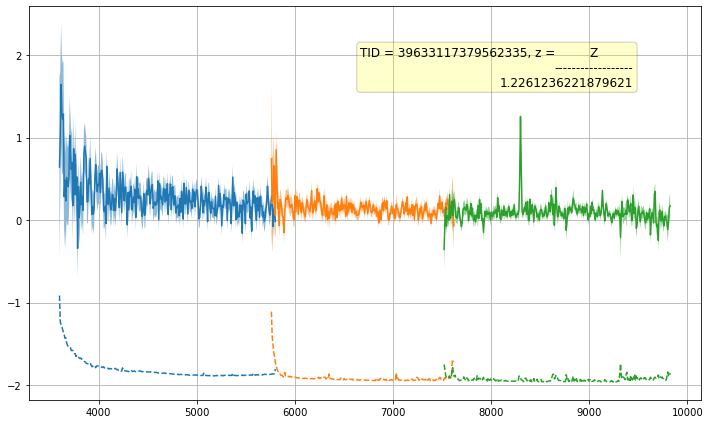

TARGETID=39633117379562626
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117379562626         0        393 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


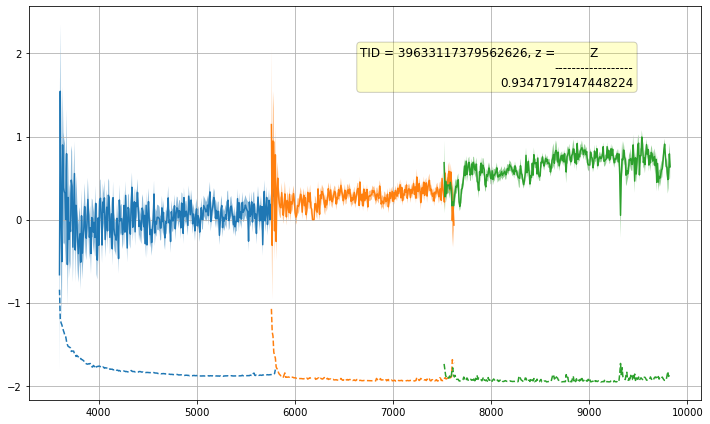

TARGETID=39633117383753792
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383753792         0        311 ... 60256.45965609 60256.45965609


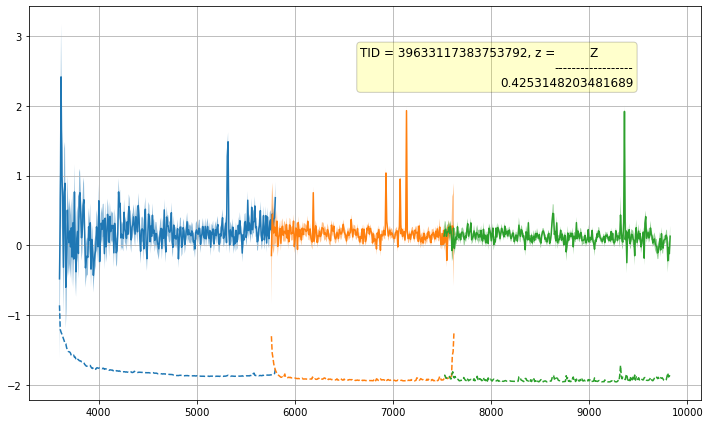

TARGETID=39633117383753894
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383753894         0        414 ... 60256.45965609 60256.45965609


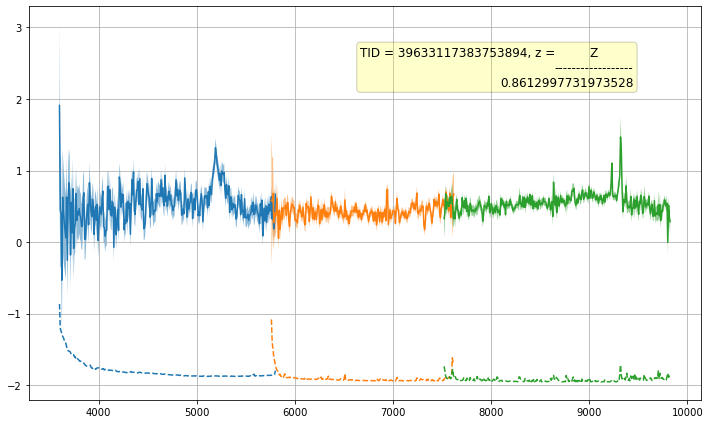

TARGETID=39633117383754002
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754002         0        330 ... 60256.45965609 60256.45965609


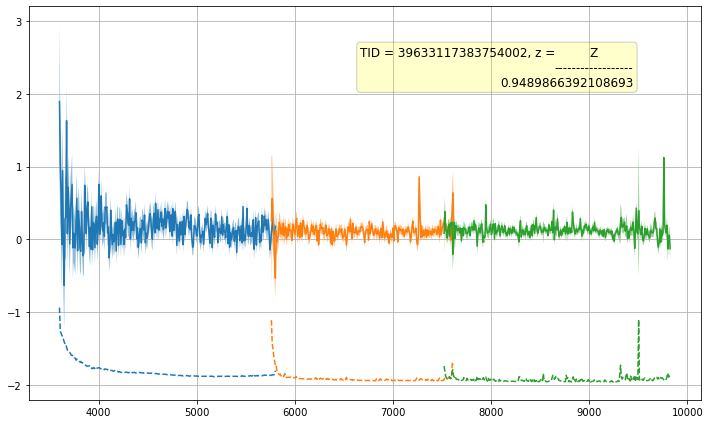

TARGETID=39633117383754154
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754154         0        292 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


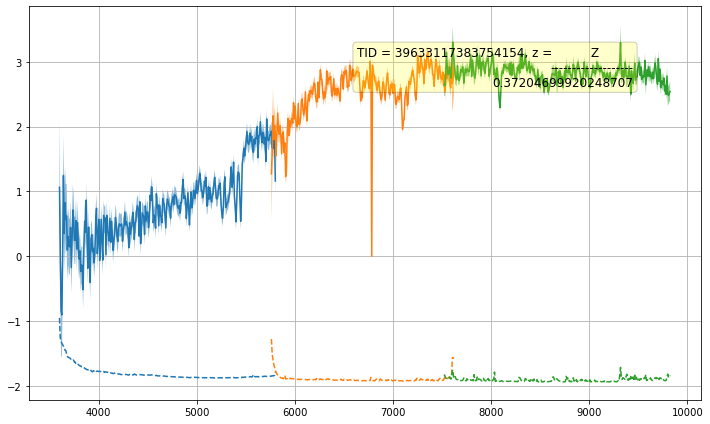

TARGETID=39633117383754355
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754355         0        392 ... 60256.45965609 60256.45965609


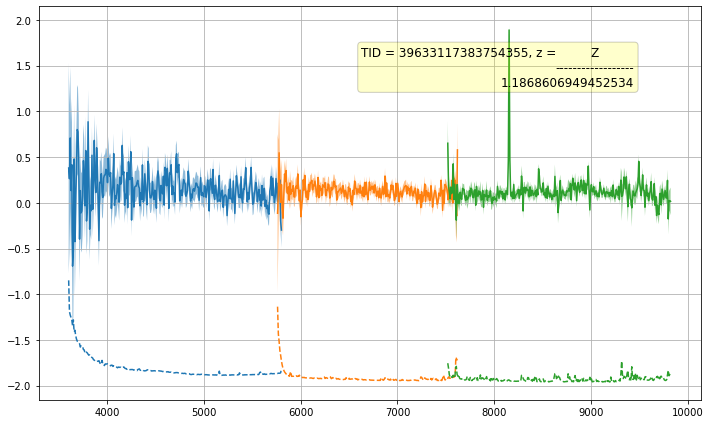

TARGETID=39633117383754493
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754493         0        435 ... 60256.45965609 60256.45965609


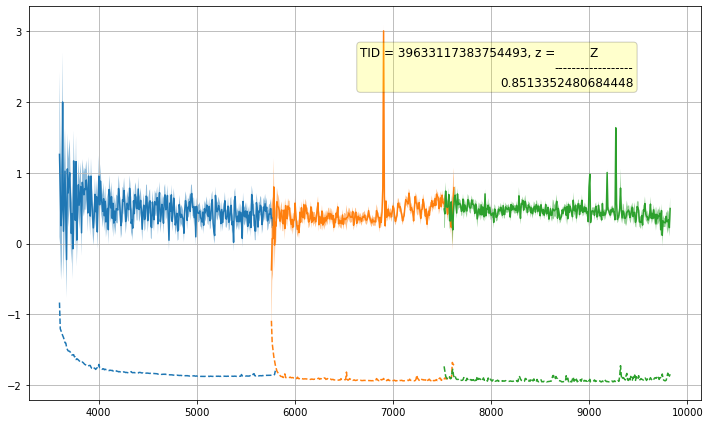

TARGETID=39633117383754605
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754605         0        370 ... 60256.45965609 60256.45965609


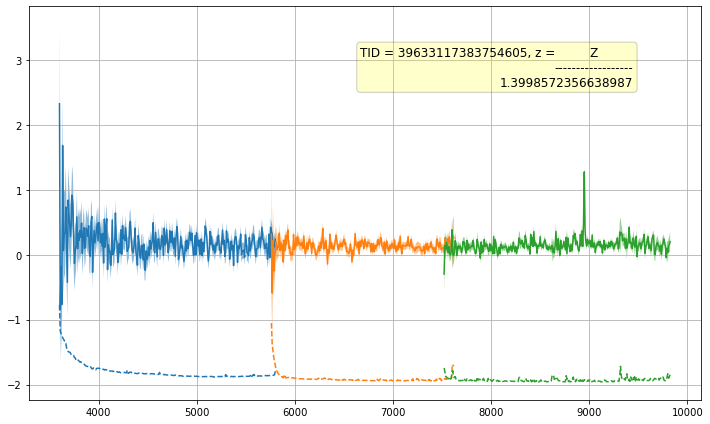

TARGETID=39633117383754660
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754660         0        329 ... 60256.45965609 60256.45965609


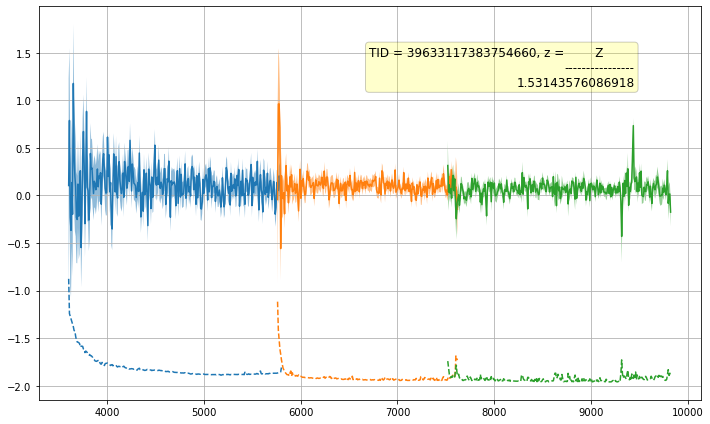

TARGETID=39633117383754669
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754669         0        413 ... 60256.45965609 60256.45965609


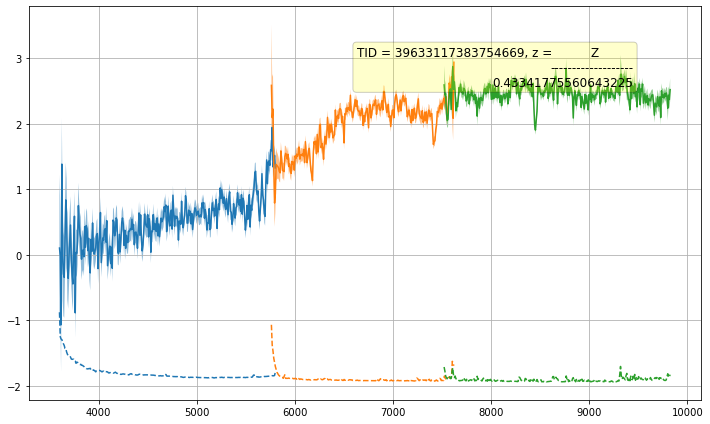

TARGETID=39633117383754684
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754684         0        310 ... 60256.45965609 60256.45965609


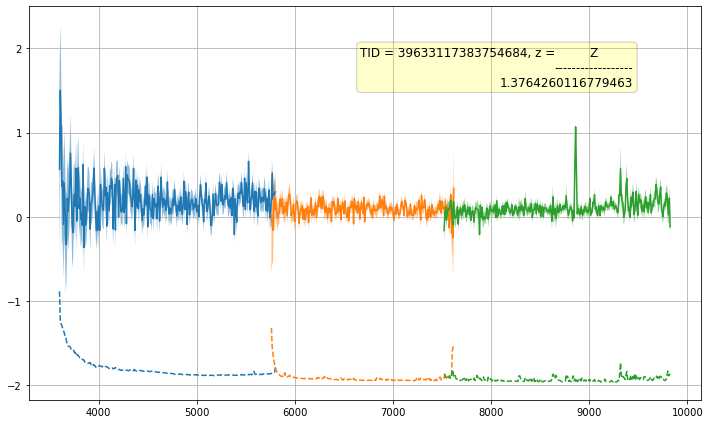

TARGETID=39633117383754764
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754764         0        412 ... 60256.45965609 60256.45965609


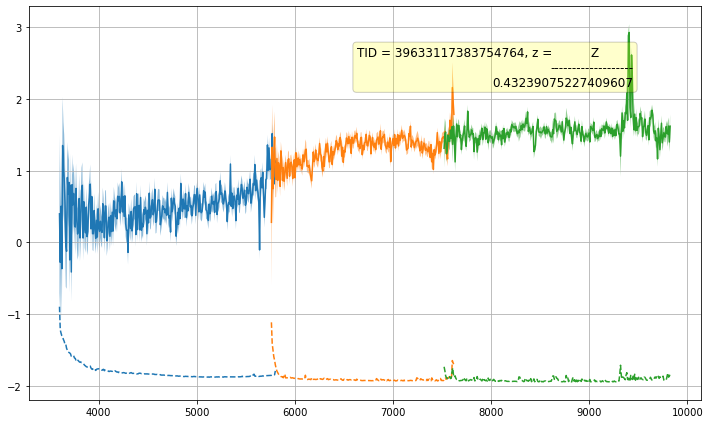

TARGETID=39633117383754766
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383754766         0        350 ... 60256.45965609 60256.45965609


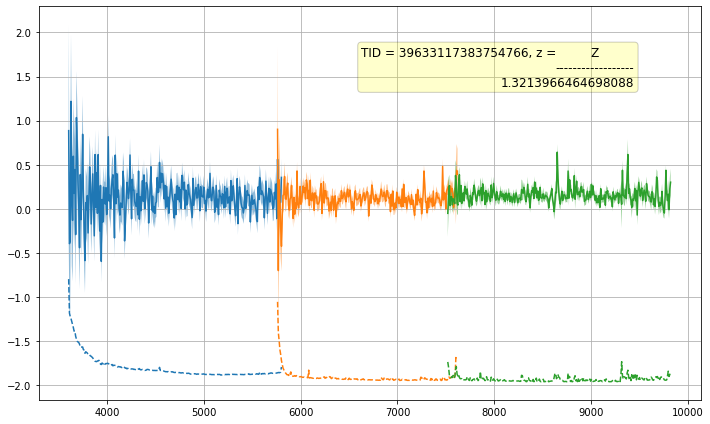

TARGETID=39633117383755160
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383755160         0        349 ... 60256.45965609 60256.45965609


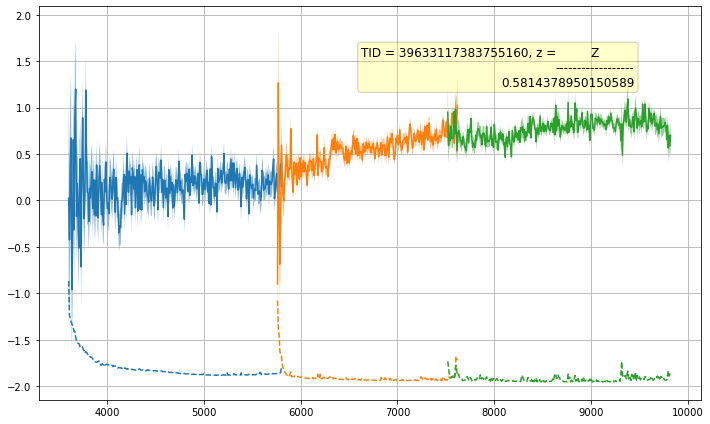

TARGETID=39633117383755376
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383755376         0        309 ... 60256.45965609 60256.45965609


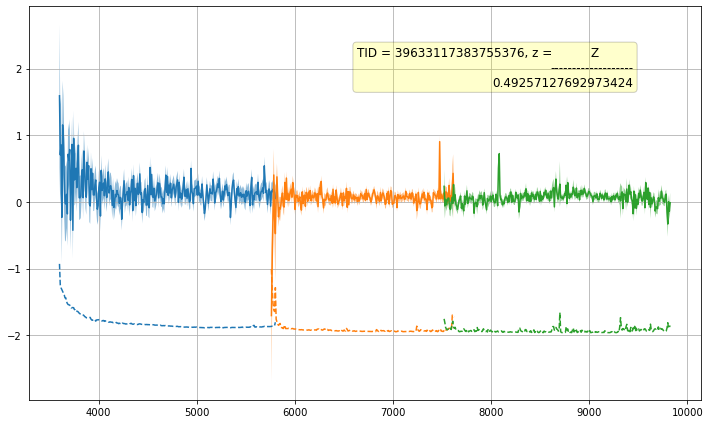

TARGETID=39633117383755418
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383755418         0        411 ... 60256.45965609 60256.45965609


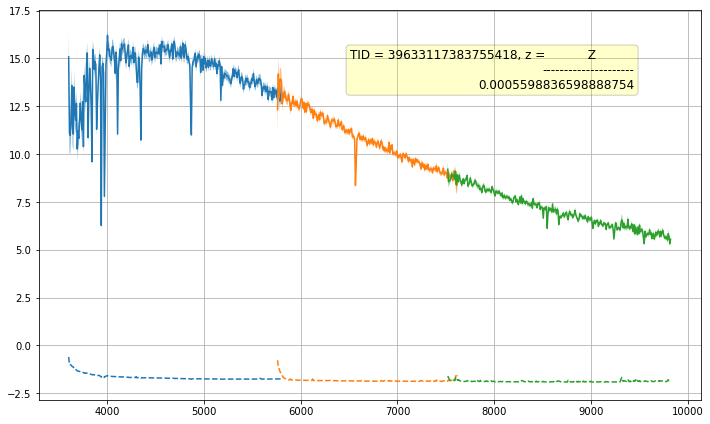

TARGETID=39633117383755472
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383755472         0        328 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


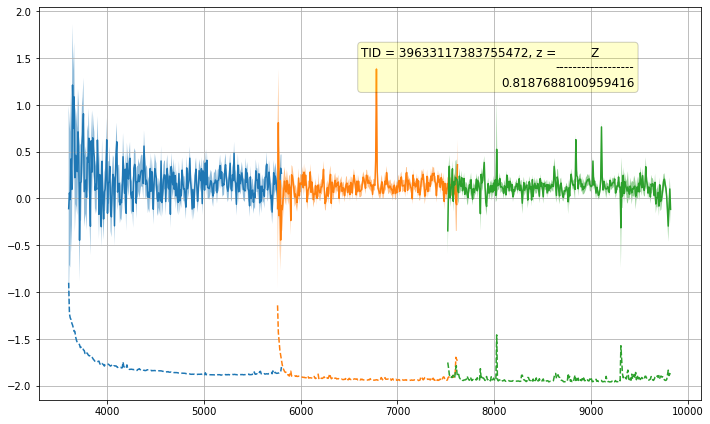

TARGETID=39633117383755494
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383755494         0        290 ... 60256.45965609 60256.45965609


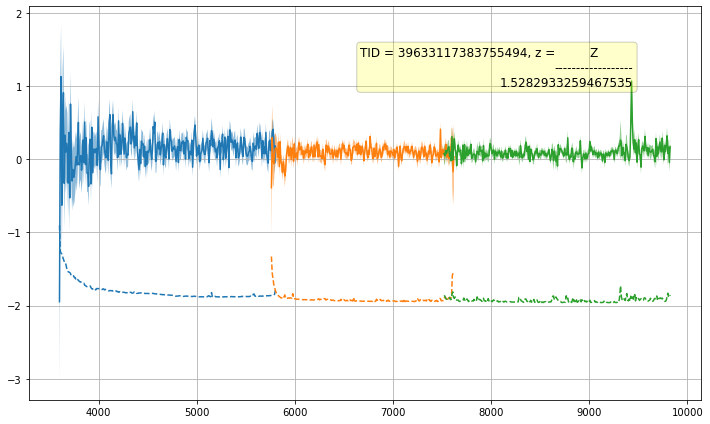

TARGETID=39633117383755584
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383755584         0        369 ... 60256.45965609 60256.45965609


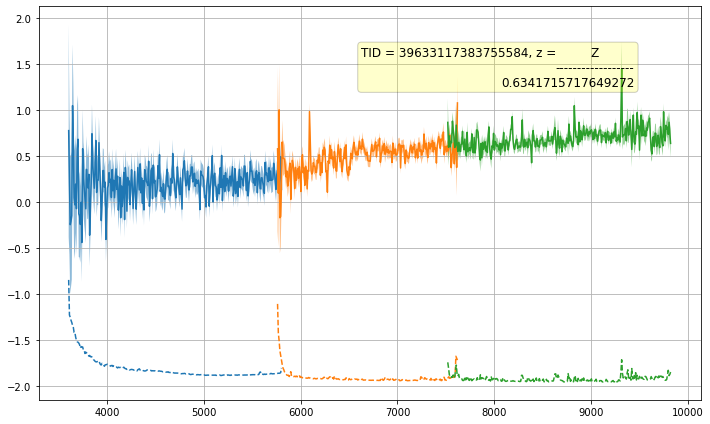

TARGETID=39633117383755709
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383755709         0        390 ... 60256.45965609 60256.45965609


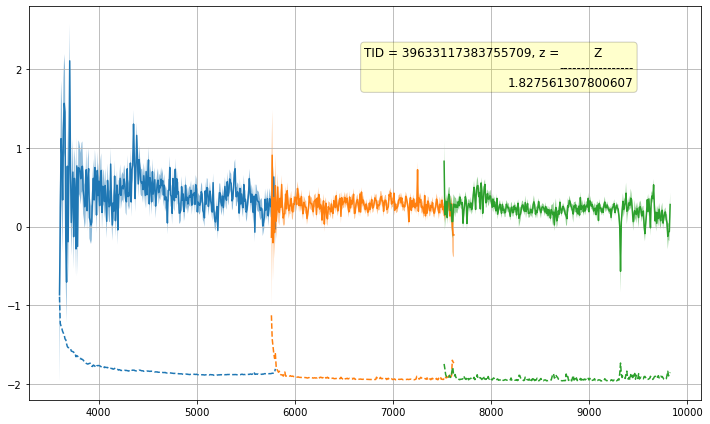

TARGETID=39633117383755782
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383755782         0        308 ... 60256.45965609 60256.45965609


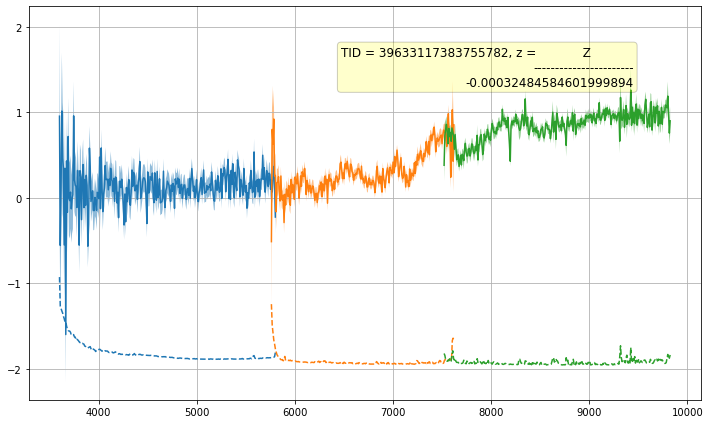

TARGETID=39633117383755888
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383755888         0        327 ... 60256.45965609 60256.45965609


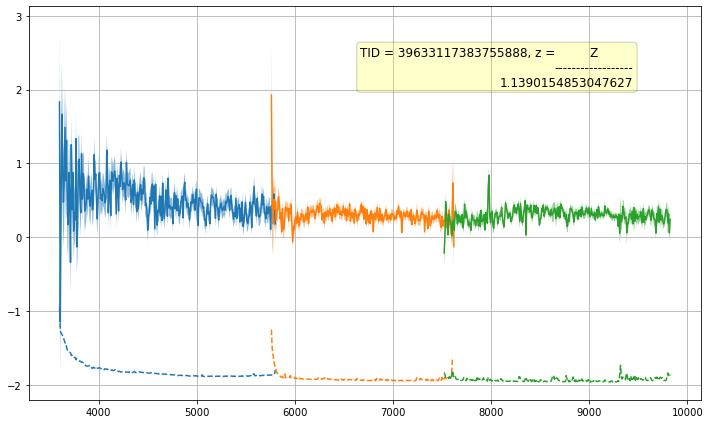

TARGETID=39633117383756020
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756020         0        368 ... 60256.45965609 60256.45965609


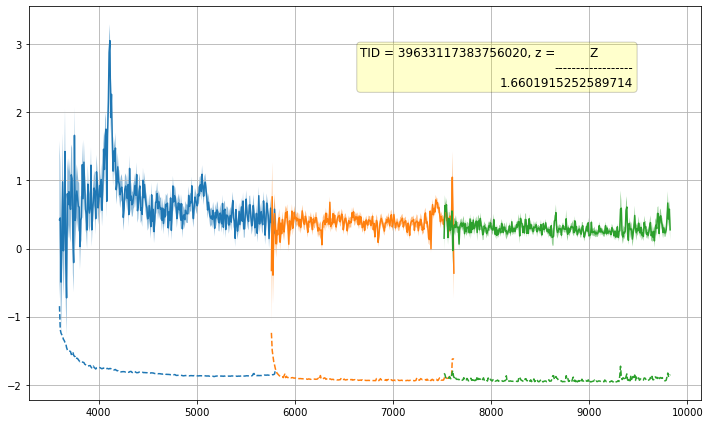

TARGETID=39633117383756308
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756308         0        389 ... 60256.45965609 60256.45965609


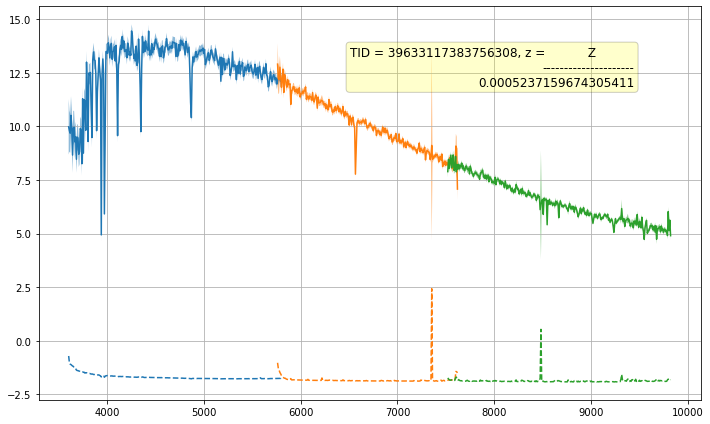

TARGETID=39633117383756378
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756378         0        289 ... 60256.45965609 60256.45965609


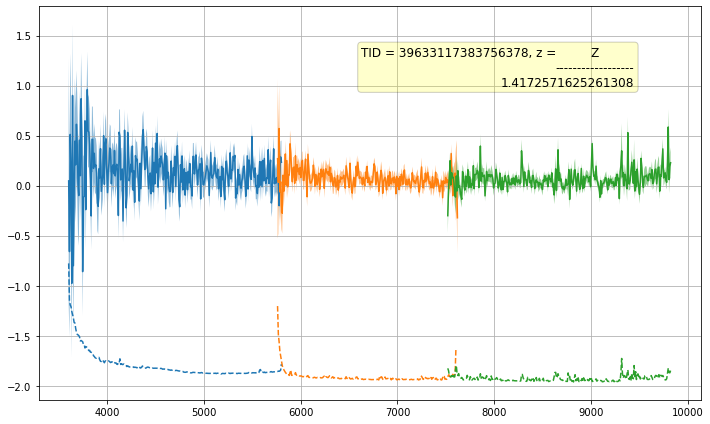

TARGETID=39633117383756521
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756521         0        347 ... 60256.45965609 60256.45965609


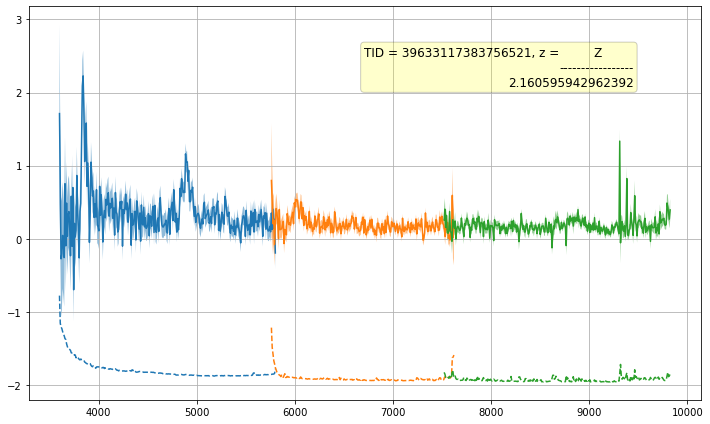

TARGETID=39633117383756599
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756599         0        410 ... 60256.45965609 60256.45965609


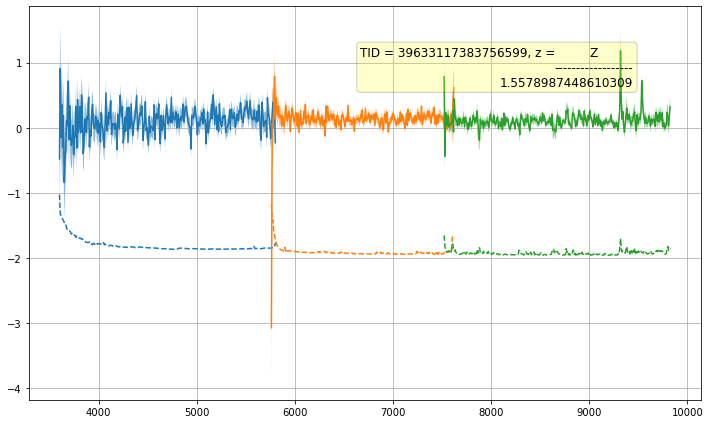

TARGETID=39633117383756647
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756647         0        388 ... 60256.45965609 60256.45965609


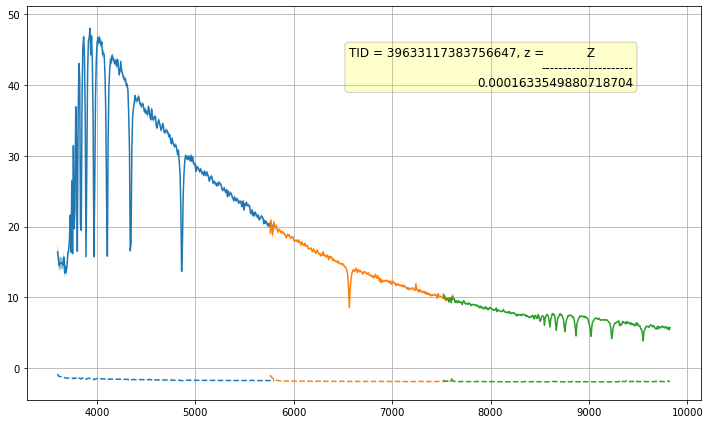

TARGETID=39633117383756725
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756725         0        409 ... 60256.45965609 60256.45965609


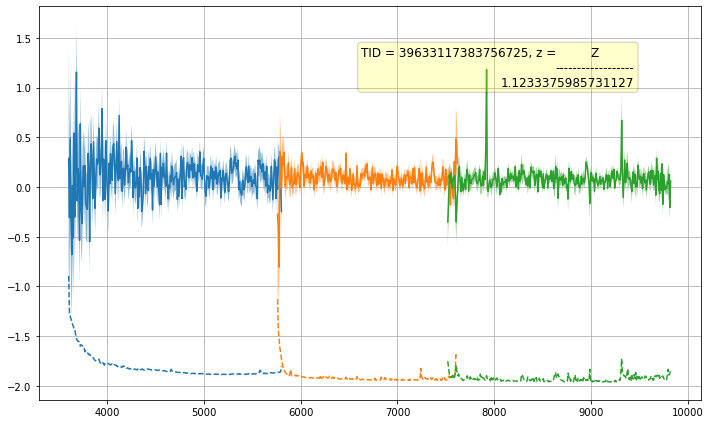

TARGETID=39633117383756765
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756765         0        326 ... 60256.45965609 60256.45965609


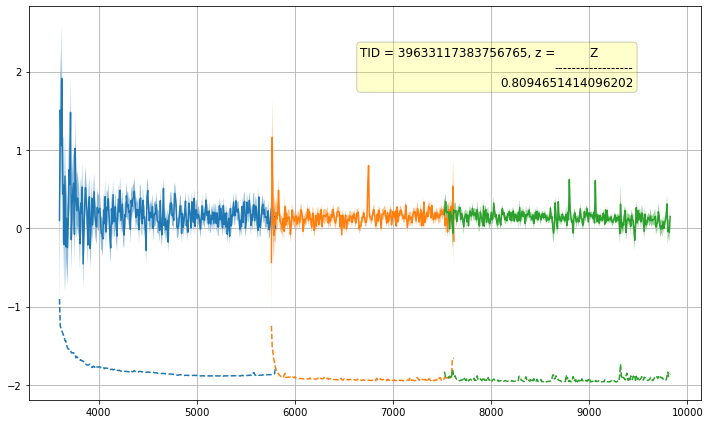

TARGETID=39633117383756778
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756778         0        270 ... 60256.45965609 60256.45965609


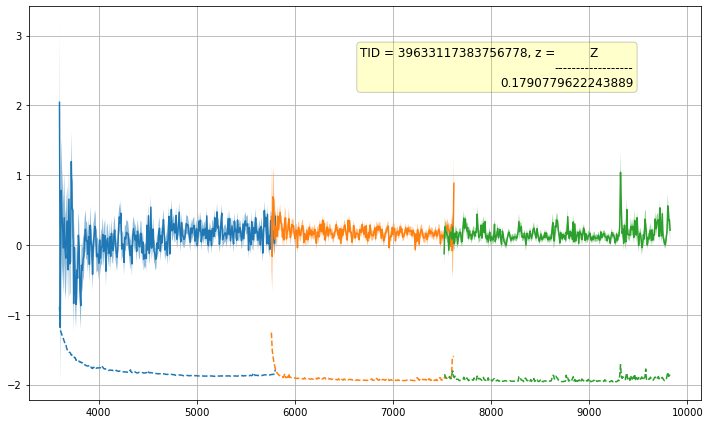

TARGETID=39633117383756882
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383756882         0        366 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


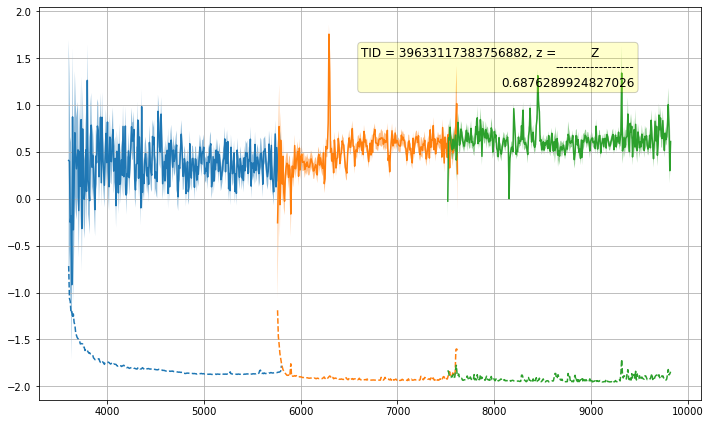

TARGETID=39633117383757097
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383757097         0        269 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


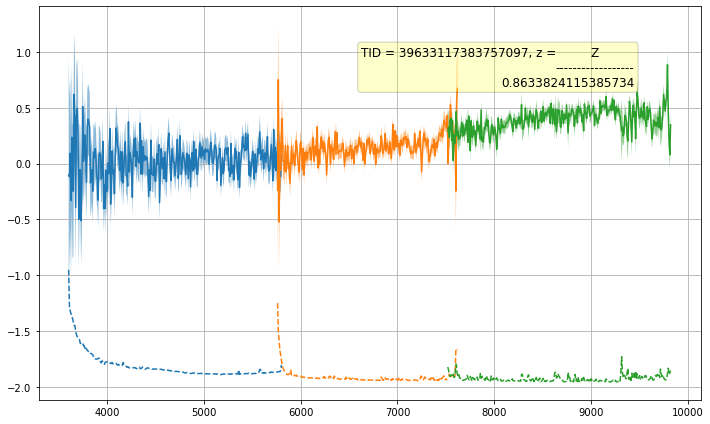

TARGETID=39633117383757215
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383757215         0        288 ... 60256.45965609 60256.45965609


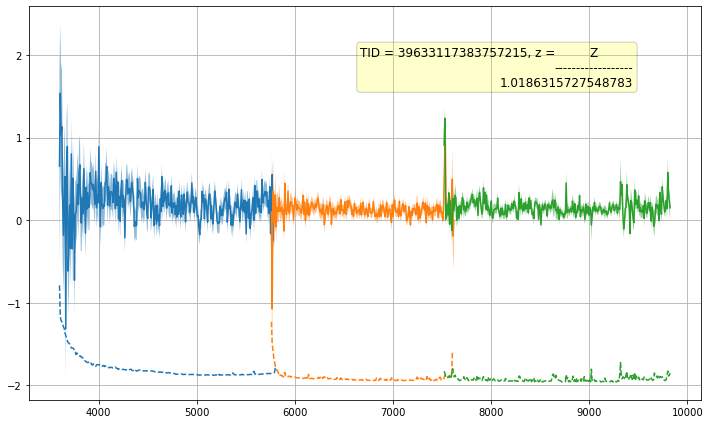

TARGETID=39633117383757223
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383757223         0        346 ... 60256.45965609 60256.45965609


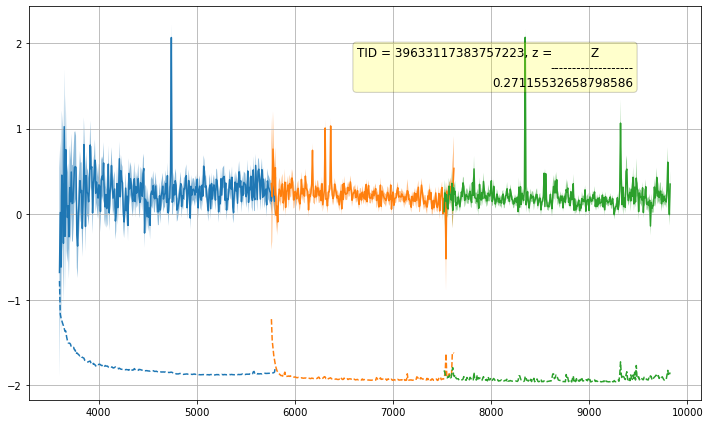

TARGETID=39633117383757378
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383757378         0        306 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


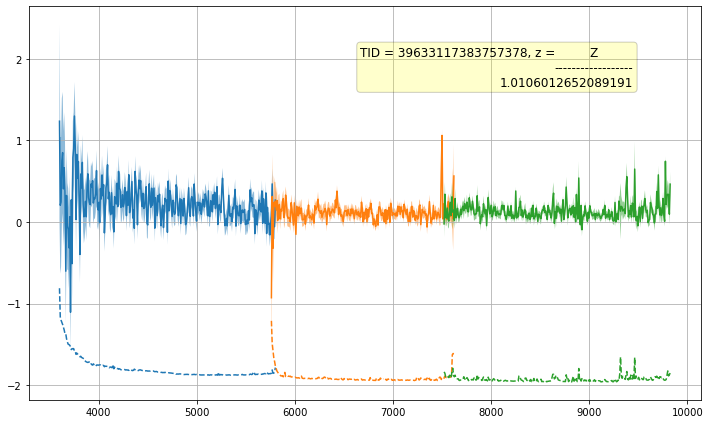

TARGETID=39633117383757413
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117383757413         0        325 ... 60256.45965609 60256.45965609


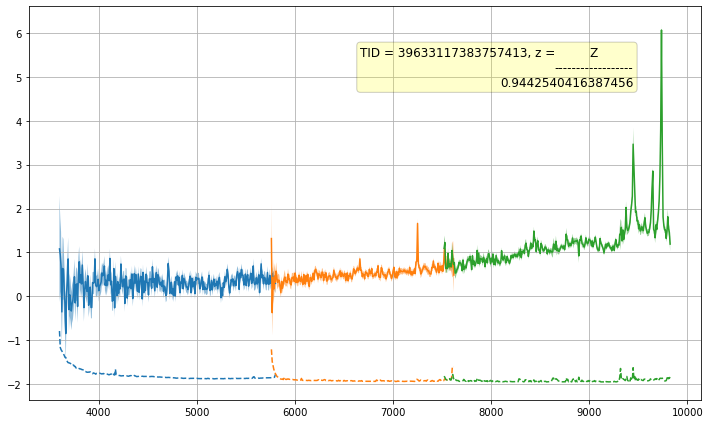

TARGETID=39633117387948064
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387948064         0        305 ... 60256.45965609 60256.45965609


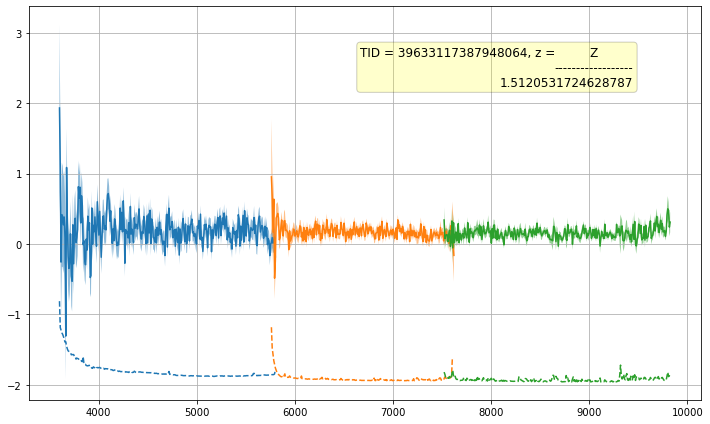

TARGETID=39633117387948181
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387948181         0        268 ... 60256.45965609 60256.45965609


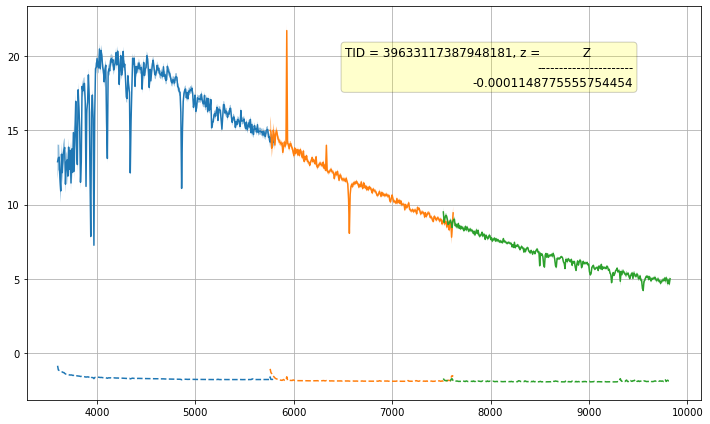

TARGETID=39633117387948204
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387948204         0        287 ... 60256.45965609 60256.45965609


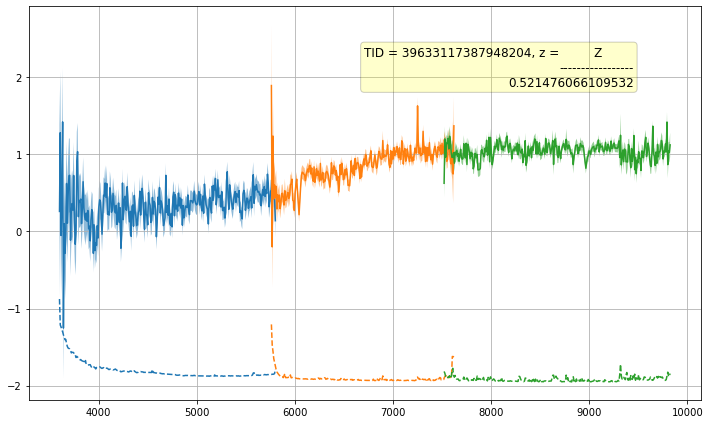

TARGETID=39633117387948227
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387948227         0        345 ... 60256.45965609 60256.45965609


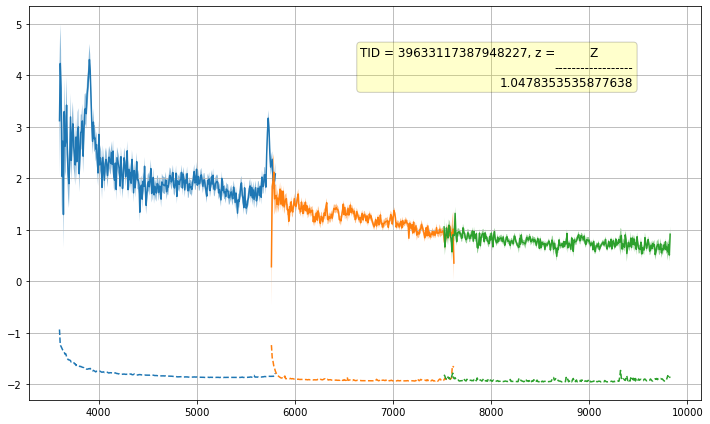

TARGETID=39633117387948244
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387948244         0        386 ... 60256.45965609 60256.45965609


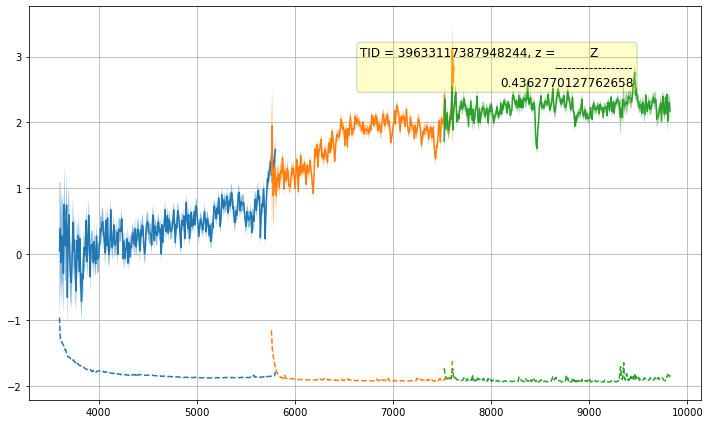

TARGETID=39633117387948619
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387948619         0        286 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


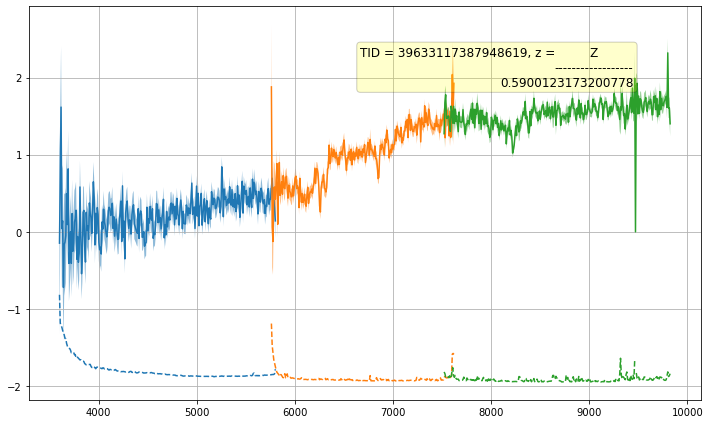

TARGETID=39633117387948762
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387948762         0        385 ... 60256.45965609 60256.45965609


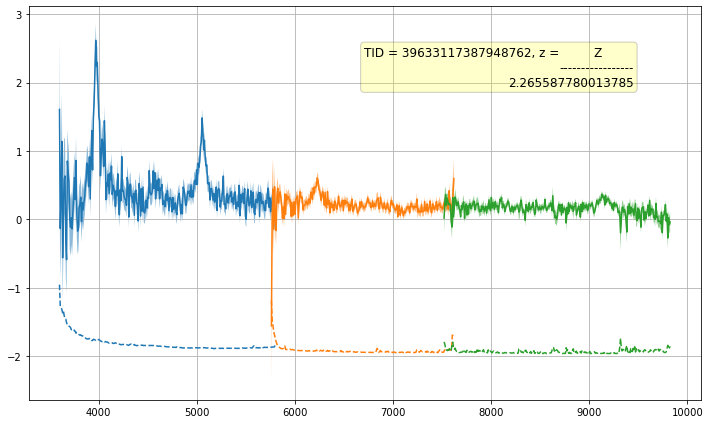

TARGETID=39633117387948834
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387948834         0        344 ... 60256.45965609 60256.45965609


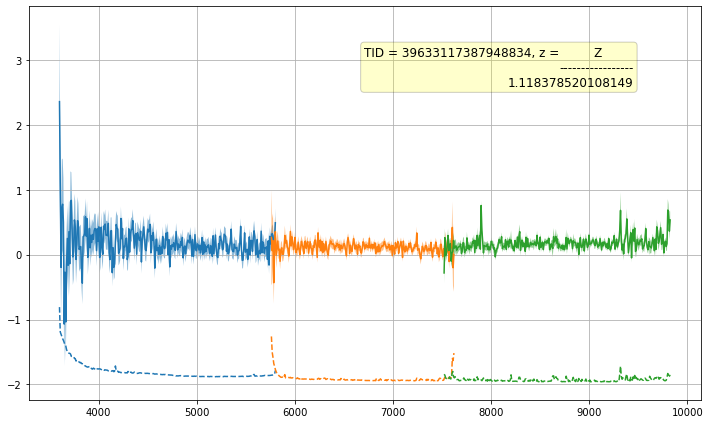

TARGETID=39633117387948883
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387948883         0        267 ... 60256.45965609 60256.45965609


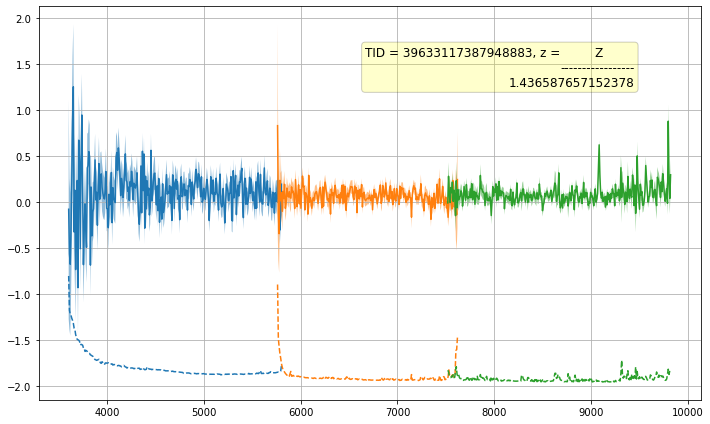

TARGETID=39633117387949541
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387949541         0        266 ... 60256.45965609 60256.45965609


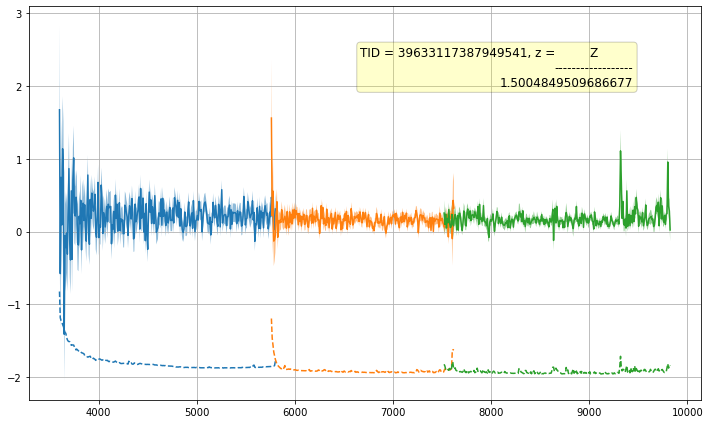

TARGETID=39633117387949615
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387949615         0        322 ... 60256.45965609 60256.45965609


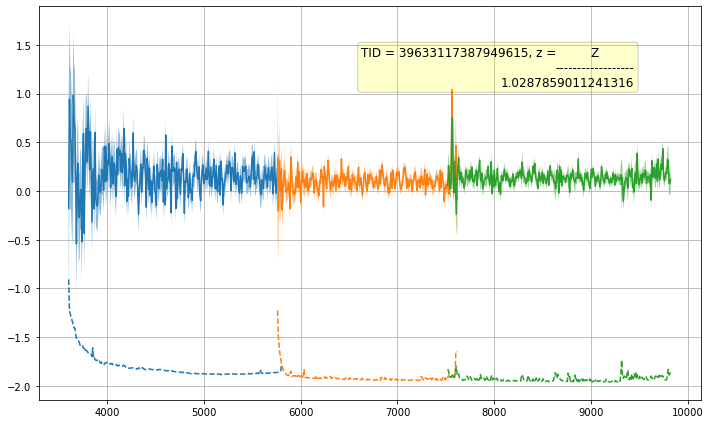

TARGETID=39633117387949819
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387949819         0        342 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


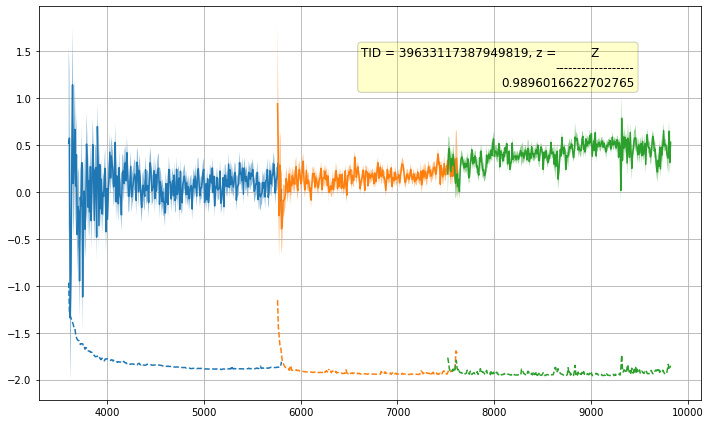

TARGETID=39633117387950002
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950002         0        383 ... 60256.45965609 60256.45965609


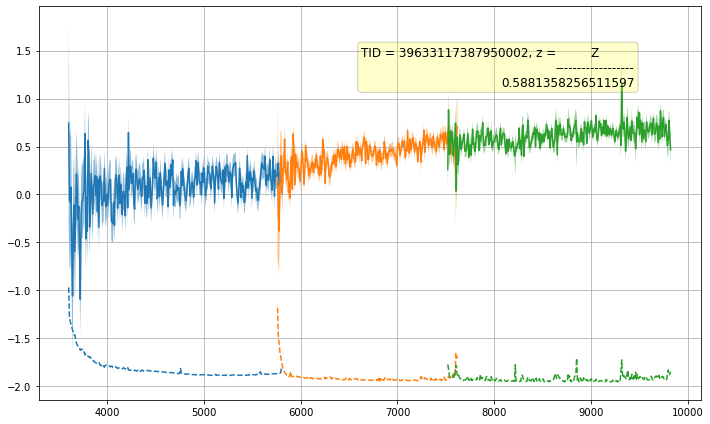

TARGETID=39633117387950031
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950031         0        362 ... 60256.45965609 60256.45965609


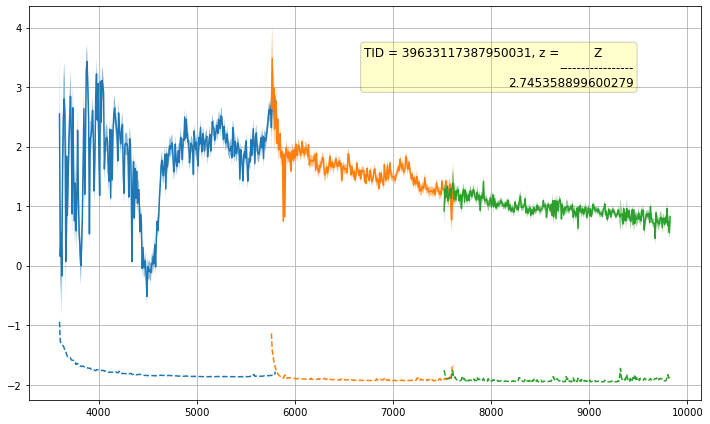

TARGETID=39633117387950041
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950041         0        265 ... 60256.45965609 60256.45965609


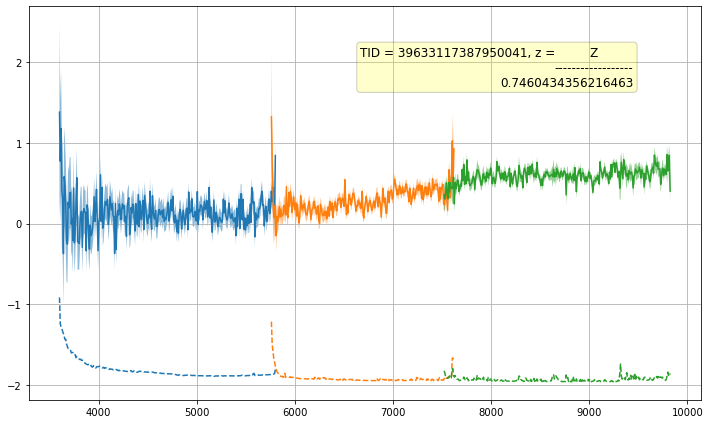

TARGETID=39633117387950117
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950117         0        248 ... 60256.45965609 60256.45965609


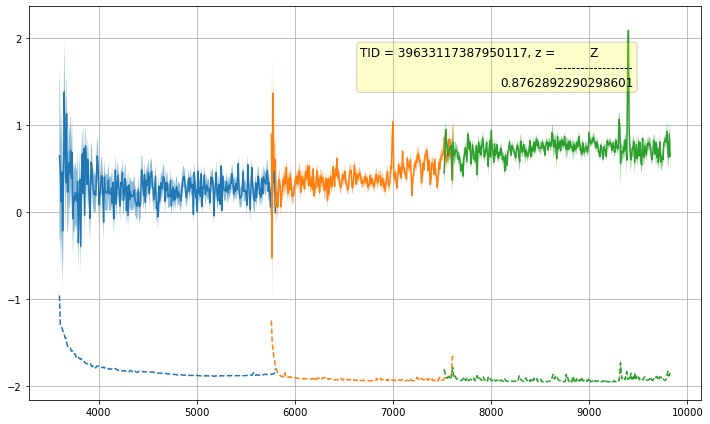

TARGETID=39633117387950128
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950128         0        341 ... 60256.45965609 60256.45965609


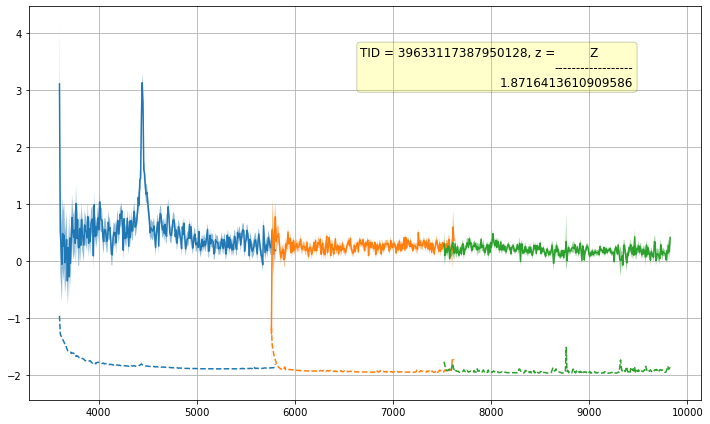

TARGETID=39633117387950384
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950384         0        361 ... 60256.45965609 60256.45965609


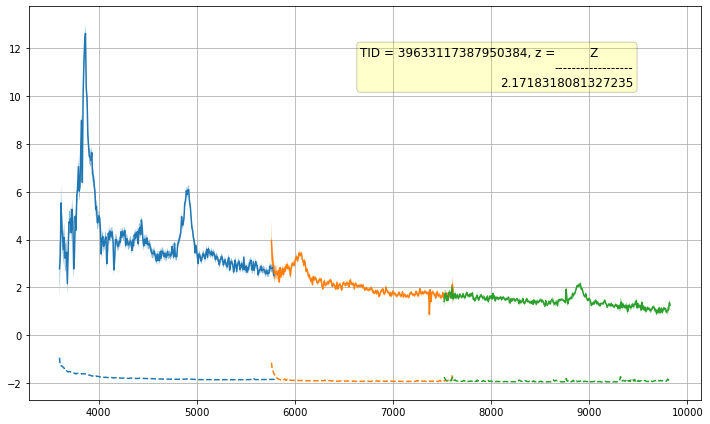

TARGETID=39633117387950517
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950517         0        320 ... 60256.45965609 60256.45965609


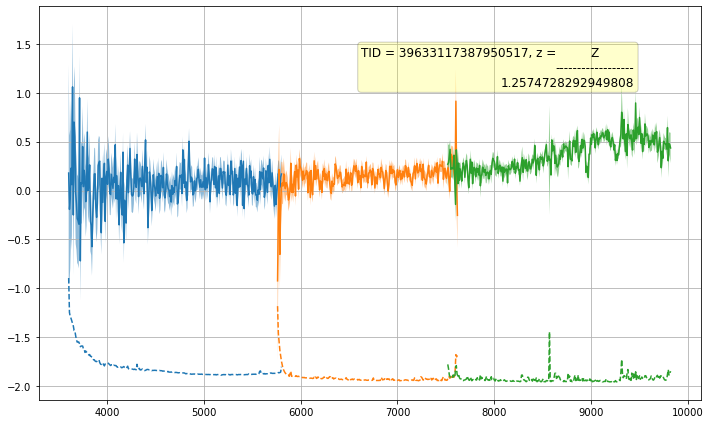

TARGETID=39633117387950548
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950548         0        283 ... 60256.45965609 60256.45965609


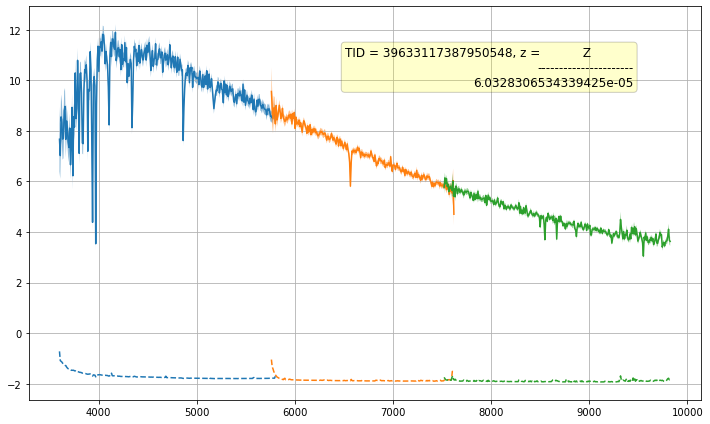

TARGETID=39633117387950851
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950851         0        340 ... 60256.45965609 60256.45965609


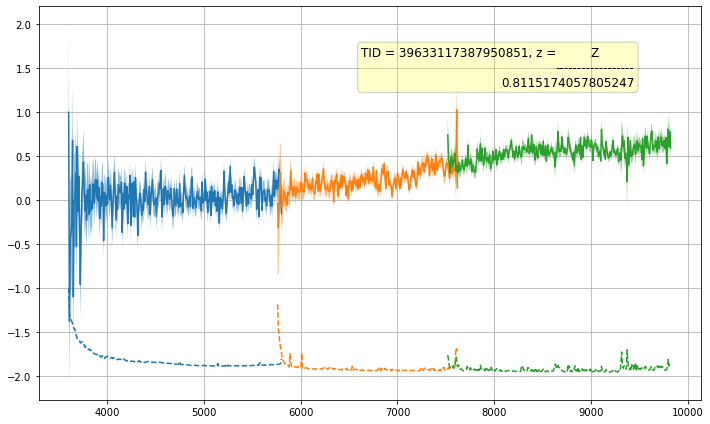

TARGETID=39633117387950908
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387950908         0        264 ... 60256.45965609 60256.45965609


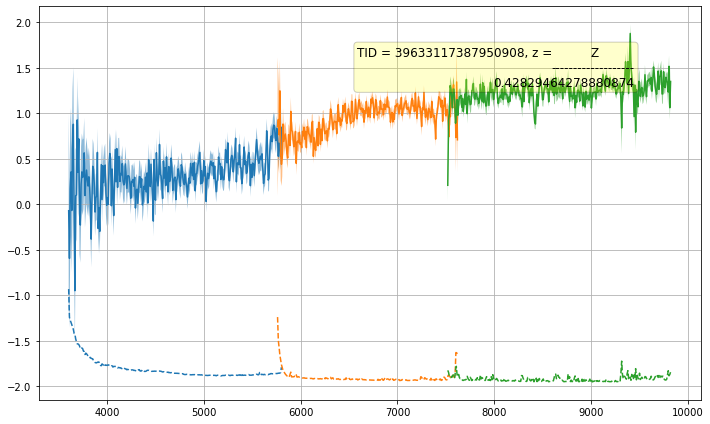

TARGETID=39633117387951217
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387951217         0        282 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


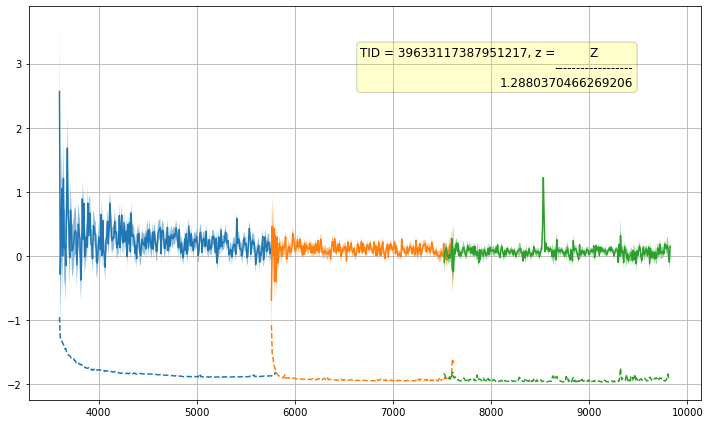

TARGETID=39633117387951241
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387951241         0        300 ... 60256.45965609 60256.45965609


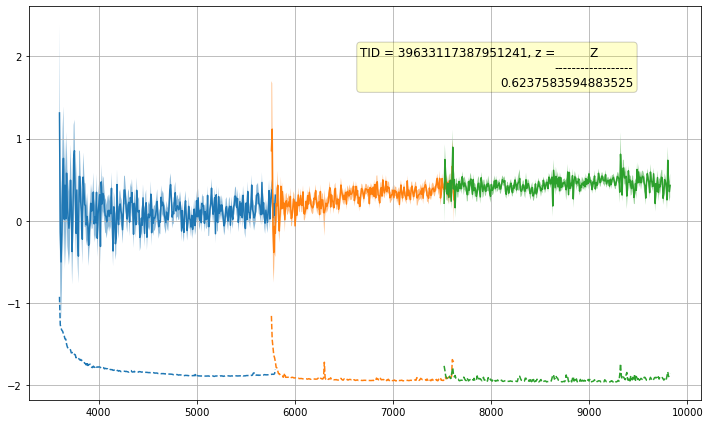

TARGETID=39633117387951321
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387951321         0        263 ... 60256.45965609 60256.45965609


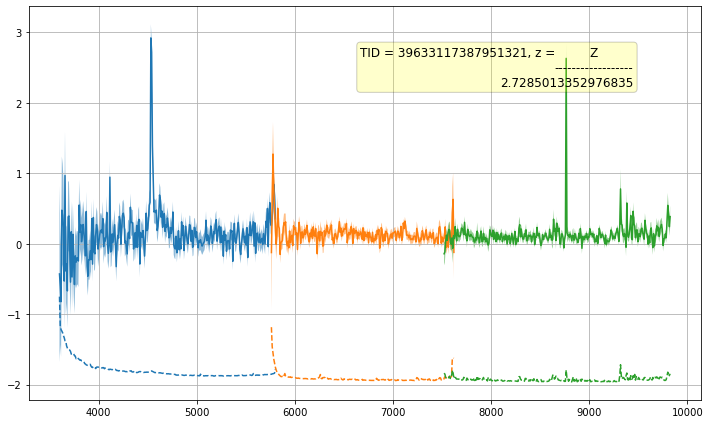

TARGETID=39633117387951394
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387951394         0        360 ... 60256.45965609 60256.45965609


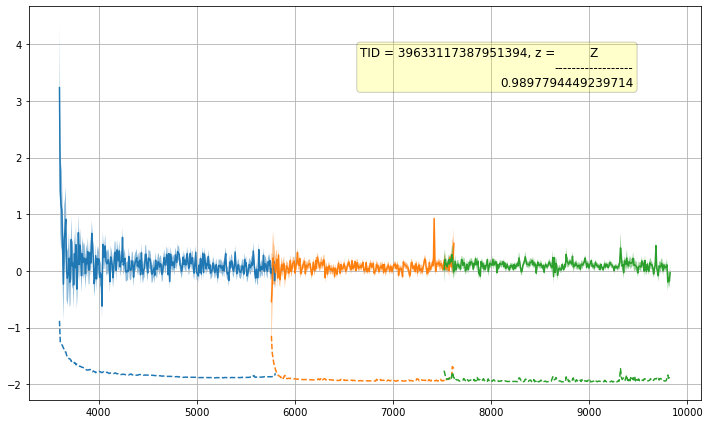

TARGETID=39633117387951515
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387951515         0        319 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


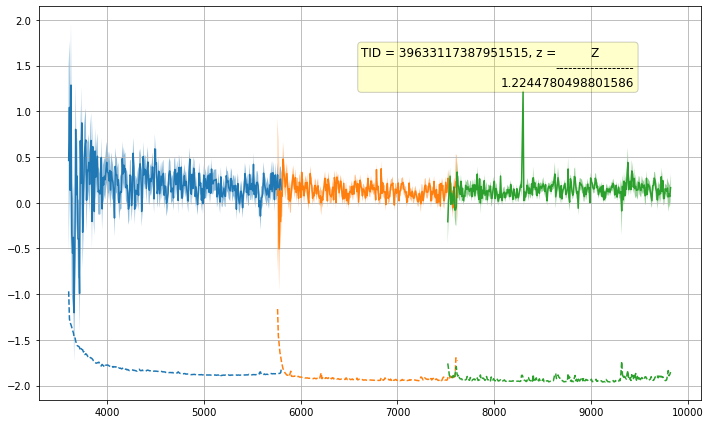

TARGETID=39633117387951571
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387951571         0        339 ... 60256.45965609 60256.45965609


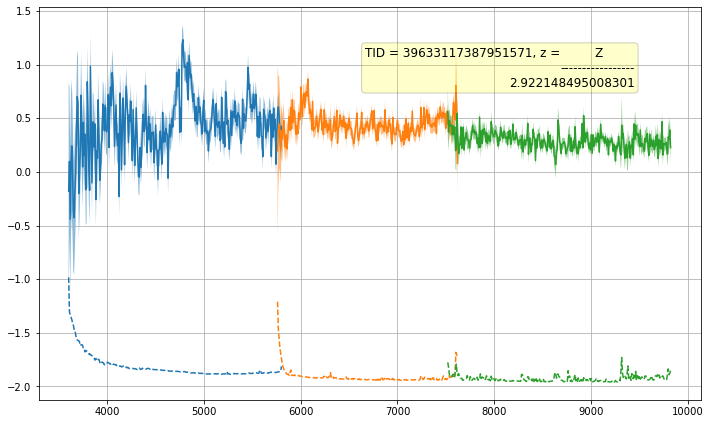

TARGETID=39633117387951635
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387951635         0        246 ... 60256.45965609 60256.45965609


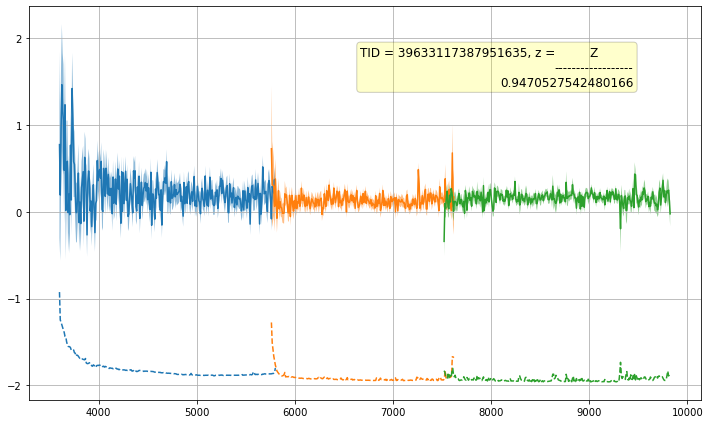

TARGETID=39633117387951886
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117387951886         0        281 ... 60256.45965609 60256.45965609


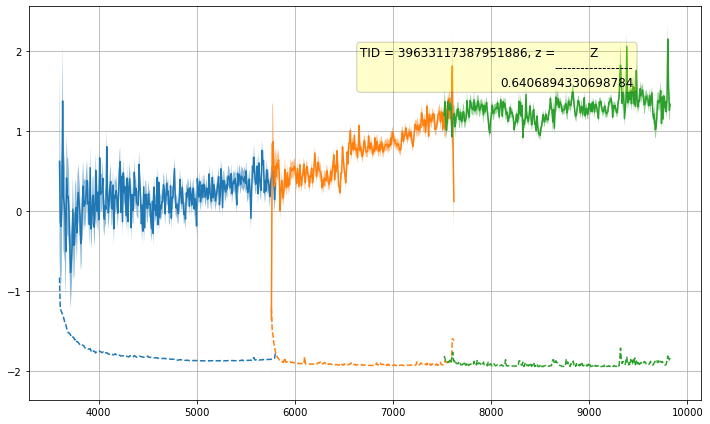

TARGETID=39633117392142424
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392142424         0        359 ... 60256.45965609 60256.45965609


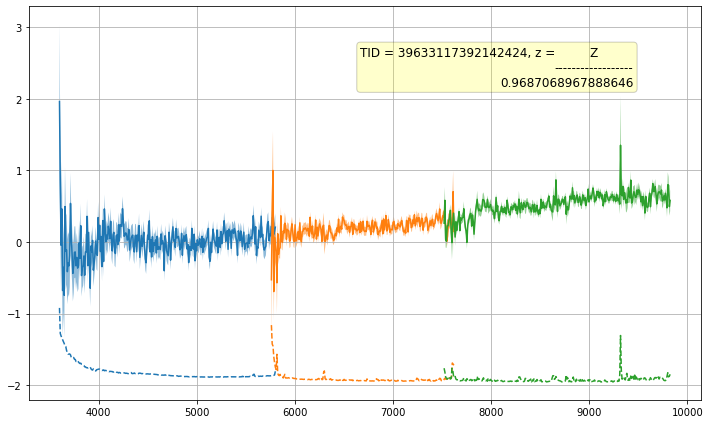

TARGETID=39633117392142487
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392142487         0        299 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


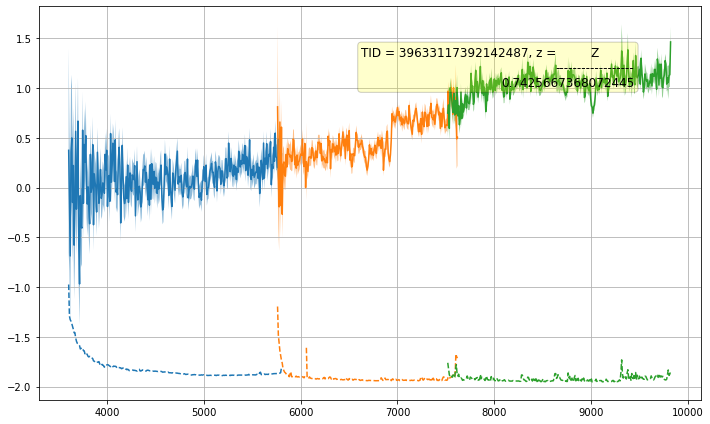

TARGETID=39633117392142718
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392142718         0        262 ... 60256.45965609 60256.45965609


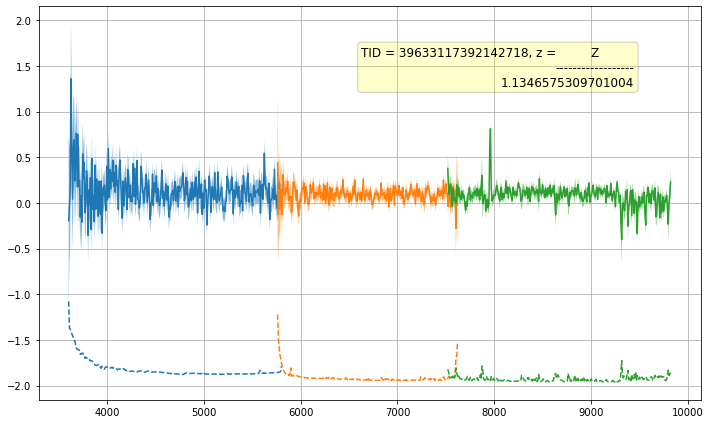

TARGETID=39633117392142771
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392142771         0        245 ... 60256.45965609 60256.45965609


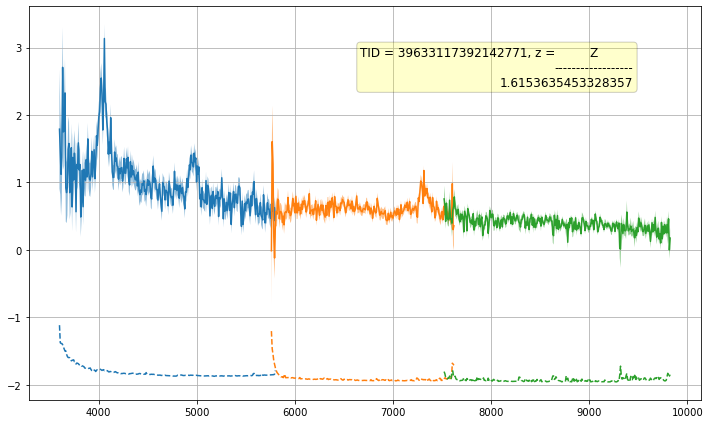

TARGETID=39633117392142998
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392142998         0        318 ... 60256.45965609 60256.45965609


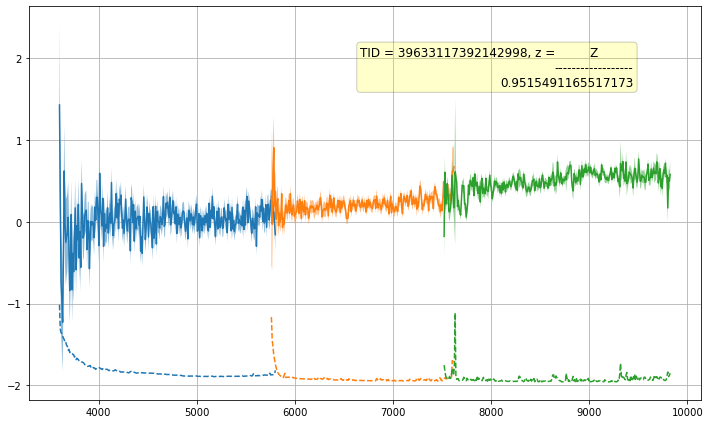

TARGETID=39633117392143117
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392143117         0        244 ... 60256.45965609 60256.45965609


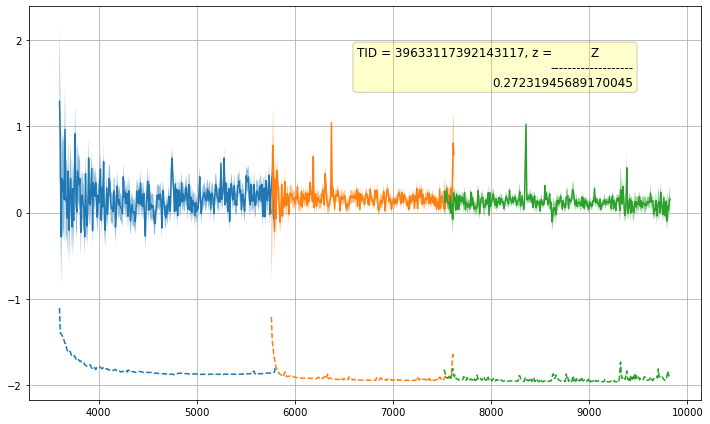

TARGETID=39633117392143281
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392143281         0        298 ... 60256.45965609 60256.45965609


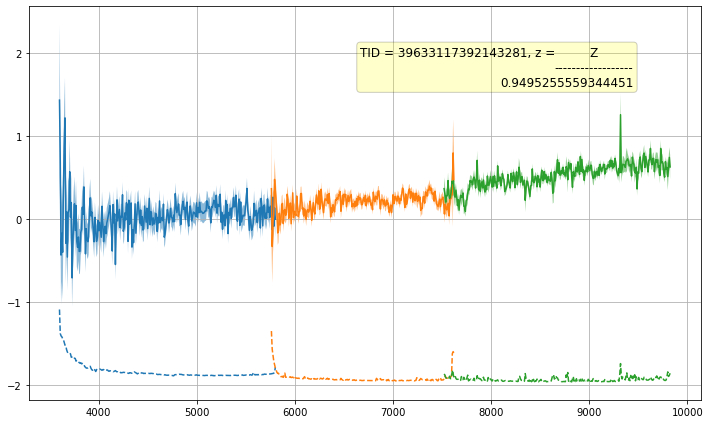

TARGETID=39633117392143403
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392143403         0        337 ... 60256.45965609 60256.45965609


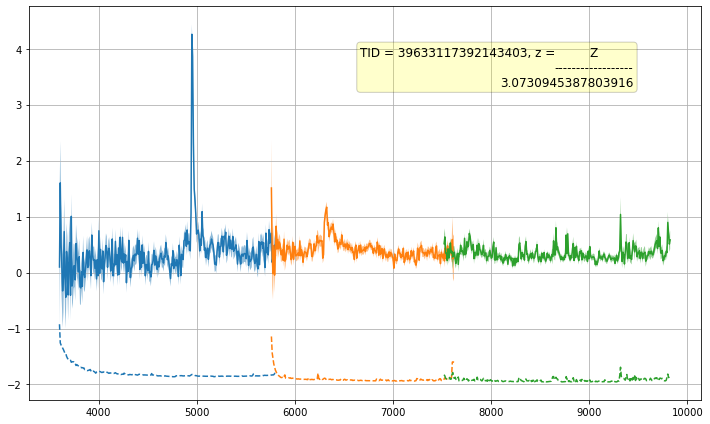

TARGETID=39633117392143453
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392143453         0        279 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


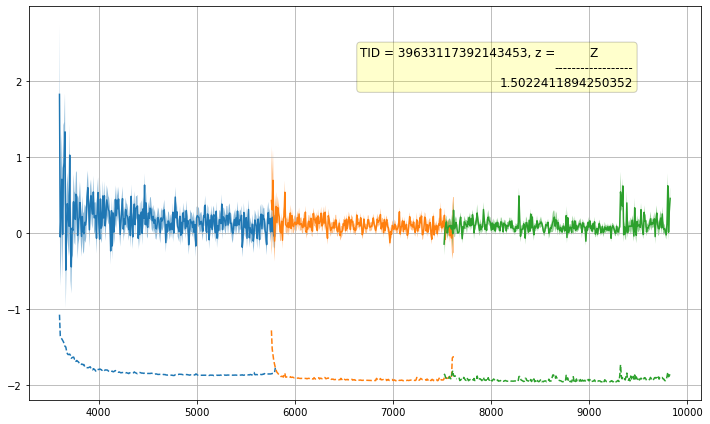

TARGETID=39633117392143661
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392143661         0        297 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


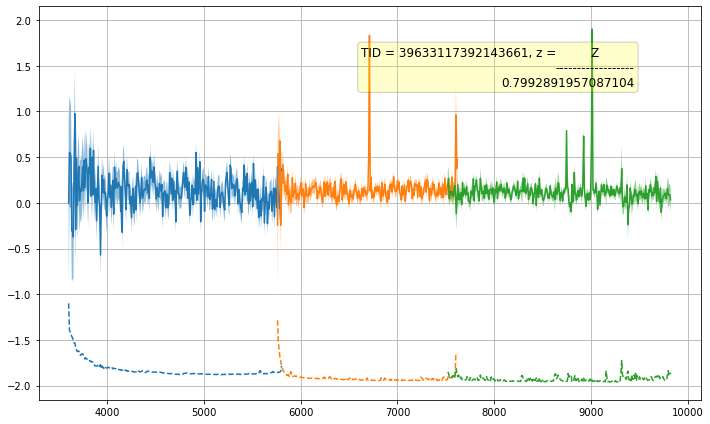

TARGETID=39633117392143695
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392143695         0        261 ... 60256.45965609 60256.45965609


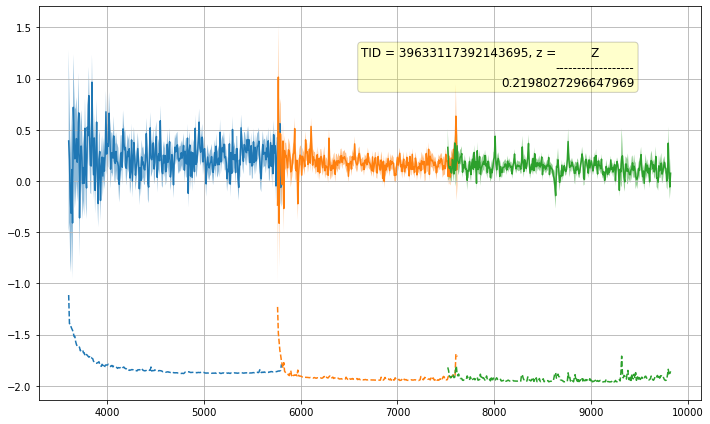

TARGETID=39633117392143745
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392143745         0        316 ... 60256.45965609 60256.45965609


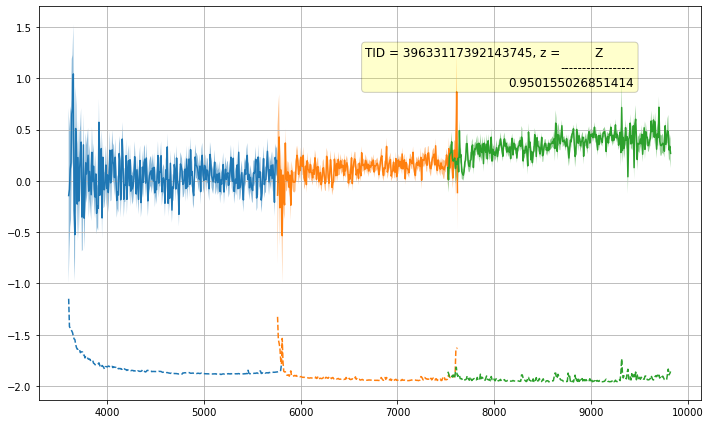

TARGETID=39633117392143897
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392143897         0        243 ... 60256.45965609 60256.45965609


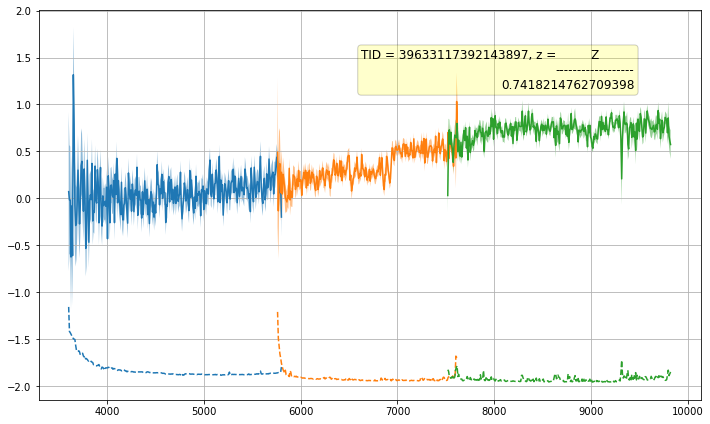

TARGETID=39633117392143961
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392143961         0        357 ... 60256.45965609 60256.45965609


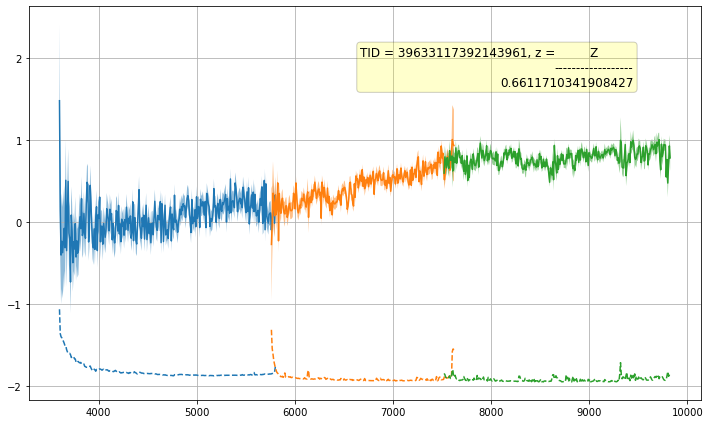

TARGETID=39633117392144178
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392144178         0        225 ... 60256.45965609 60256.45965609


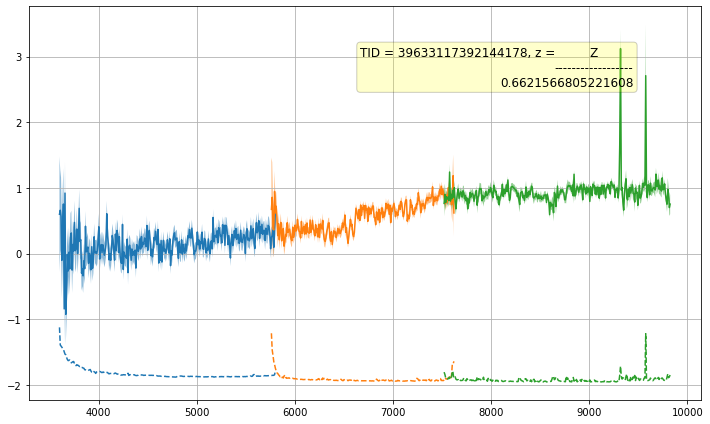

TARGETID=39633117392144381
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392144381         0        336 ... 60256.45965609 60256.45965609


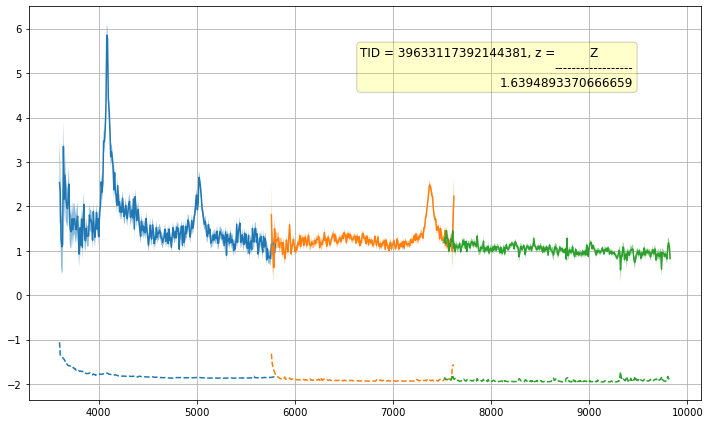

TARGETID=39633117392144422
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392144422         0        296 ... 60256.45965609 60256.45965609


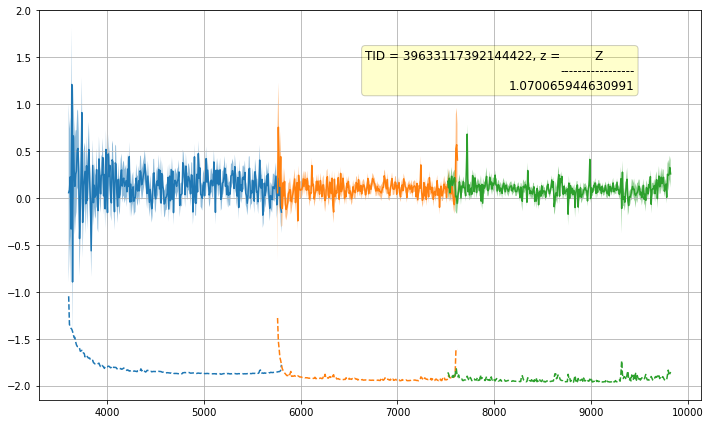

TARGETID=39633117392144483
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392144483         0        260 ... 60256.45965609 60256.45965609


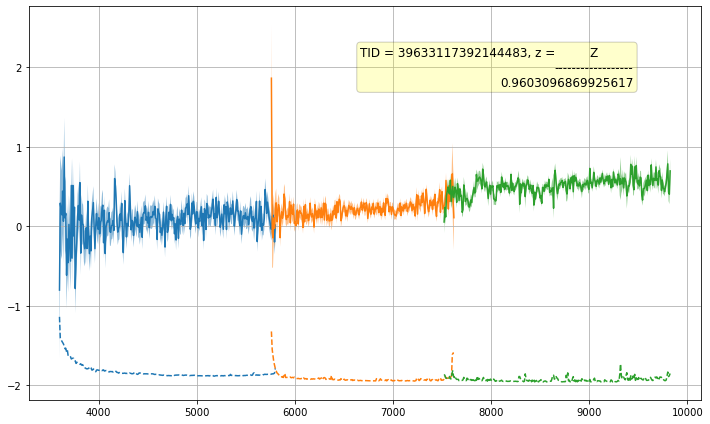

TARGETID=39633117392145115
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392145115         0        295 ... 60256.45965609 60256.45965609


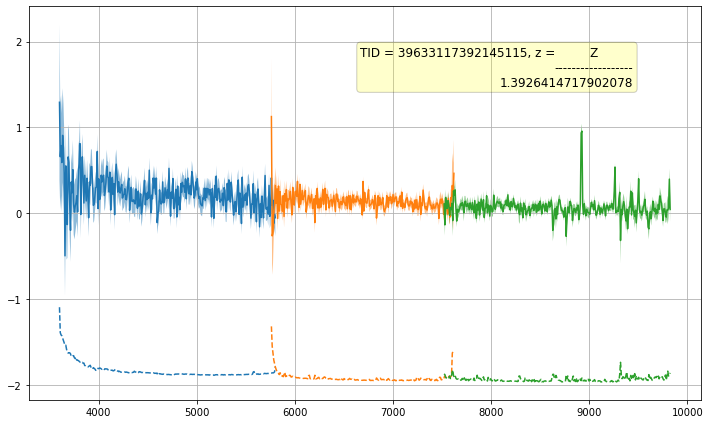

TARGETID=39633117392145155
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392145155         0        241 ... 60256.45965609 60256.45965609


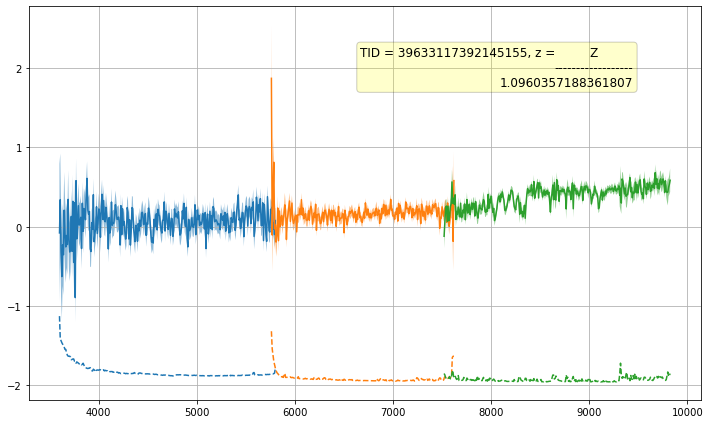

TARGETID=39633117392145200
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392145200         0        315 ... 60256.45965609 60256.45965609


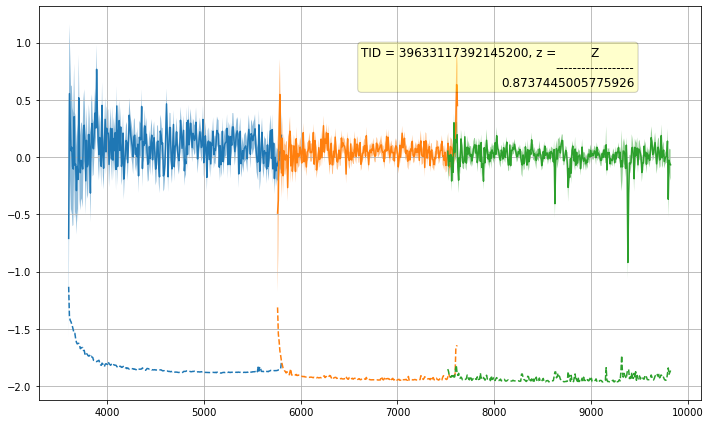

TARGETID=39633117392145334
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392145334         0        277 ... 60256.45965609 60256.45965609


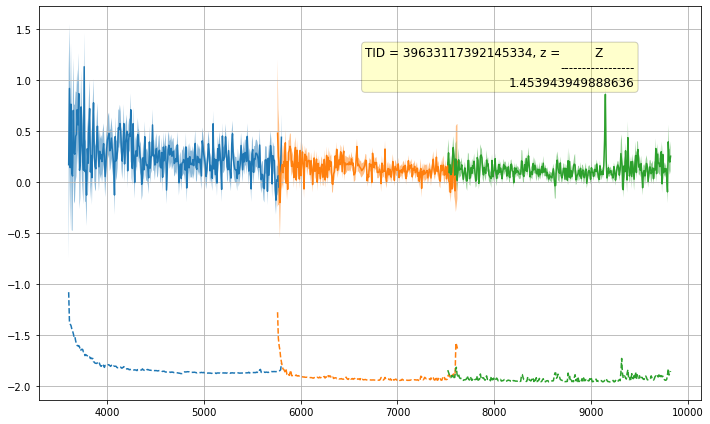

TARGETID=39633117392145419
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392145419         0        335 ... 60256.45965609 60256.45965609


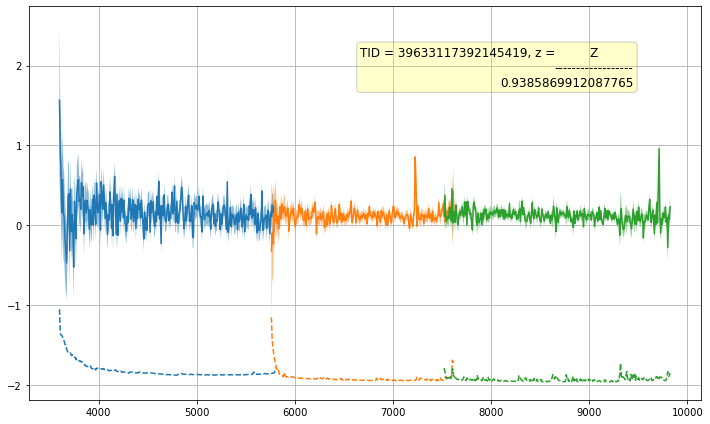

TARGETID=39633117392145651
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392145651         0        258 ... 60256.45965609 60256.45965609


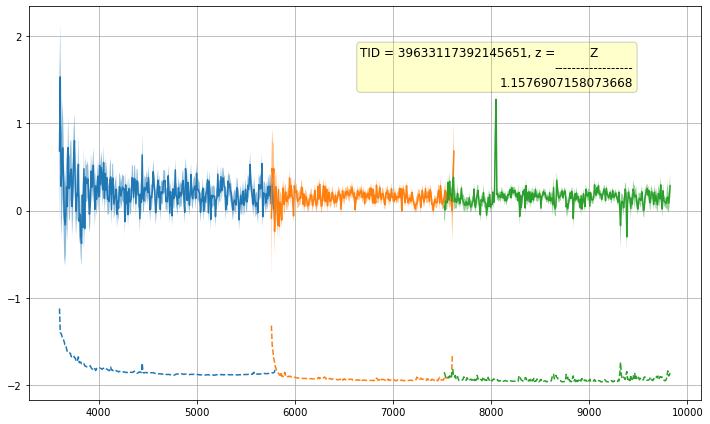

TARGETID=39633117392145952
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392145952         0        276 ... 60256.45965609 60256.45965609


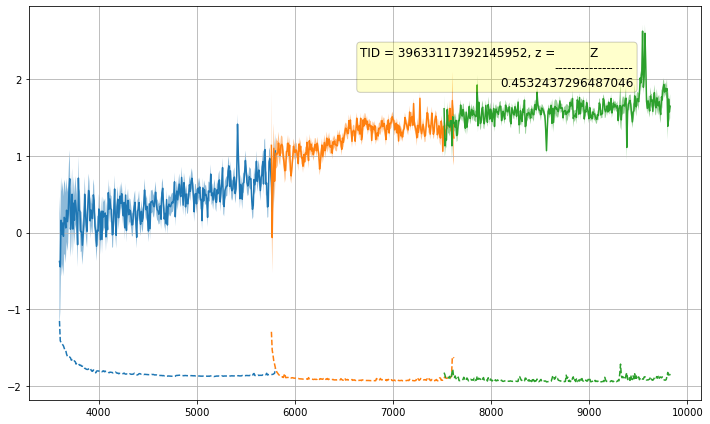

TARGETID=39633117392145994
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392145994         0        223 ... 60256.45965609 60256.45965609


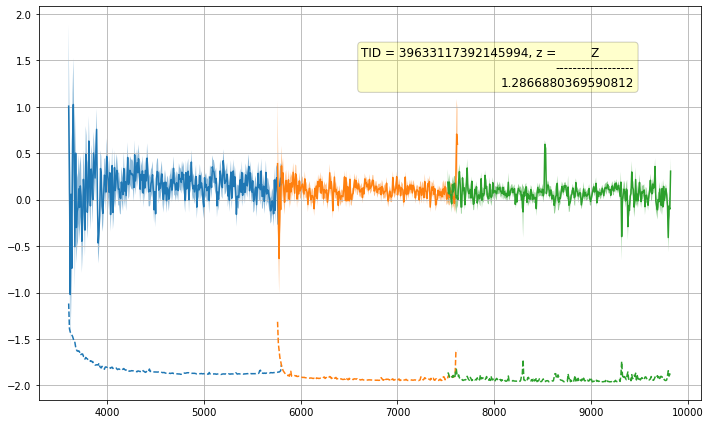

TARGETID=39633117392146052
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392146052         0        240 ... 60256.45965609 60256.45965609


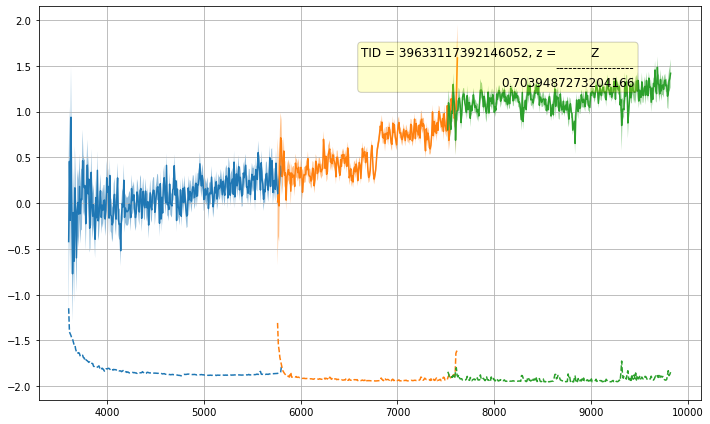

TARGETID=39633117392146115
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392146115         0        314 ... 60256.45965609 60256.45965609


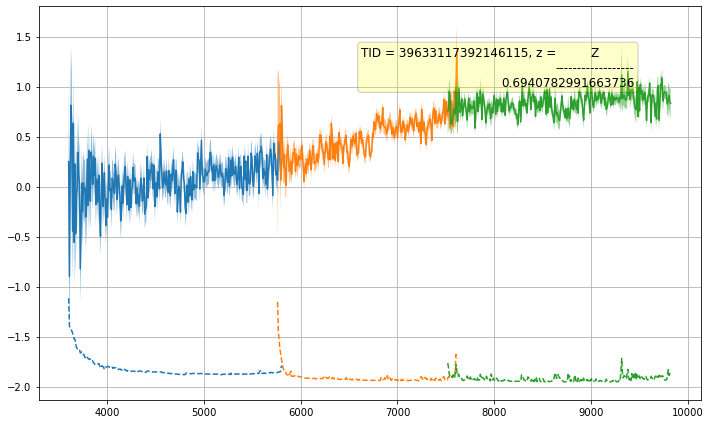

TARGETID=39633117392146347
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392146347         0        333 ... 60256.45965609 60256.45965609


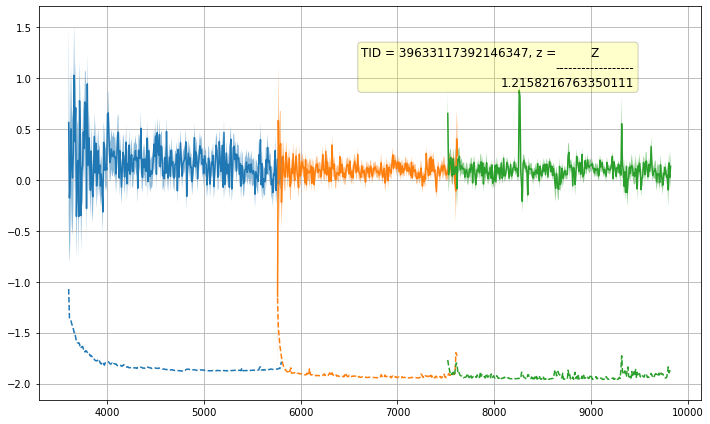

TARGETID=39633117392146489
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392146489         0        294 ... 60256.45965609 60256.45965609


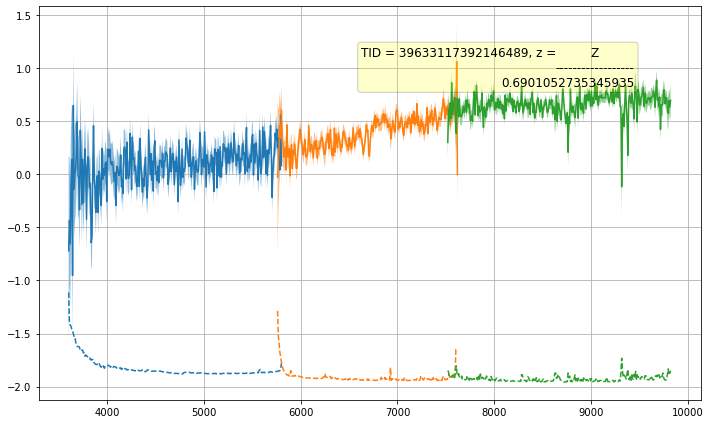

TARGETID=39633117392146795
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117392146795         0        275 ... 60256.45965609 60256.45965609


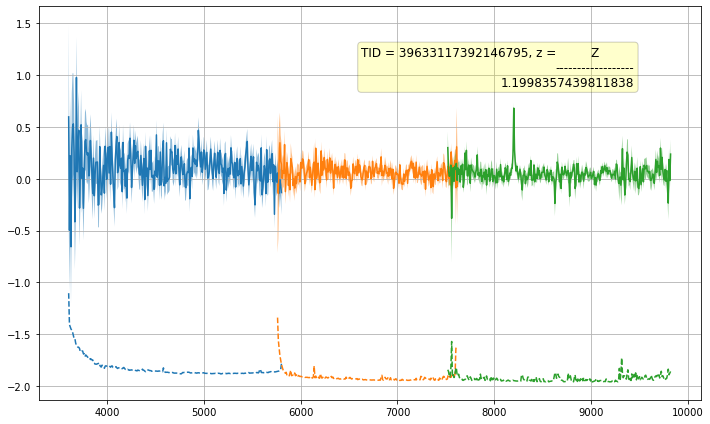

TARGETID=39633117396336906
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633117396336906         0        293 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


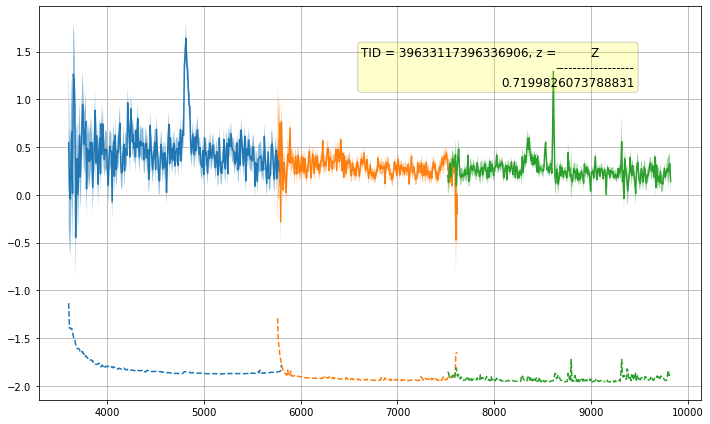

TARGETID=39633121859079618
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121859079618         0        274 ... 60256.45965609 60256.45965609


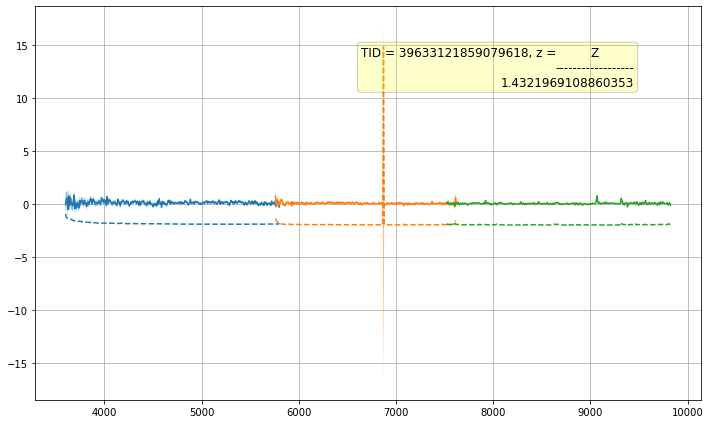

TARGETID=39633121859080016
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121859080016         0        256 ... 60256.45965609 60256.45965609


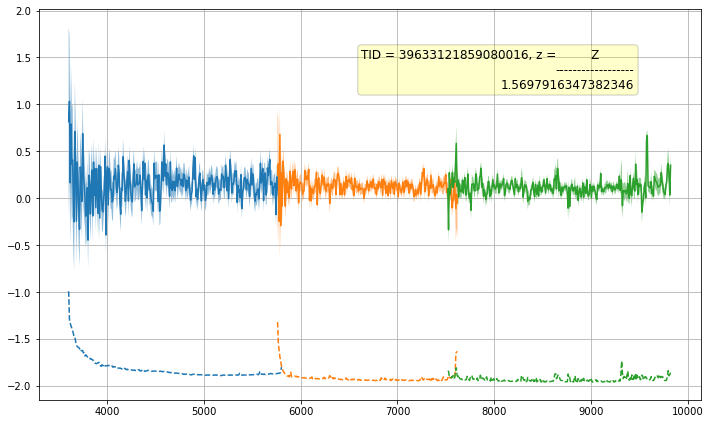

TARGETID=39633121859080088
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121859080088         0        273 ... 60256.45965609 60256.45965609


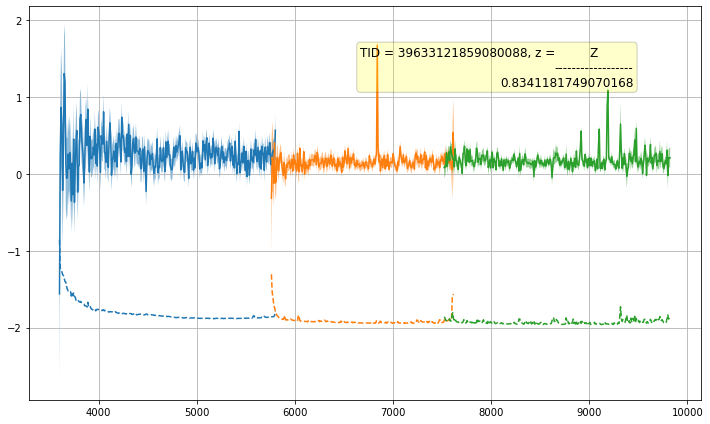

TARGETID=39633121863270705
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863270705         0        222 ... 60256.45965609 60256.45965609


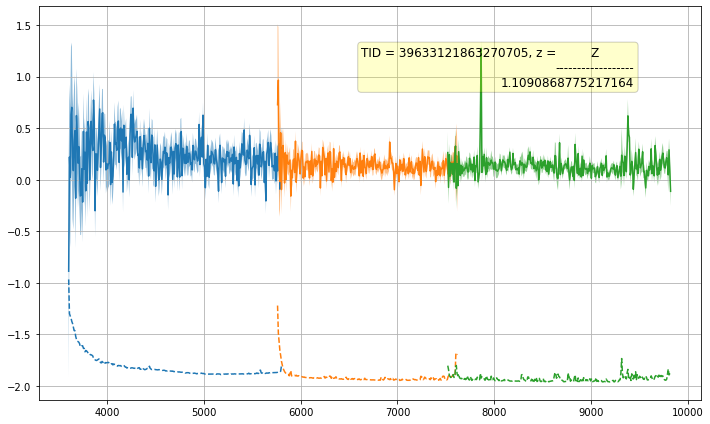

TARGETID=39633121863270800
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863270800         0        238 ... 60256.45965609 60256.45965609


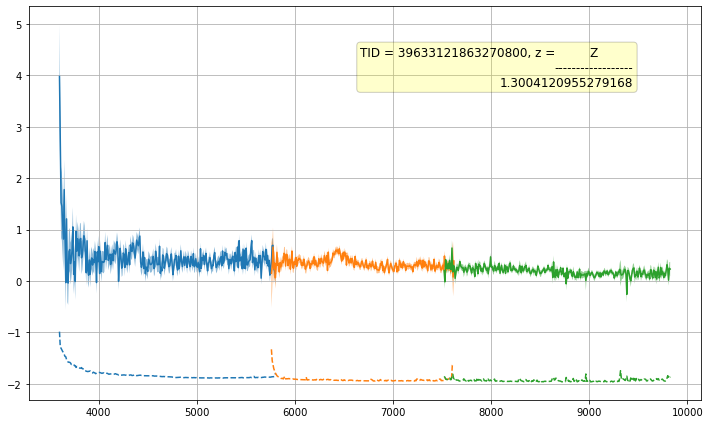

TARGETID=39633121863271110
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271110         0        191 ... 60256.45965609 60256.45965609


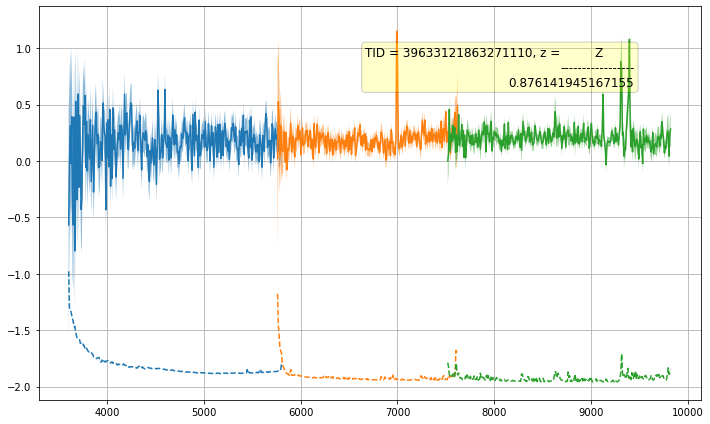

TARGETID=39633121863271129
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271129         0        255 ... 60256.45965609 60256.45965609


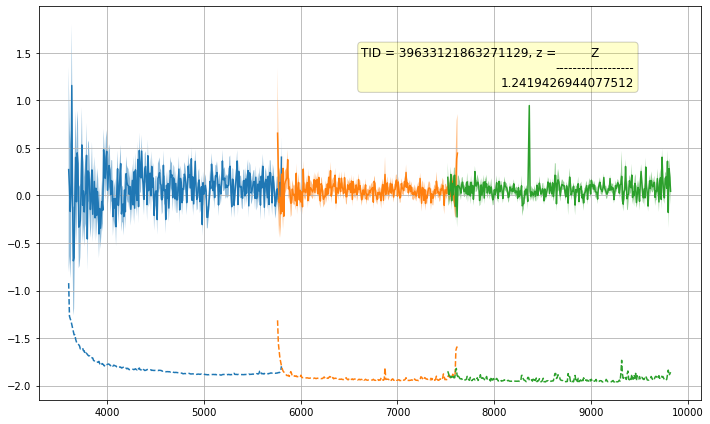

TARGETID=39633121863271142
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271142         0        221 ... 60256.45965609 60256.45965609


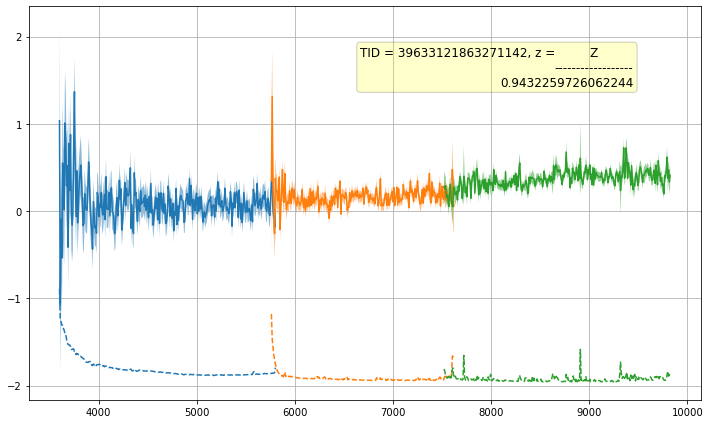

TARGETID=39633121863271363
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271363         0        176 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


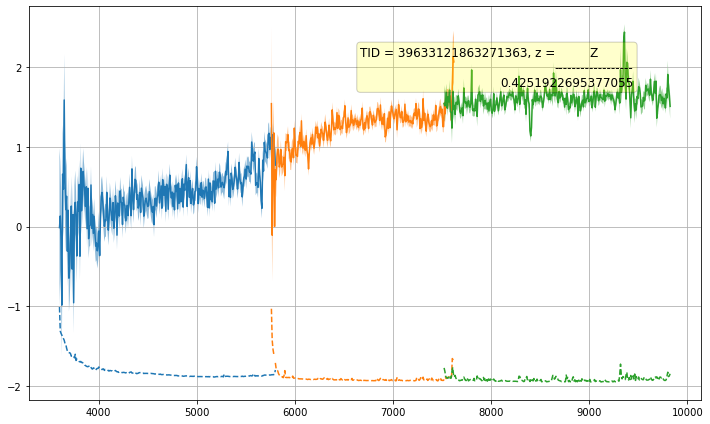

TARGETID=39633121863271502
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271502         0        272 ... 60256.45965609 60256.45965609


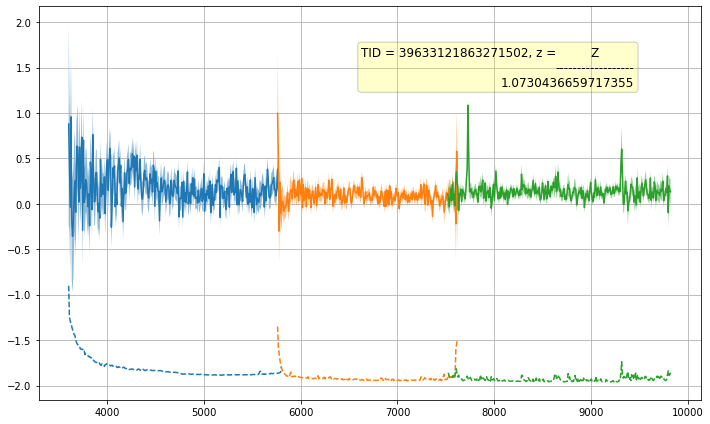

TARGETID=39633121863271510
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271510         0        190 ... 60256.45965609 60256.45965609


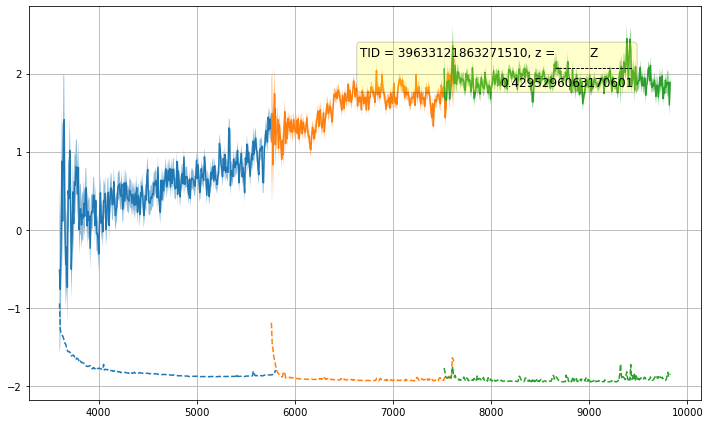

TARGETID=39633121863271666
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271666         0        254 ... 60256.45965609 60256.45965609


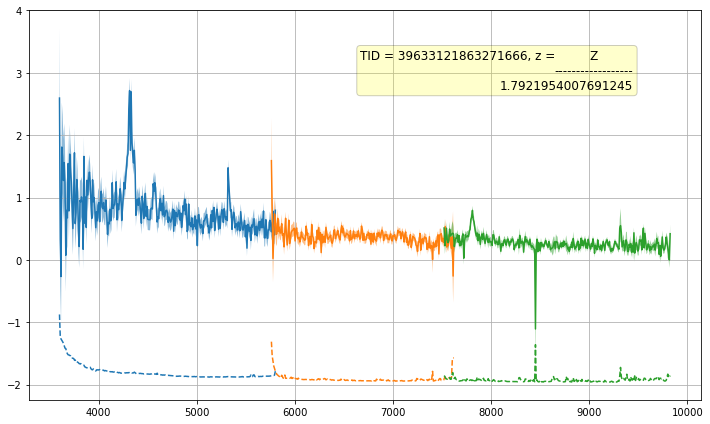

TARGETID=39633121863271911
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271911         0        271 ... 60256.45965609 60256.45965609


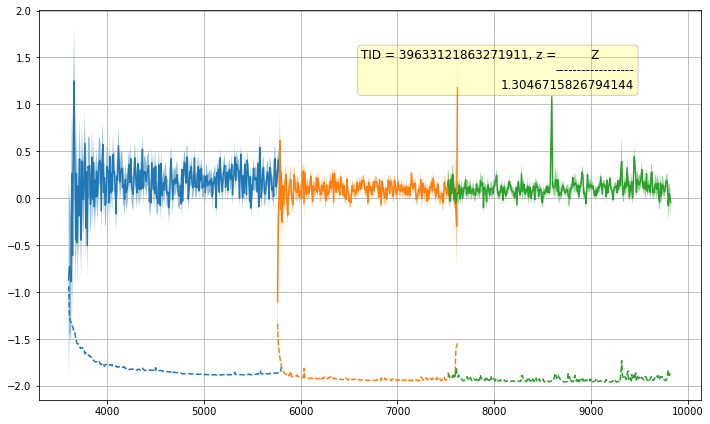

TARGETID=39633121863271957
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271957         0        175 ... 60256.45965609 60256.45965609


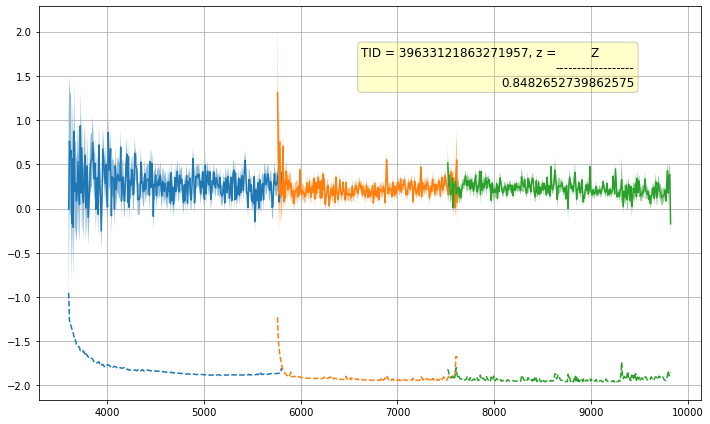

TARGETID=39633121863271958
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271958         0        220 ... 60256.45965609 60256.45965609


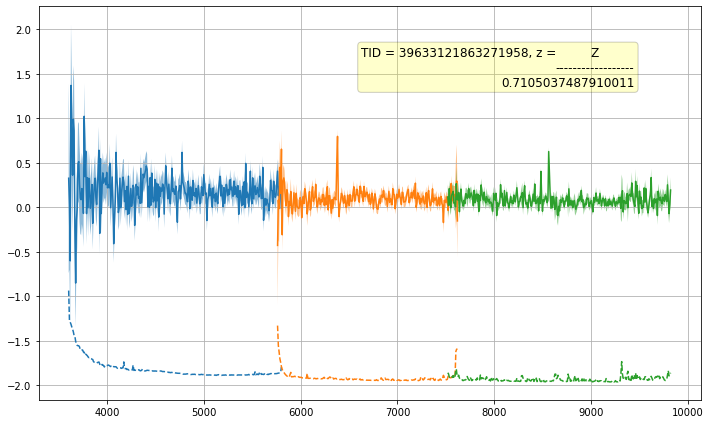

TARGETID=39633121863271973
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863271973         0        205 ... 60256.45965609 60256.45965609


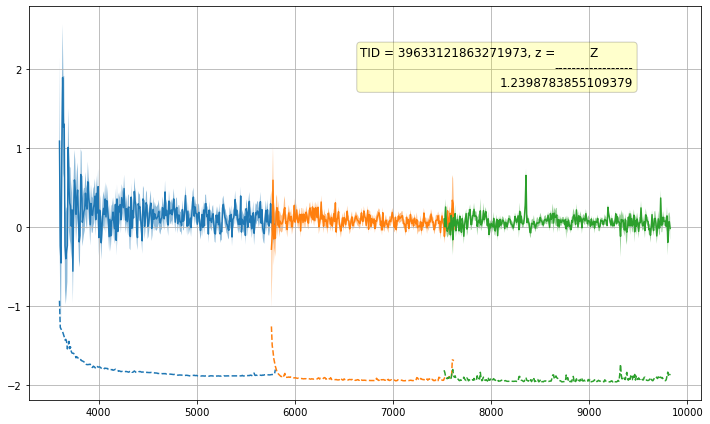

TARGETID=39633121863272105
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863272105         0        236 ... 60256.45965609 60256.45965609


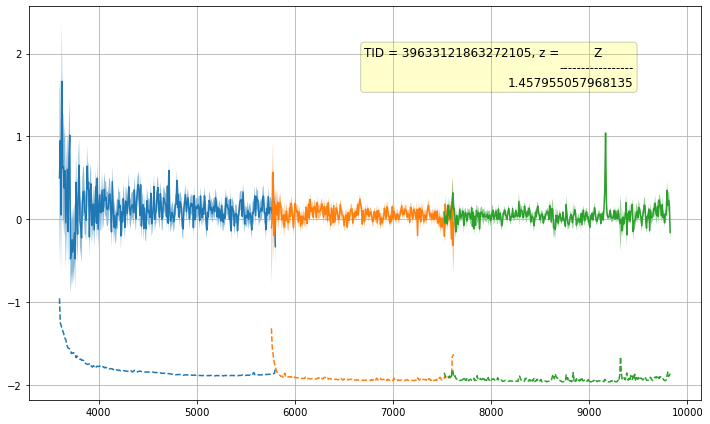

TARGETID=39633121863272320
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863272320         0        204 ... 60256.45965609 60256.45965609


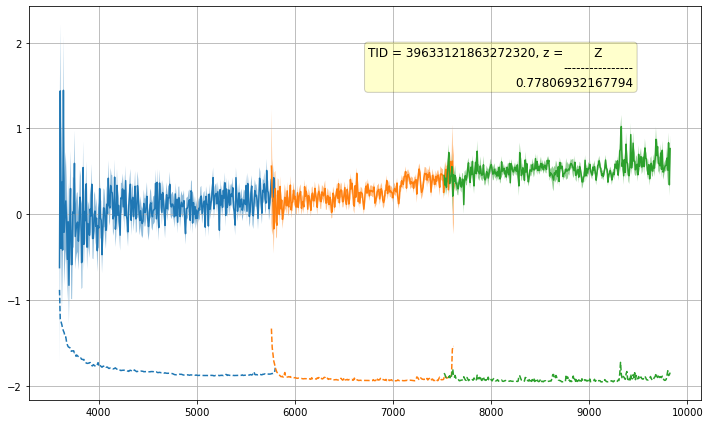

TARGETID=39633121863272423
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863272423         0        189 ... 60256.45965609 60256.45965609


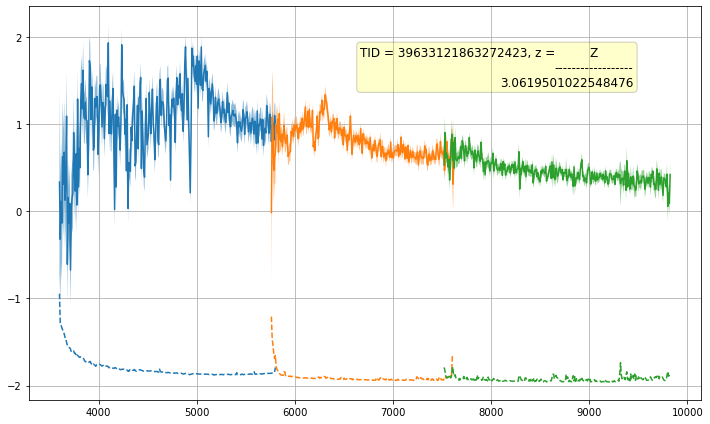

TARGETID=39633121863272668
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863272668         0        252 ... 60256.45965609 60256.45965609


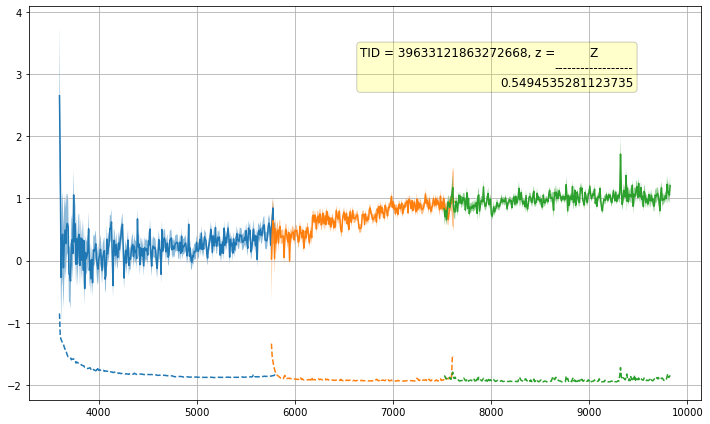

TARGETID=39633121863272677
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863272677         0        235 ... 60256.45965609 60256.45965609


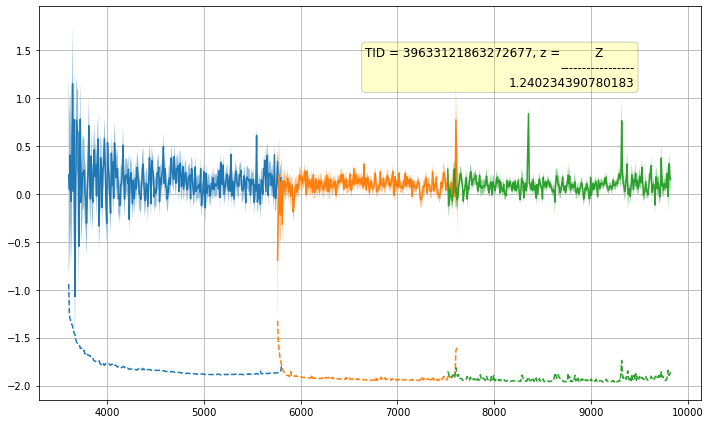

TARGETID=39633121863272760
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863272760         0        203 ... 60256.45965609 60256.45965609


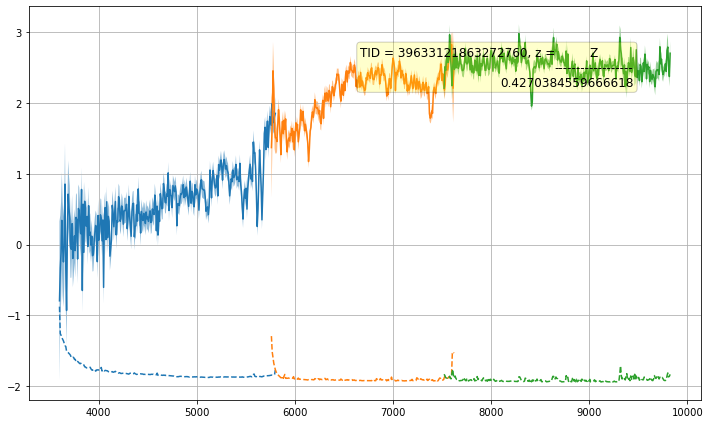

TARGETID=39633121863272884
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863272884         0        188 ... 60256.45965609 60256.45965609


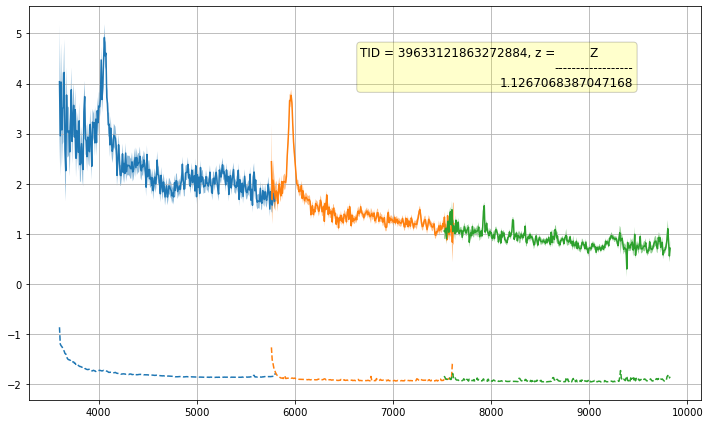

TARGETID=39633121863273083
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863273083         0        218 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


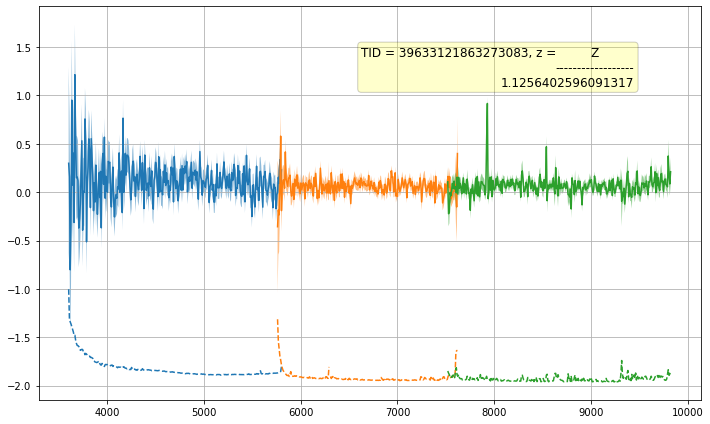

TARGETID=39633121863273459
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863273459         0        234 ... 60256.45965609 60256.45965609


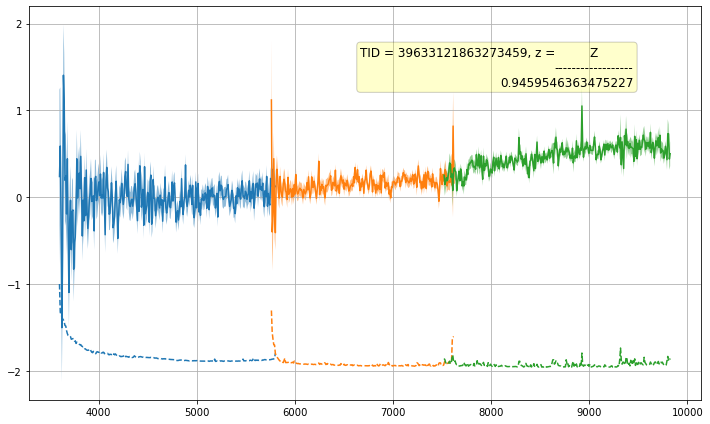

TARGETID=39633121863273579
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863273579         0        251 ... 60256.45965609 60256.45965609


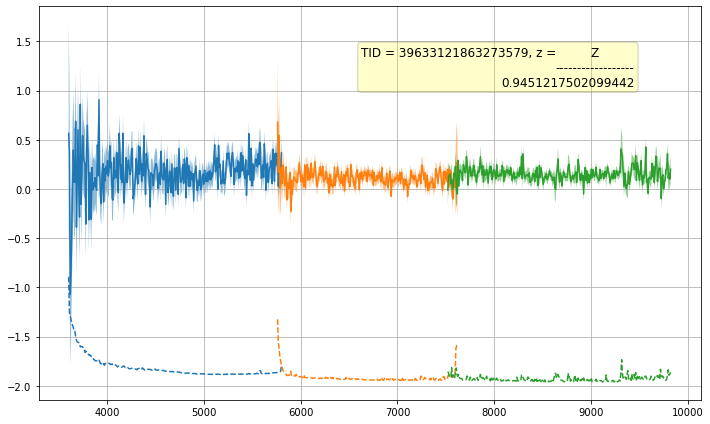

TARGETID=39633121863273734
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863273734         0        187 ... 60256.45965609 60256.45965609


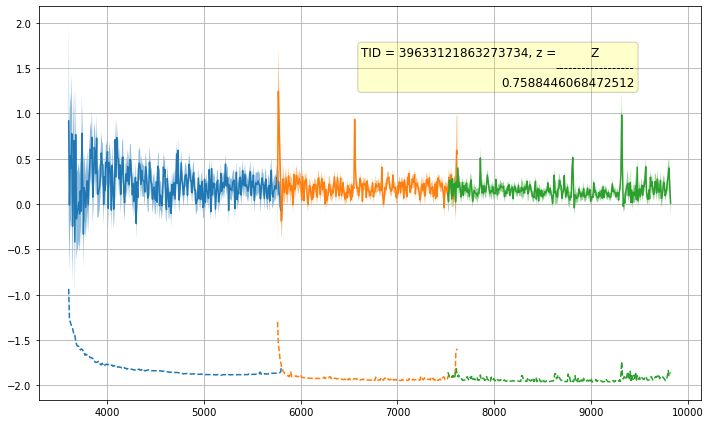

TARGETID=39633121863273863
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863273863         0        186 ... 60256.45965609 60256.45965609


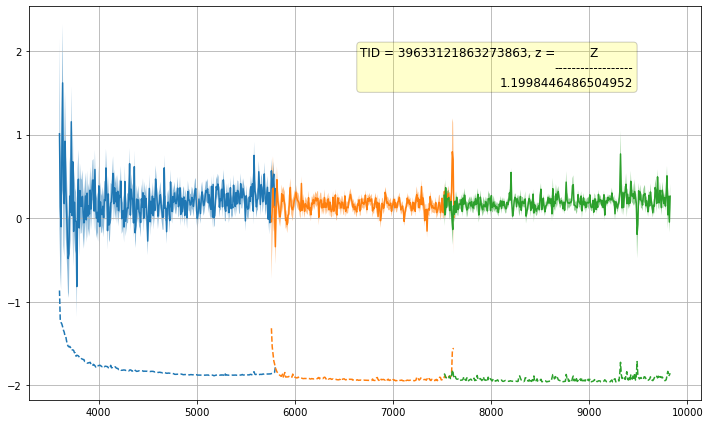

TARGETID=39633121863273990
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863273990         0        172 ... 60256.45965609 60256.45965609


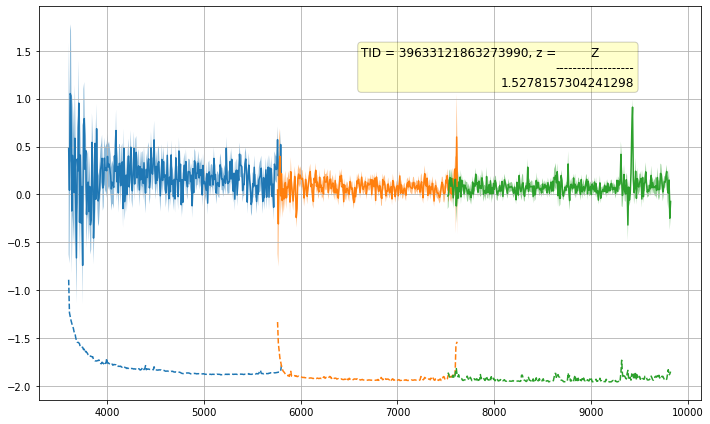

TARGETID=39633121863274000
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863274000         0        233 ... 60256.45965609 60256.45965609


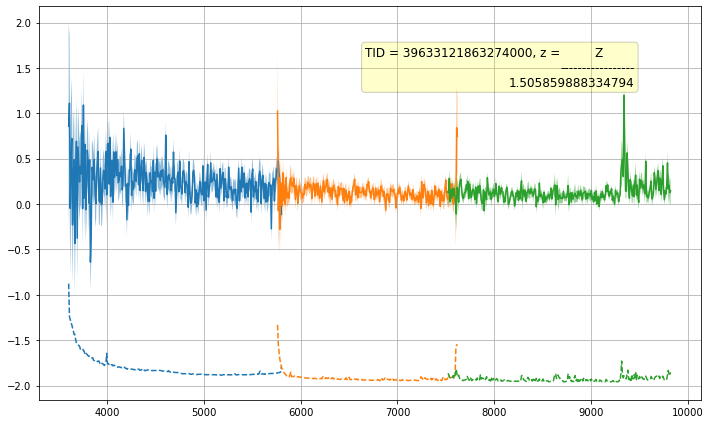

TARGETID=39633121863274049
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121863274049         0        157 ... 60256.45965609 60256.45965609


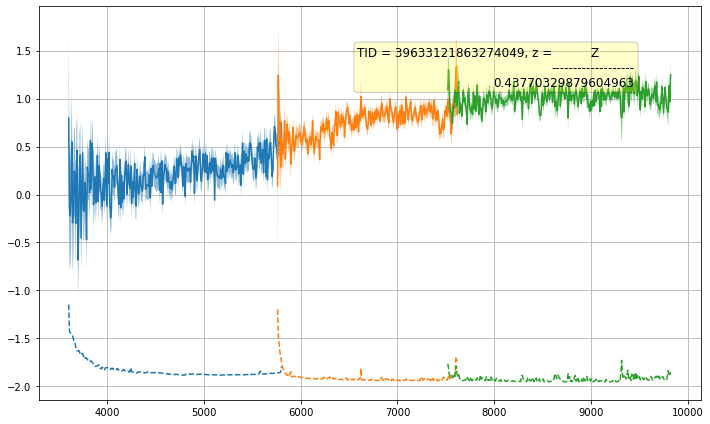

TARGETID=39633121867464803
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867464803         0        232 ... 60256.45965609 60256.45965609


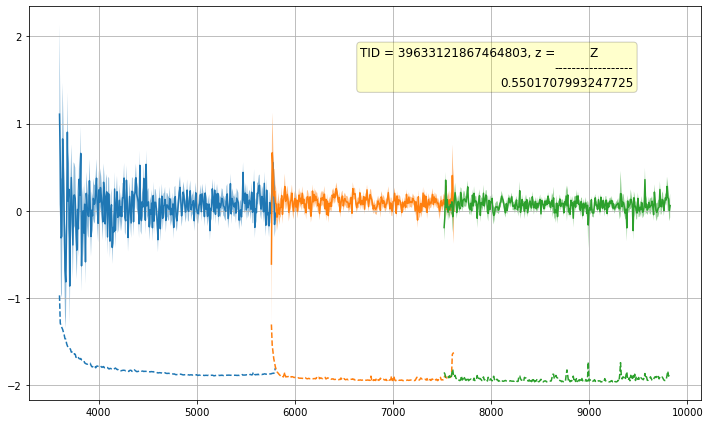

TARGETID=39633121867464961
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867464961         0        185 ... 60256.45965609 60256.45965609


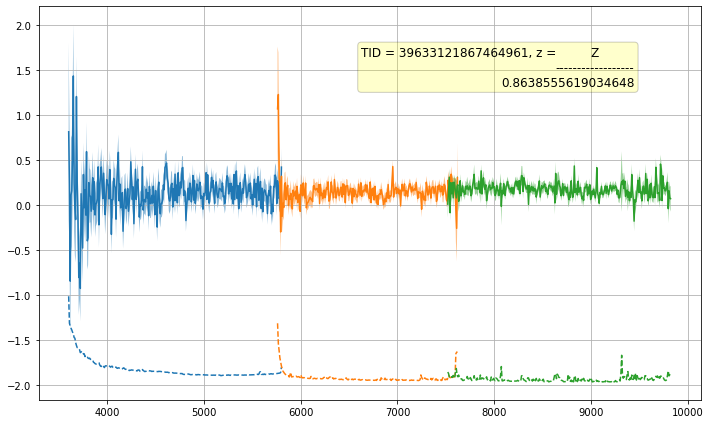

TARGETID=39633121867465021
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867465021         0        216 ... 60256.45965609 60256.45965609


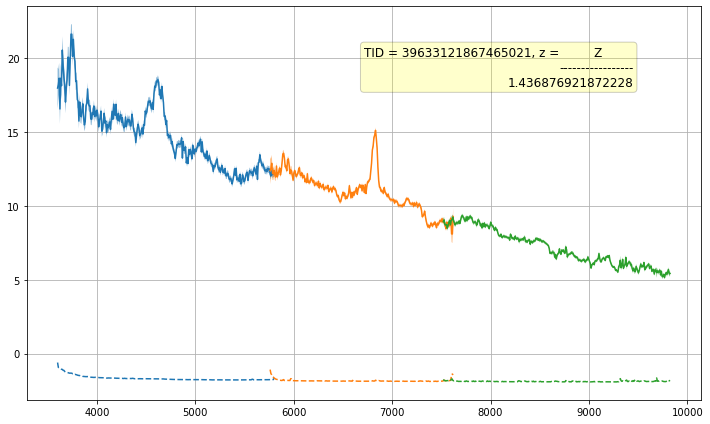

TARGETID=39633121867465285
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867465285         0        156 ... 60256.45965609 60256.45965609


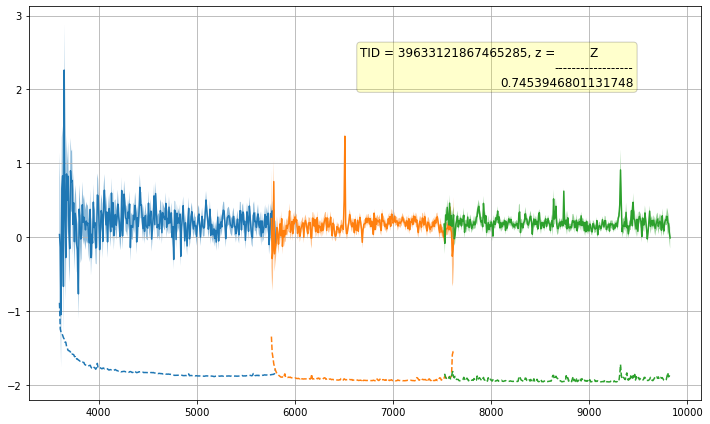

TARGETID=39633121867465328
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867465328         0        215 ... 60256.45965609 60256.45965609


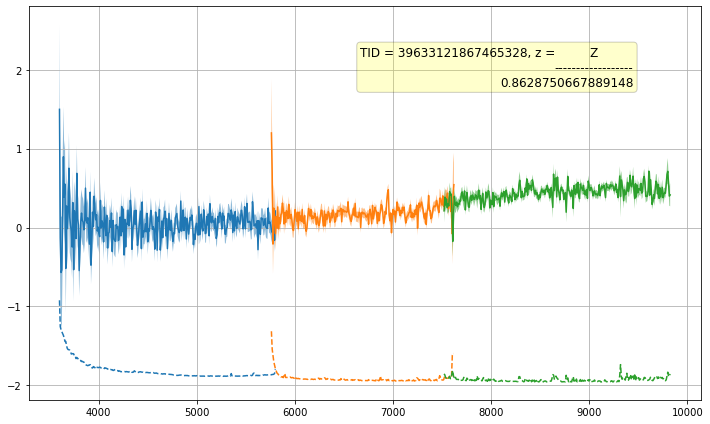

TARGETID=39633121867465540
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867465540         0        231 ... 60256.45965609 60256.45965609


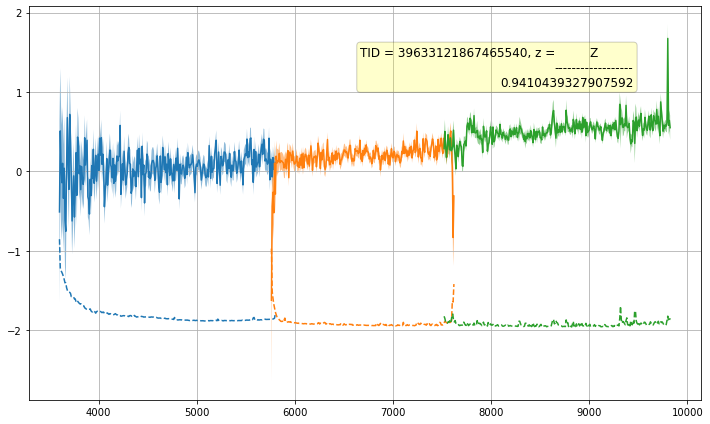

TARGETID=39633121867465584
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867465584         0        200 ... 60256.45965609 60256.45965609


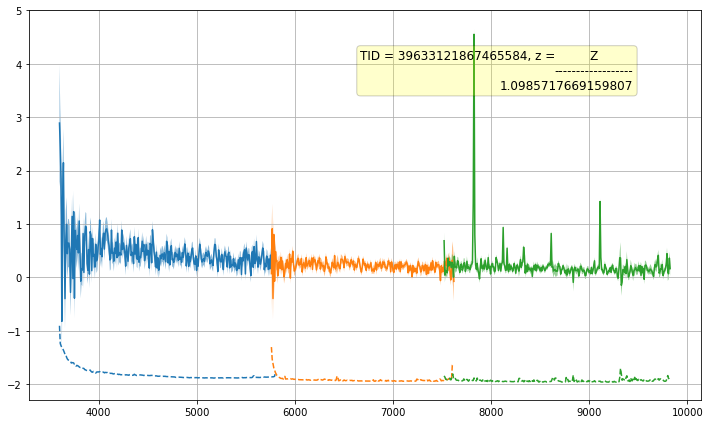

TARGETID=39633121867465804
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867465804         0        155 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,
/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


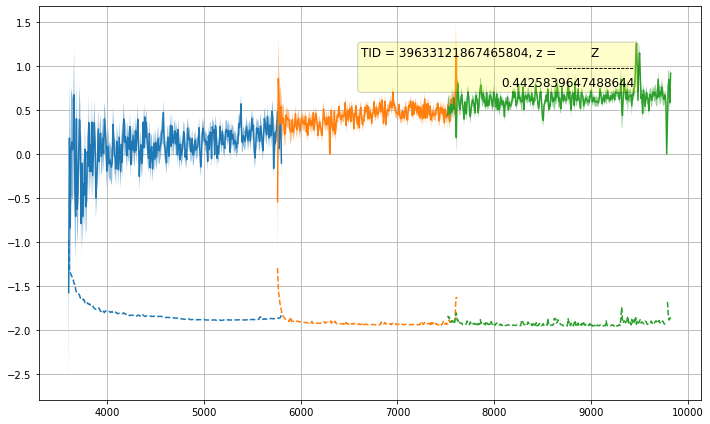

TARGETID=39633121867466025
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867466025         0        199 ... 60256.45965609 60256.45965609


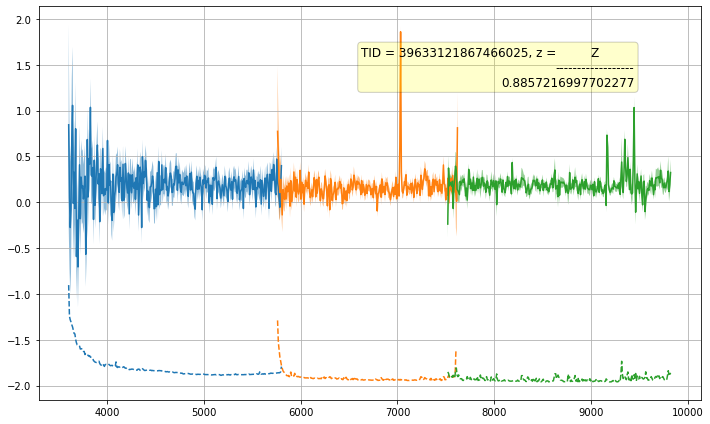

TARGETID=39633121867466383
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867466383         0        214 ... 60256.45965609 60256.45965609


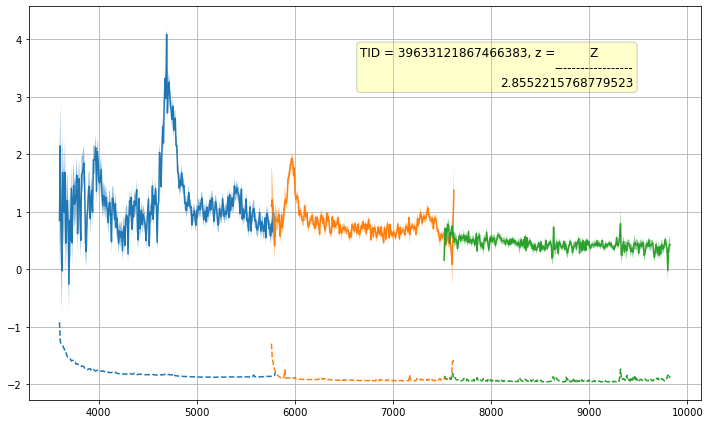

TARGETID=39633121867466410
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867466410         0        183 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


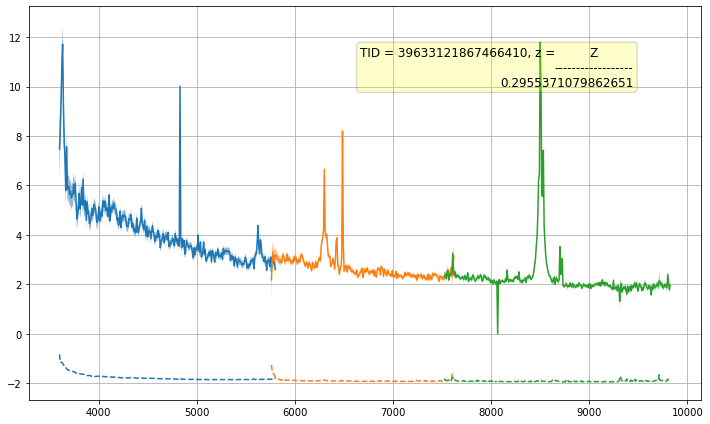

TARGETID=39633121867466454
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867466454         0        169 ... 60256.45965609 60256.45965609


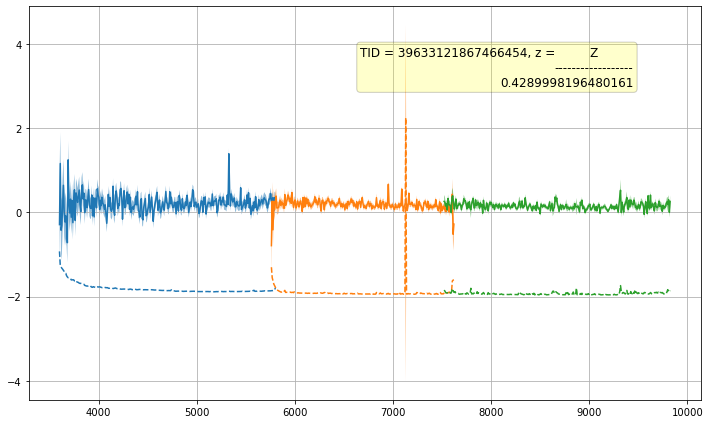

TARGETID=39633121867466573
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867466573         0        198 ... 60256.45965609 60256.45965609


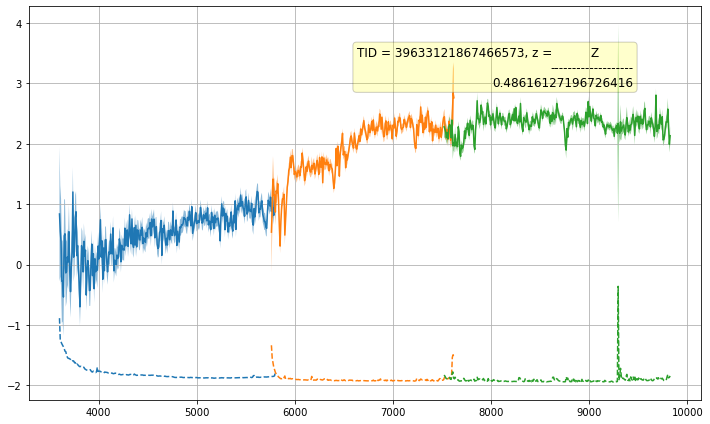

TARGETID=39633121867466688
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867466688         0        141 ... 60256.45965609 60256.45965609


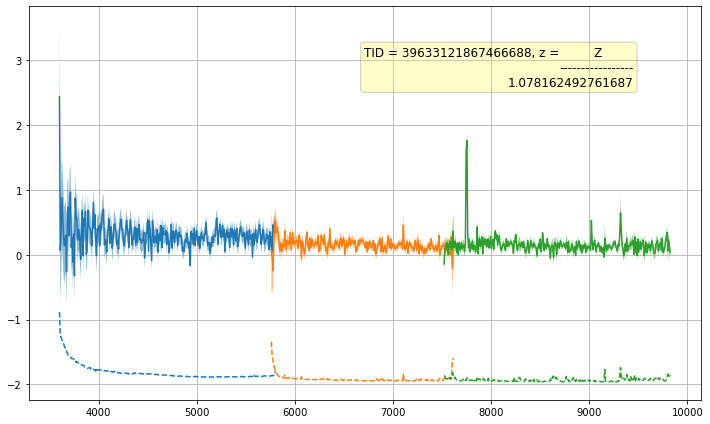

TARGETID=39633121867467036
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467036         0        213 ... 60256.45965609 60256.45965609


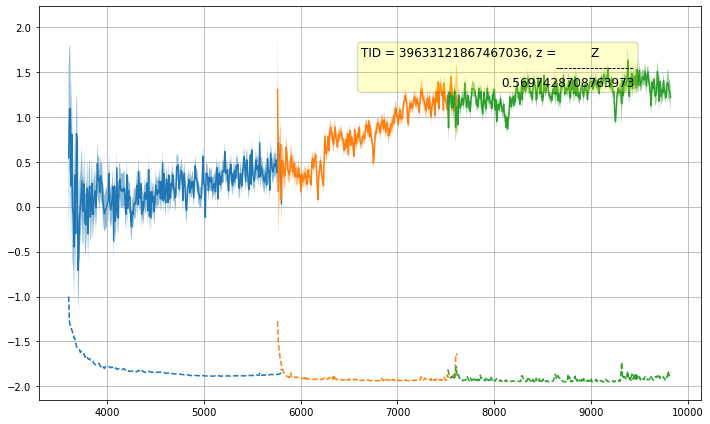

TARGETID=39633121867467110
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467110         0        168 ... 60256.45965609 60256.45965609


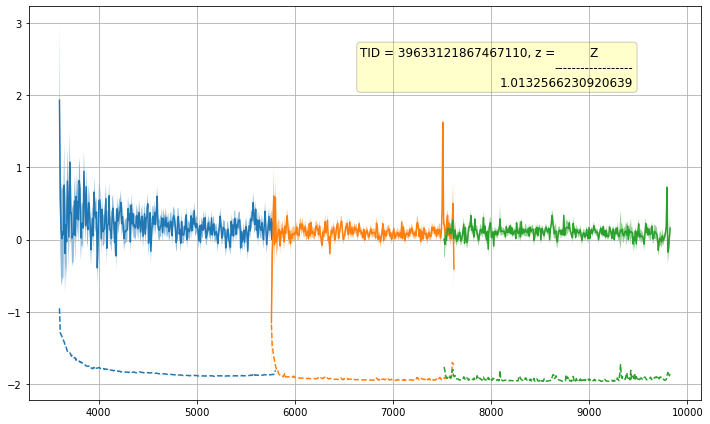

TARGETID=39633121867467143
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467143         0        154 ... 60256.45965609 60256.45965609


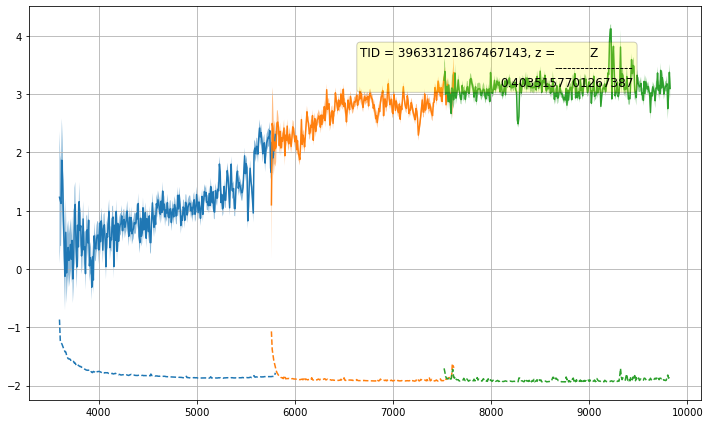

TARGETID=39633121867467209
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467209         0        182 ... 60256.45965609 60256.45965609


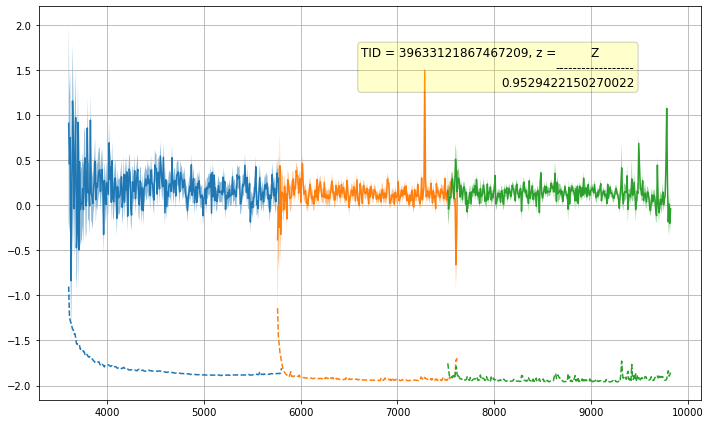

TARGETID=39633121867467290
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467290         0        229 ... 60256.45965609 60256.45965609


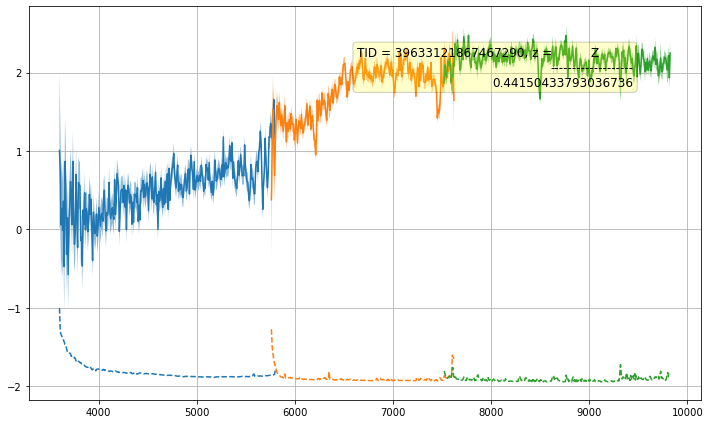

TARGETID=39633121867467491
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467491         0        212 ... 60256.45965609 60256.45965609


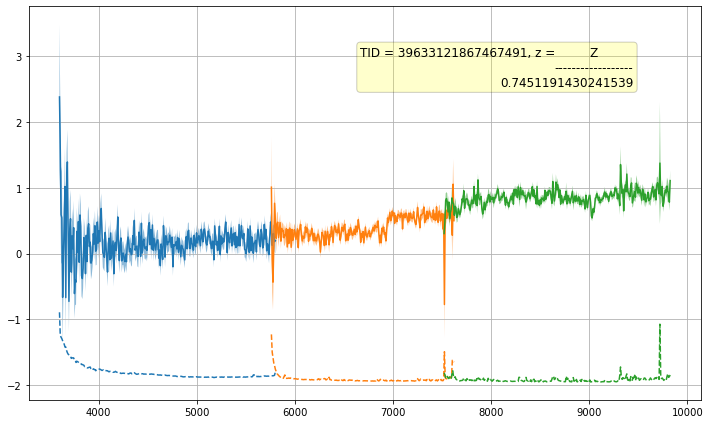

TARGETID=39633121867467520
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467520         0        197 ... 60256.45965609 60256.45965609


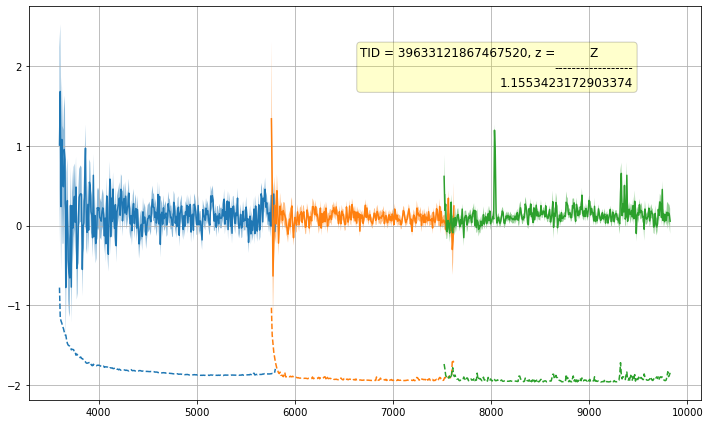

TARGETID=39633121867467712
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467712         0        181 ... 60256.45965609 60256.45965609


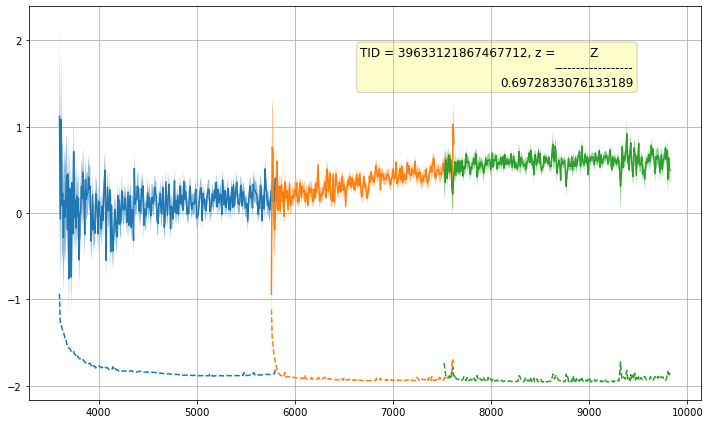

TARGETID=39633121867467794
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467794         0        153 ... 60256.45965609 60256.45965609


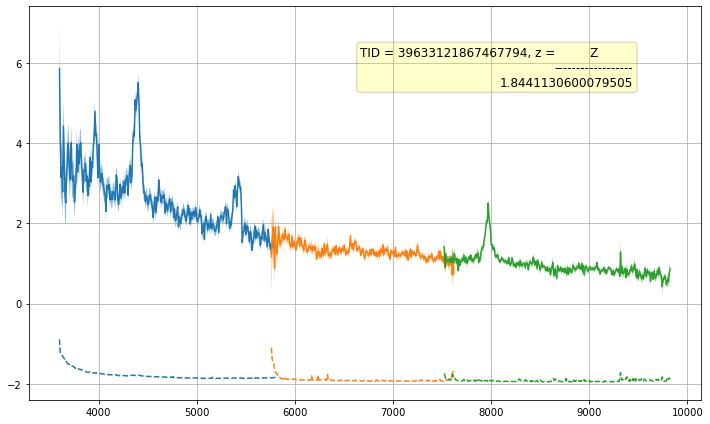

TARGETID=39633121867467985
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867467985         0        228 ... 60256.45965609 60256.45965609


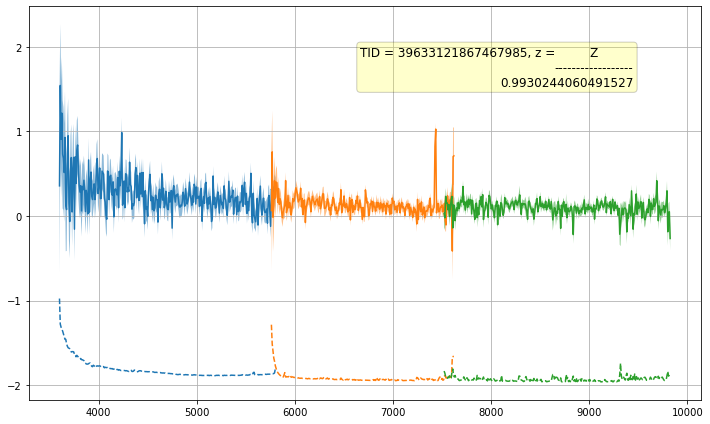

TARGETID=39633121867468401
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867468401         0        126 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


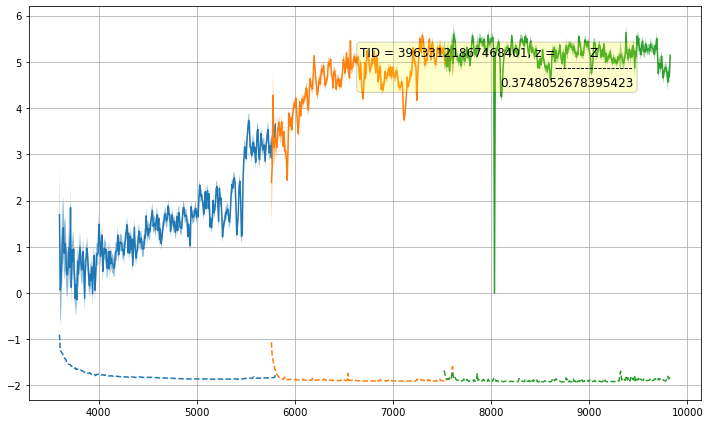

TARGETID=39633121867468415
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867468415         0        152 ... 60256.45965609 60256.45965609


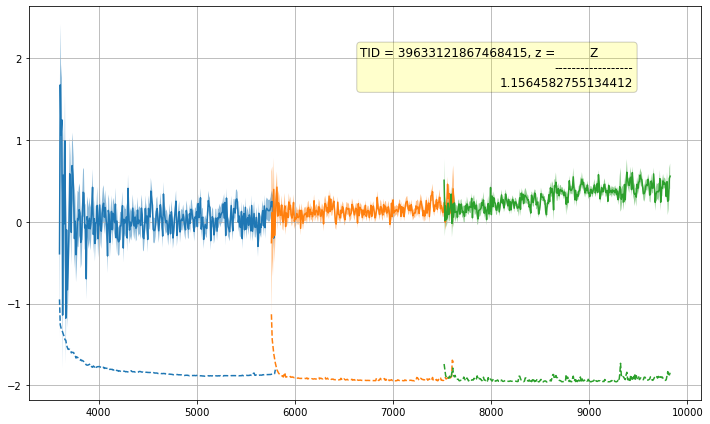

TARGETID=39633121867468418
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867468418         0        196 ... 60256.45965609 60256.45965609


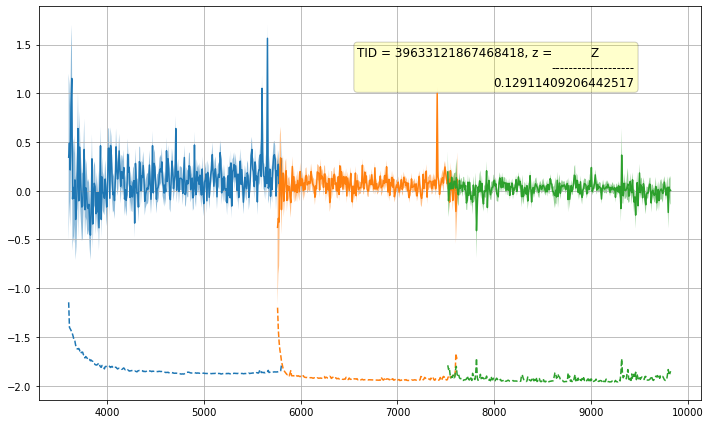

TARGETID=39633121867468673
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867468673         0        195 ... 60256.45965609 60256.45965609


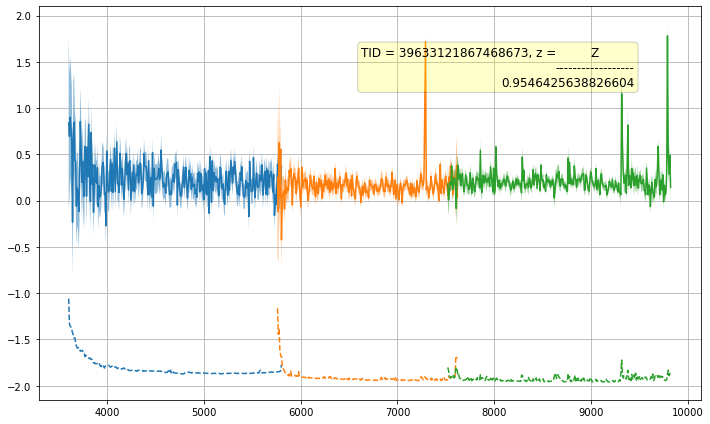

TARGETID=39633121867468831
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121867468831         0        166 ... 60256.45965609 60256.45965609


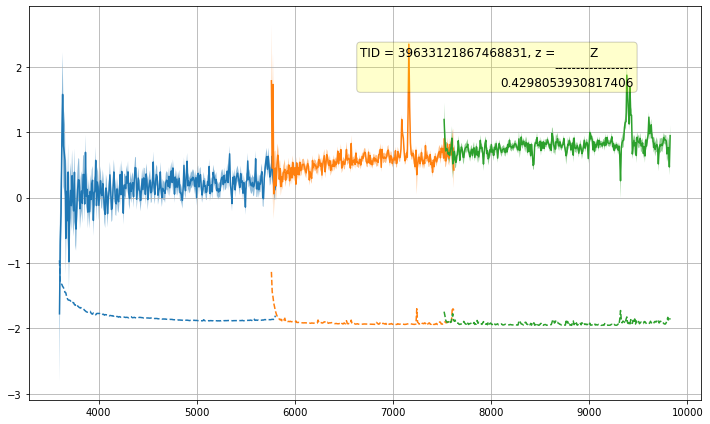

TARGETID=39633121871659095
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659095         0        165 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


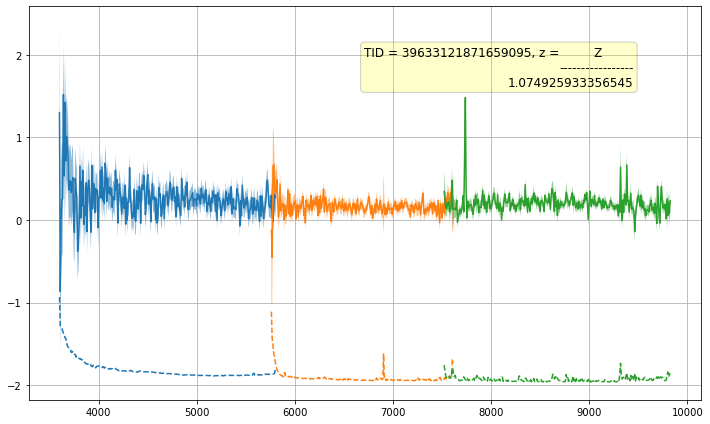

TARGETID=39633121871659124
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659124         0        138 ... 60256.45965609 60256.45965609


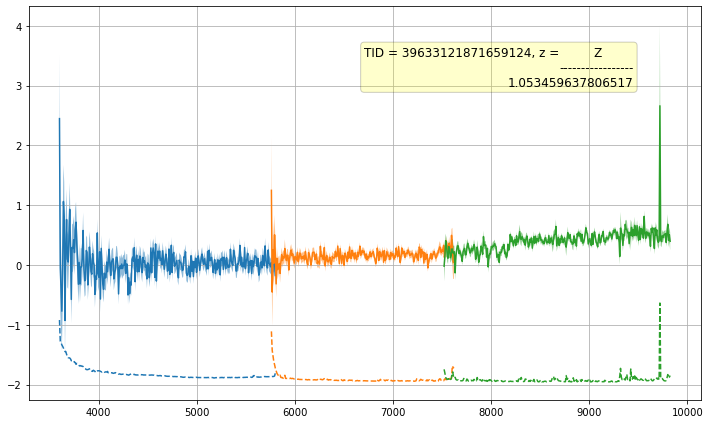

TARGETID=39633121871659212
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659212         0        151 ... 60256.45965609 60256.45965609


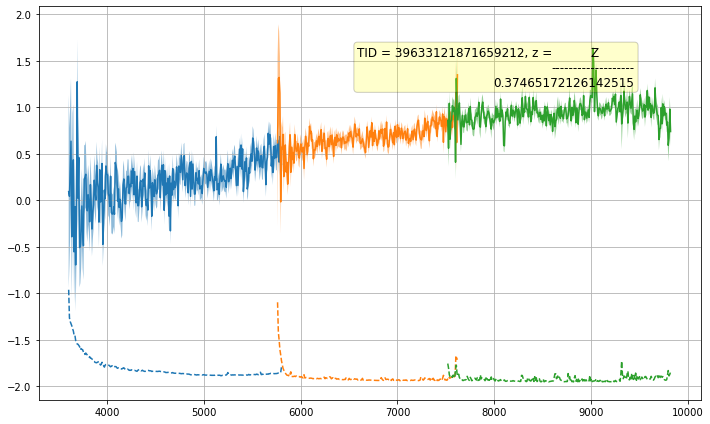

TARGETID=39633121871659483
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659483         0        210 ... 60256.45965609 60256.45965609


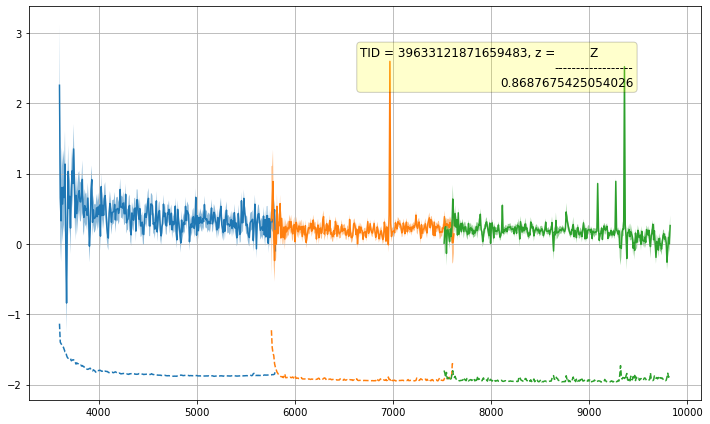

TARGETID=39633121871659541
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659541         0        125 ... 60256.45965609 60256.45965609


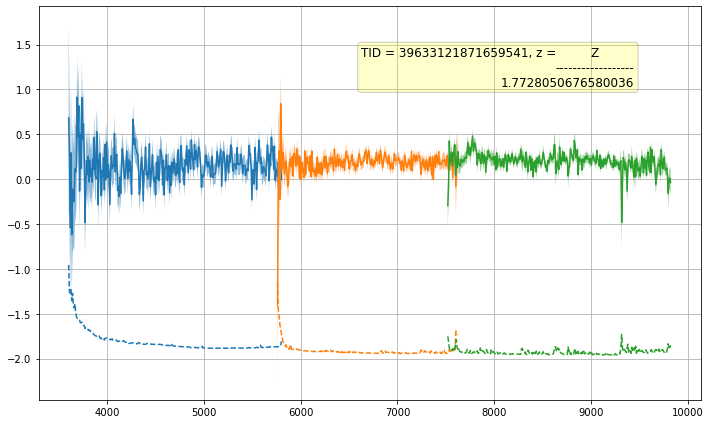

TARGETID=39633121871659571
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659571         0        137 ... 60256.45965609 60256.45965609


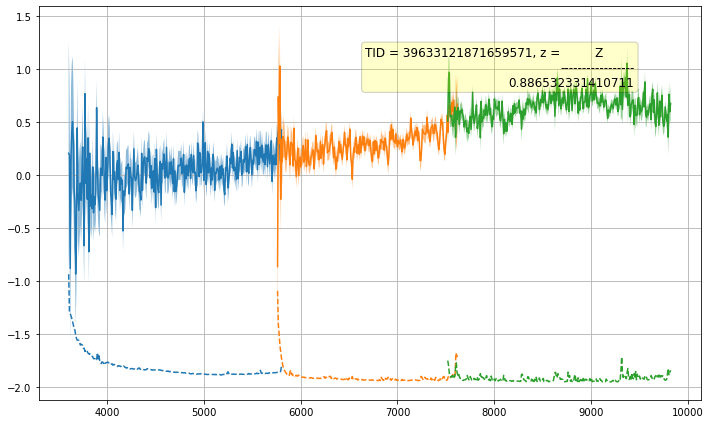

TARGETID=39633121871659625
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659625         0        179 ... 60256.45965609 60256.45965609


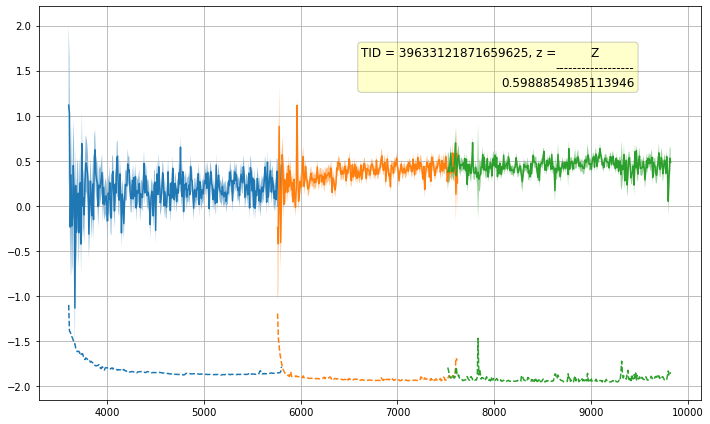

TARGETID=39633121871659740
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659740         0        194 ... 60256.45965609 60256.45965609


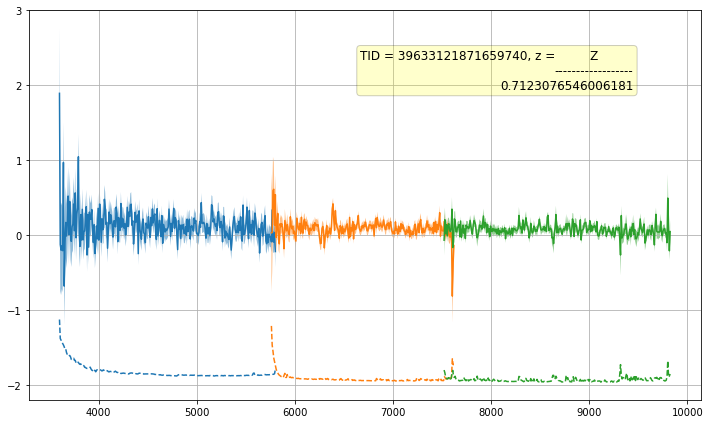

TARGETID=39633121871659879
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659879         0        124 ... 60256.45965609 60256.45965609


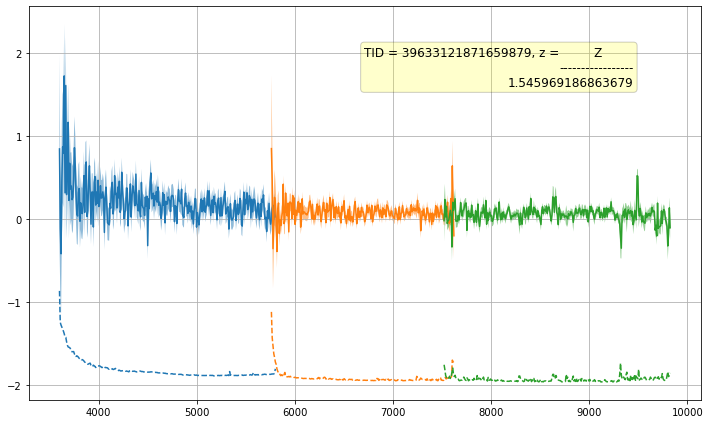

TARGETID=39633121871659934
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659934         0        209 ... 60256.45965609 60256.45965609


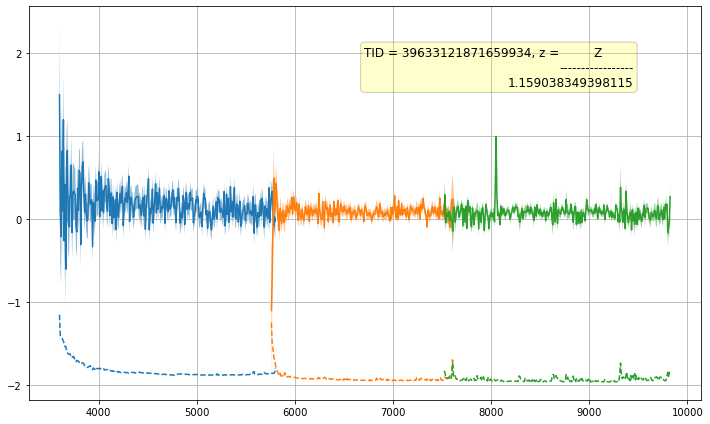

TARGETID=39633121871659942
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871659942         0        178 ... 60256.45965609 60256.45965609


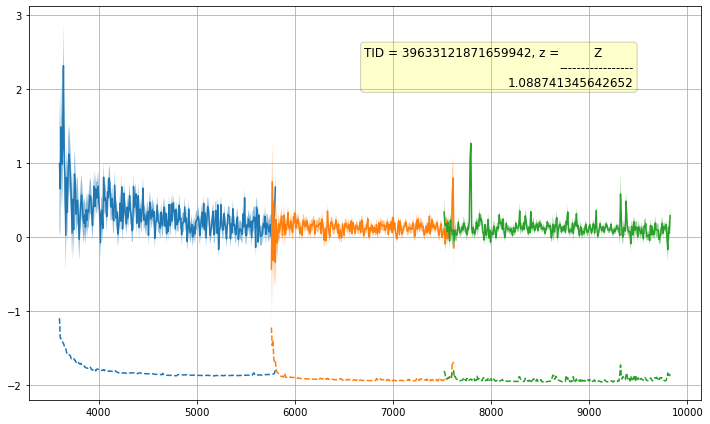

TARGETID=39633121871660302
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871660302         0        149 ... 60256.45965609 60256.45965609


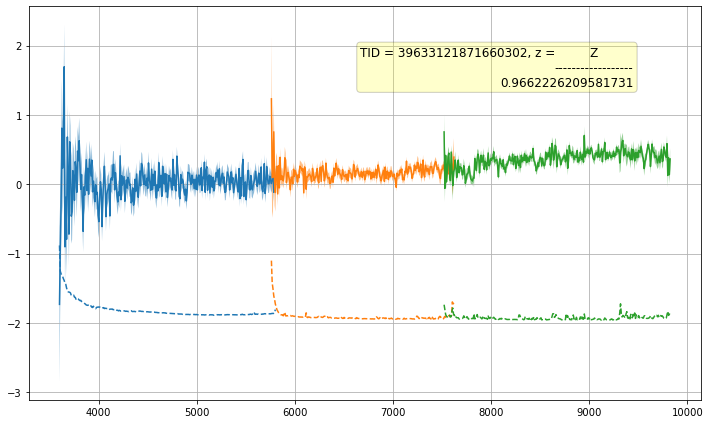

TARGETID=39633121871660308
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871660308         0        136 ... 60256.45965609 60256.45965609


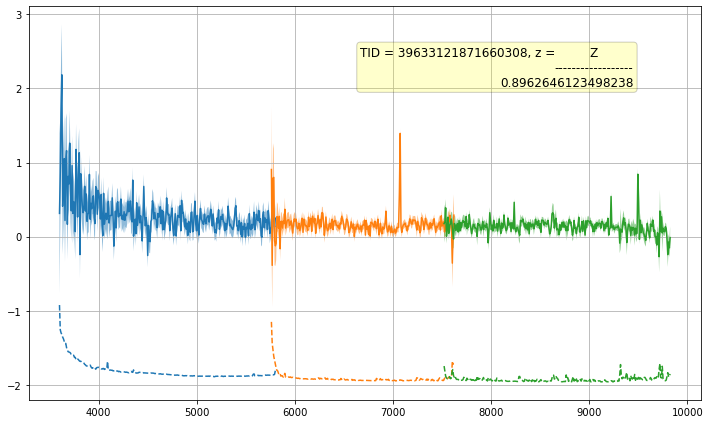

TARGETID=39633121871660561
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871660561         0        177 ... 60256.45965609 60256.45965609


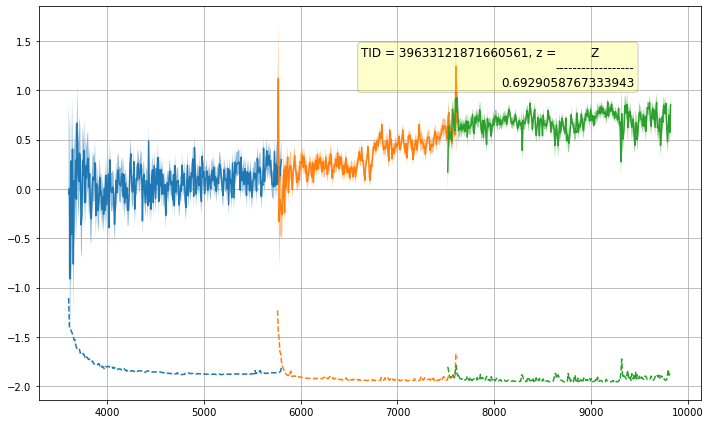

TARGETID=39633121871660616
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871660616         0        193 ... 60256.45965609 60256.45965609


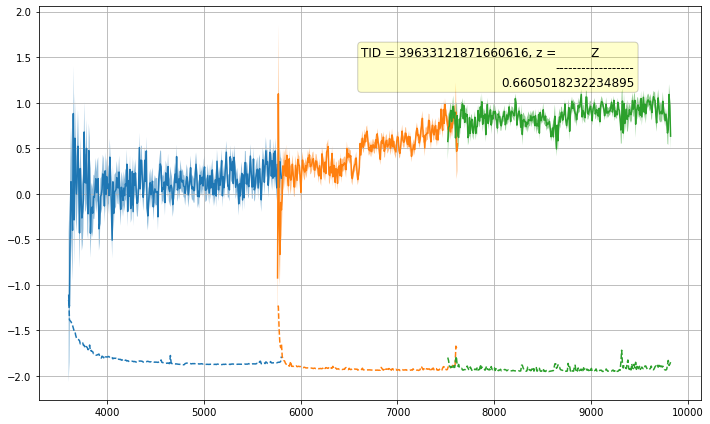

TARGETID=39633121871660629
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871660629         0        208 ... 60256.45965609 60256.45965609


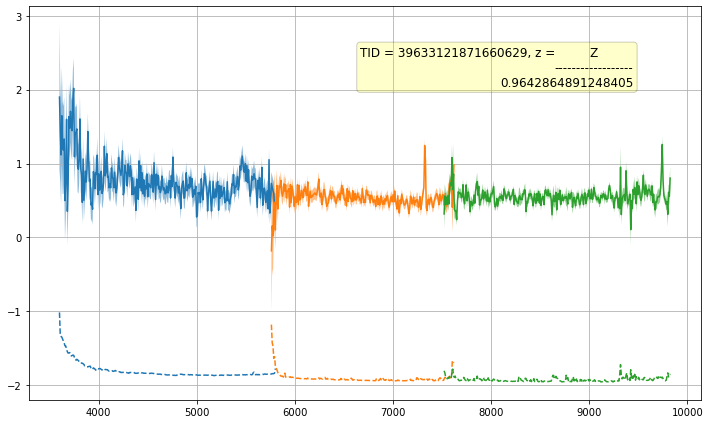

TARGETID=39633121871661029
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871661029         0        192 ... 60256.45965609 60256.45965609


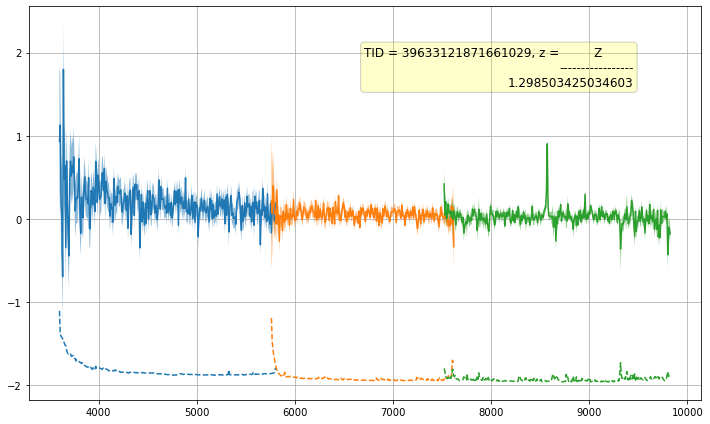

TARGETID=39633121871661436
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633121871661436         0        207 ... 60256.45965609 60256.45965609


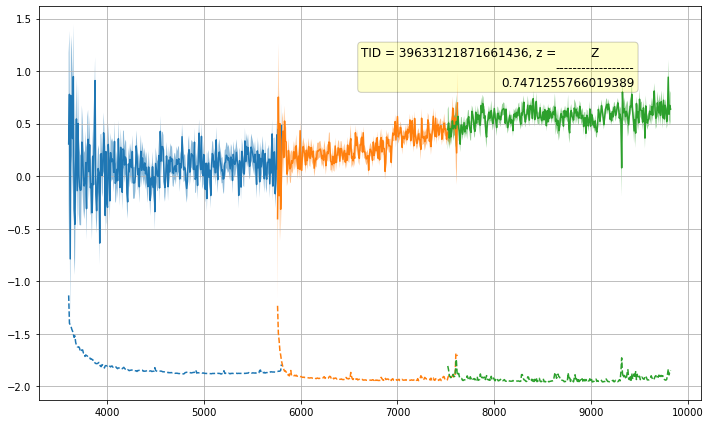

TARGETID=39633126317624526
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126317624526         0        162 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


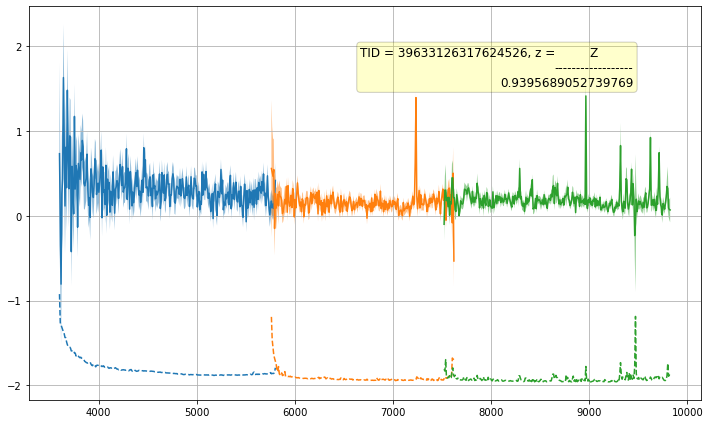

TARGETID=39633126317624582
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126317624582         0        148 ... 60256.45965609 60256.45965609


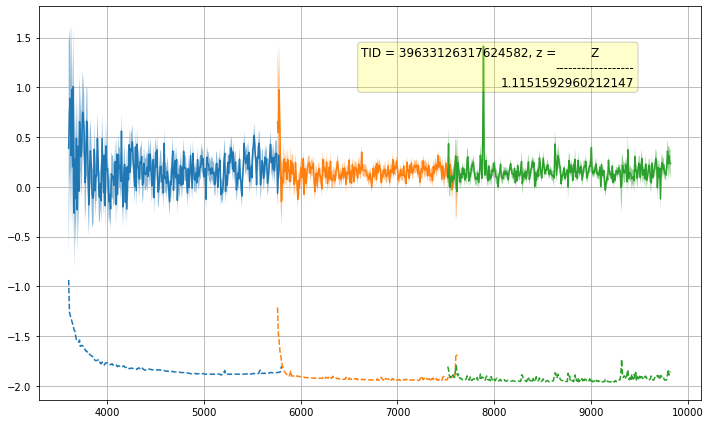

TARGETID=39633126317624977
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126317624977         0        135 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


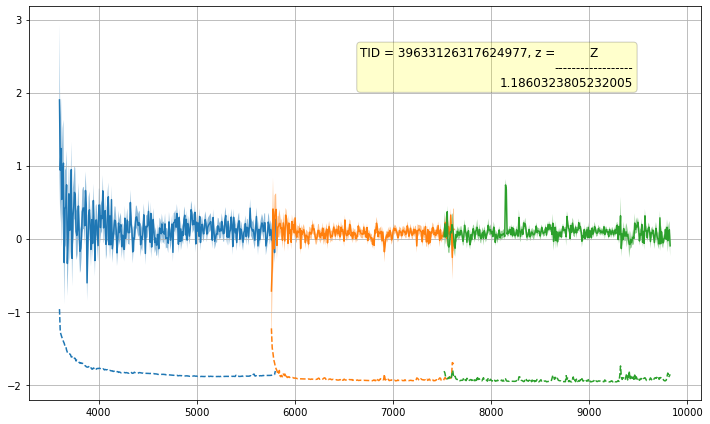

TARGETID=39633126317625121
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126317625121         0        100 ... 60256.45965609 60256.45965609


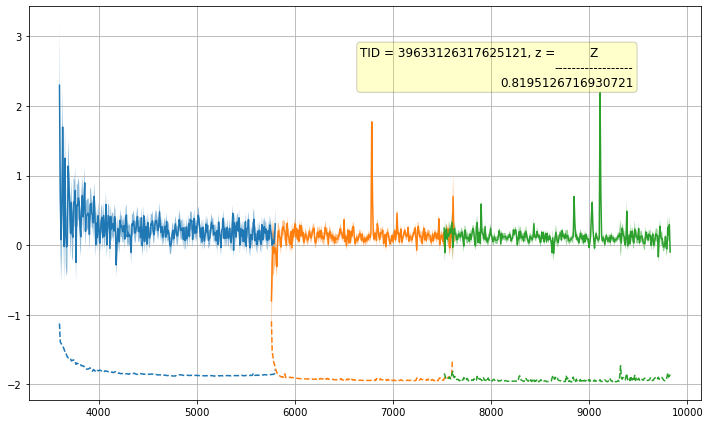

TARGETID=39633126317625187
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126317625187         0        147 ... 60256.45965609 60256.45965609


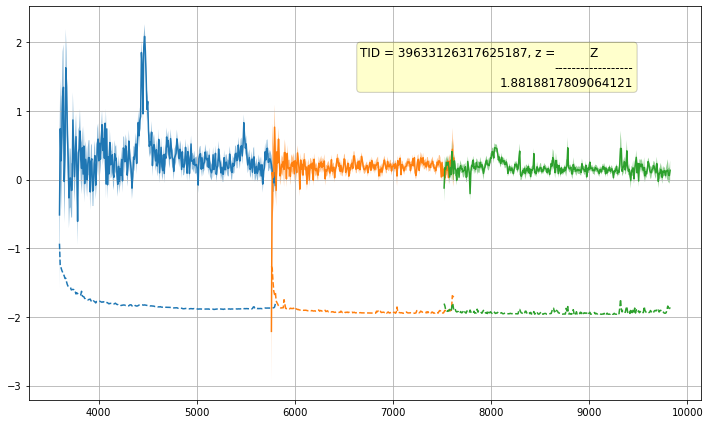

TARGETID=39633126317625396
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126317625396         0        122 ... 60256.45965609 60256.45965609


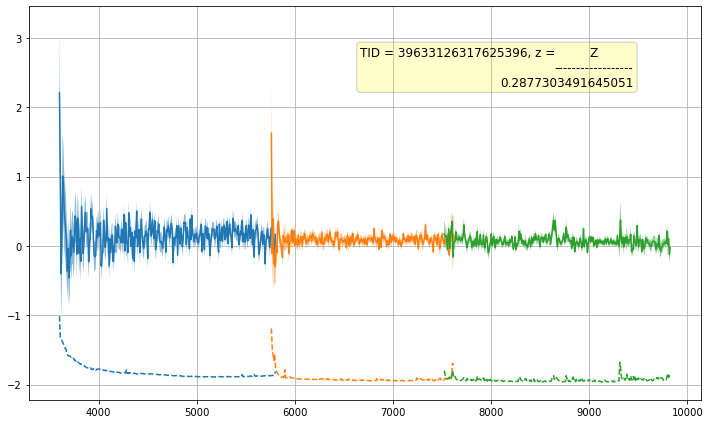

TARGETID=39633126321815687
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321815687         0        111 ... 60256.45965609 60256.45965609


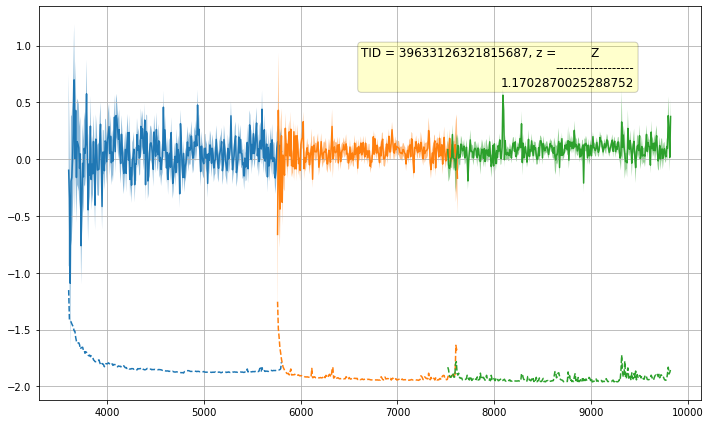

TARGETID=39633126321815722
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321815722         0         89 ... 60256.45965609 60256.45965609


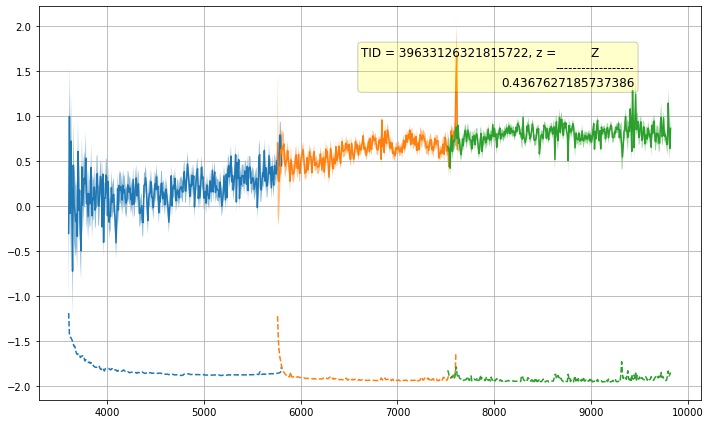

TARGETID=39633126321816154
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321816154         0        146 ... 60256.45965609 60256.45965609


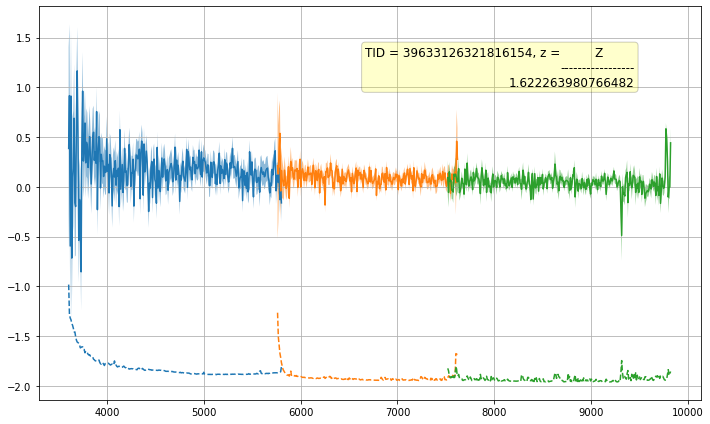

TARGETID=39633126321816180
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321816180         0         88 ... 60256.45965609 60256.45965609


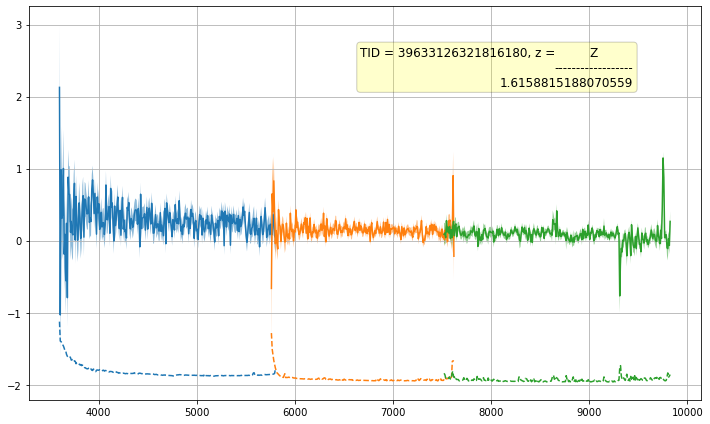

TARGETID=39633126321816203
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321816203         0        134 ... 60256.45965609 60256.45965609


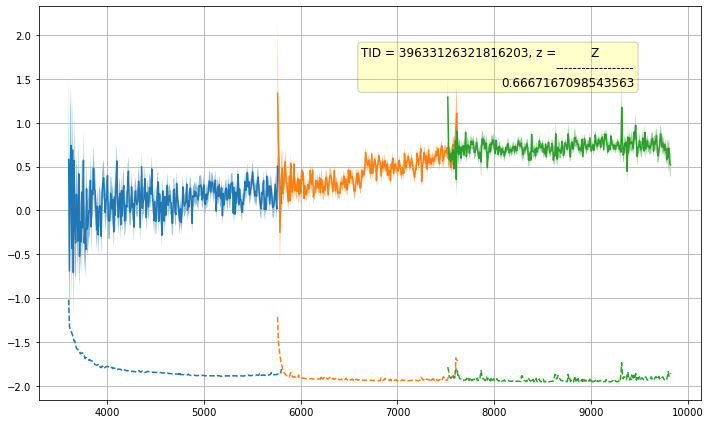

TARGETID=39633126321816405
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321816405         0        121 ... 60256.45965609 60256.45965609


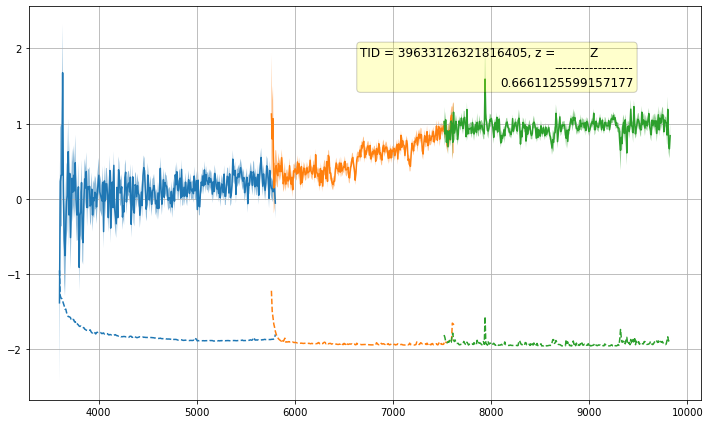

TARGETID=39633126321816480
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321816480         0        159 ... 60256.45965609 60256.45965609


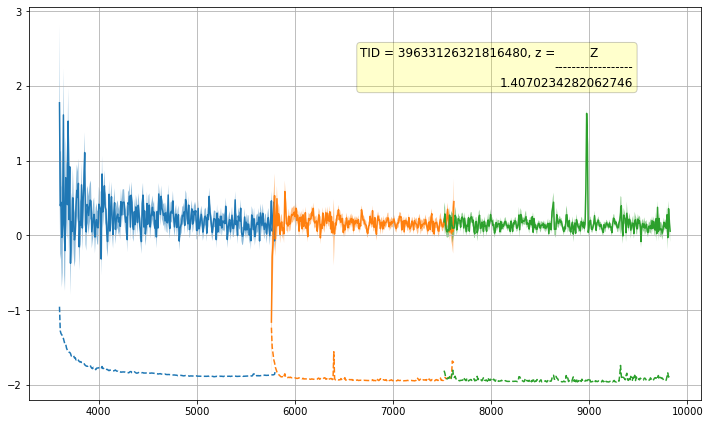

TARGETID=39633126321816677
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321816677         0        133 ... 60256.45965609 60256.45965609


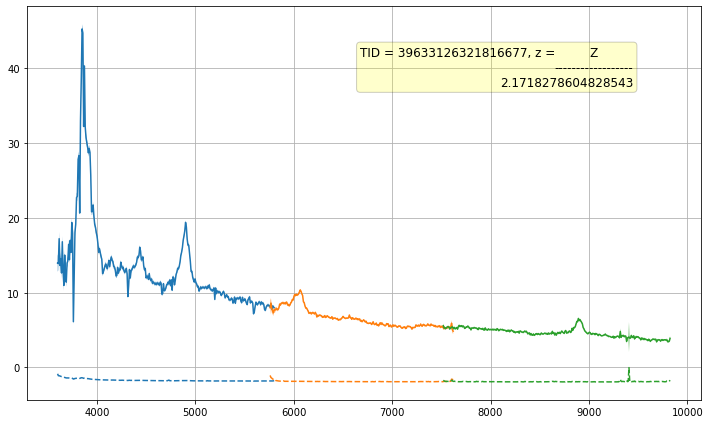

TARGETID=39633126321816696
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321816696         0        109 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


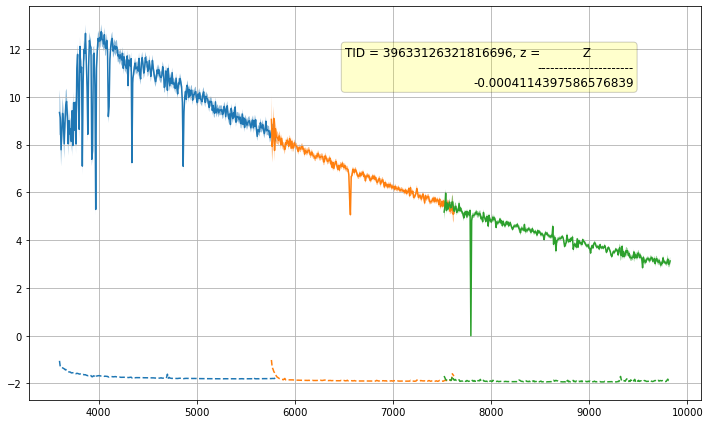

TARGETID=39633126321816861
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321816861         0         98 ... 60256.45965609 60256.45965609


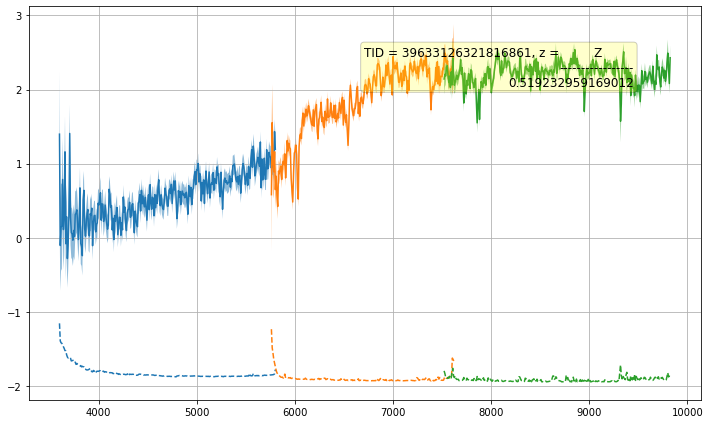

TARGETID=39633126321816910
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321816910         0        120 ... 60256.45965609 60256.45965609


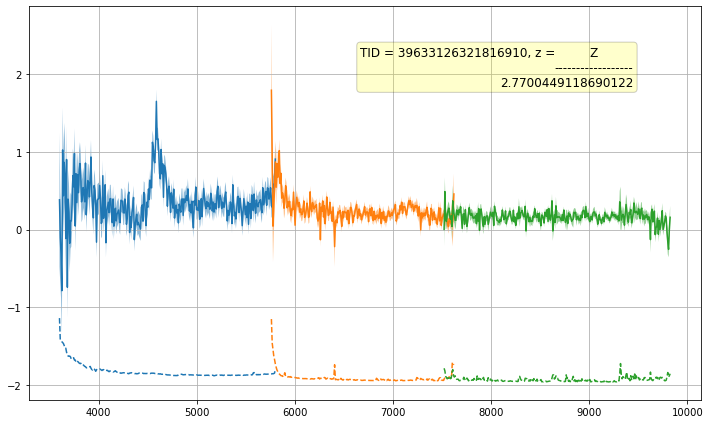

TARGETID=39633126321817294
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321817294         0         97 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


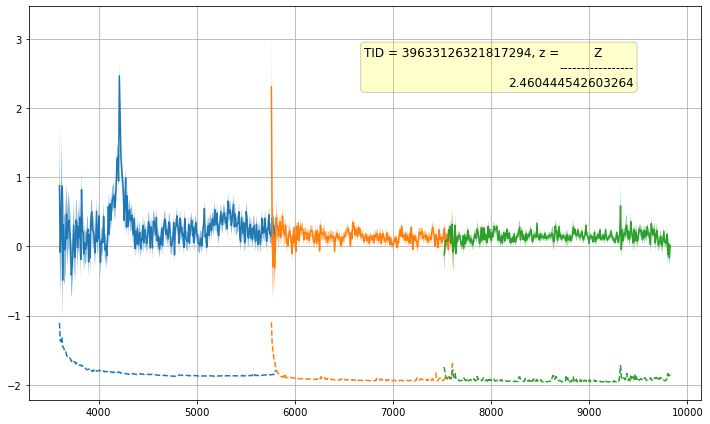

TARGETID=39633126321817324
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321817324         0        132 ... 60256.45965609 60256.45965609


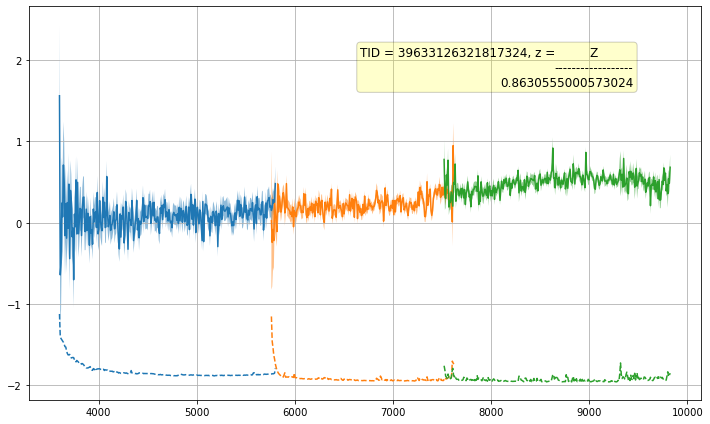

TARGETID=39633126321817388
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321817388         0         77 ... 60256.45965609 60256.45965609


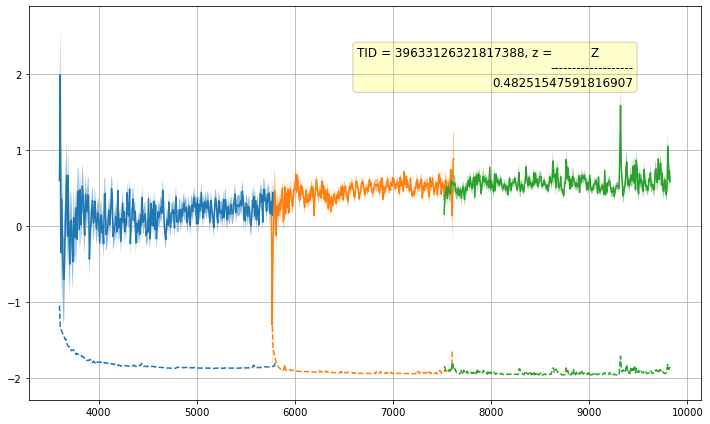

TARGETID=39633126321817543
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321817543         0         86 ... 60256.45965609 60256.45965609


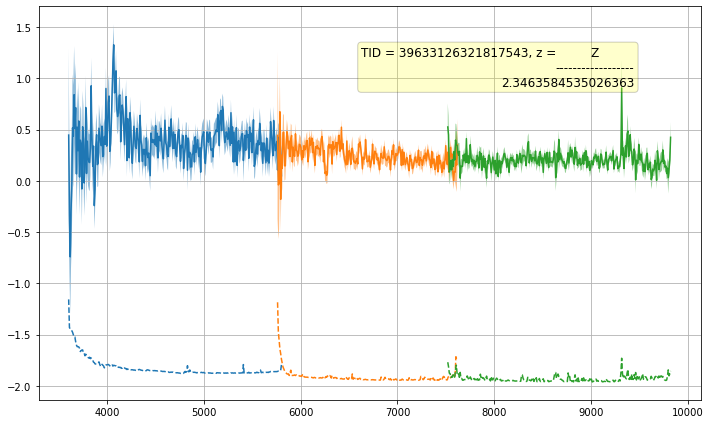

TARGETID=39633126321817590
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321817590         0        108 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


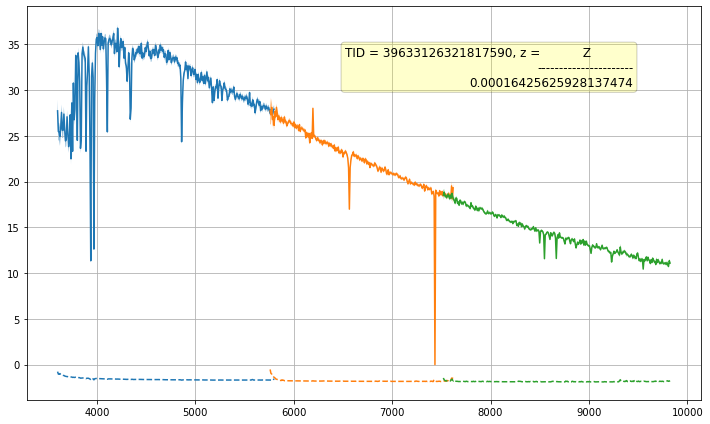

TARGETID=39633126321817638
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321817638         0        144 ... 60256.45965609 60256.45965609


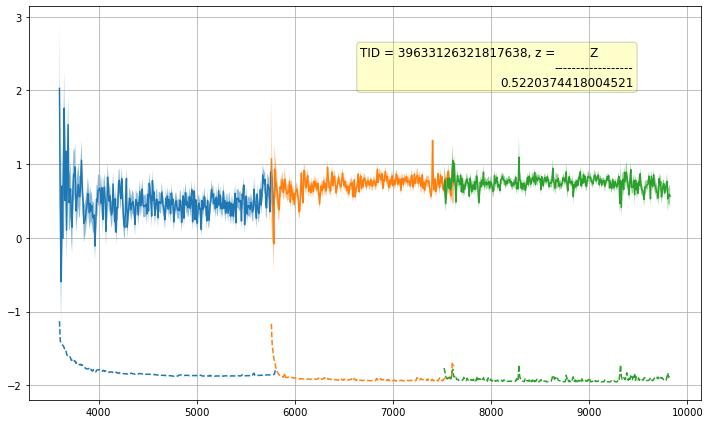

TARGETID=39633126321817879
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321817879         0        143 ... 60256.45965609 60256.45965609


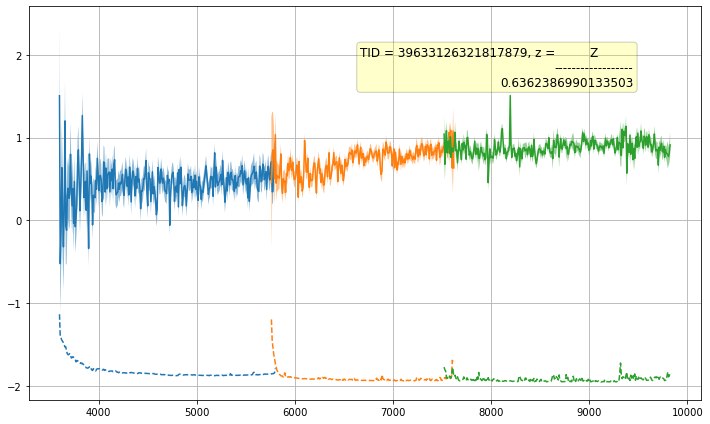

TARGETID=39633126321818255
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321818255         0        131 ... 60256.45965609 60256.45965609


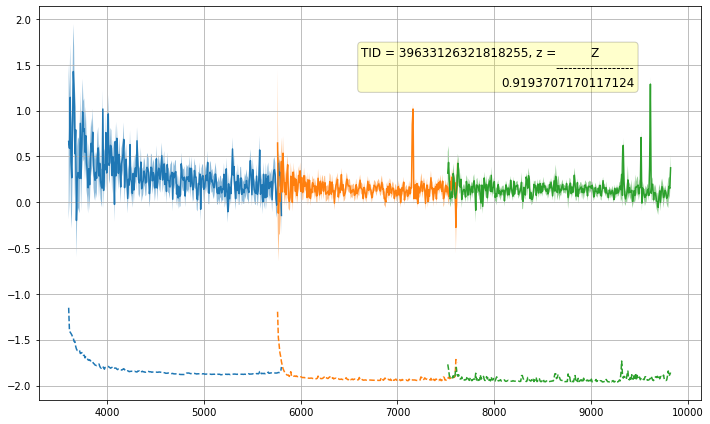

TARGETID=39633126321818299
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321818299         0         85 ... 60256.45965609 60256.45965609


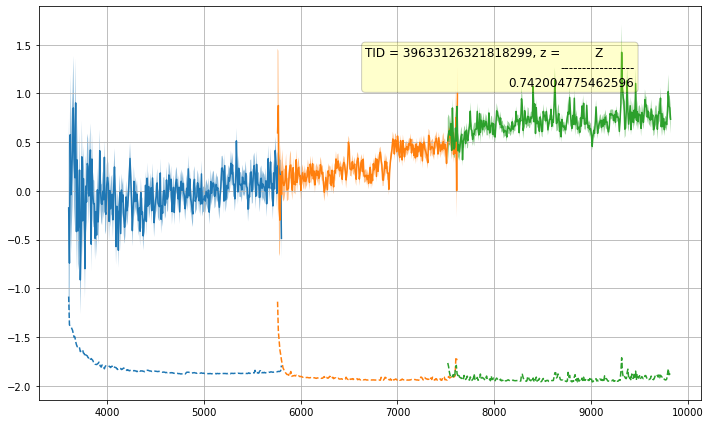

TARGETID=39633126321818402
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321818402         0        118 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


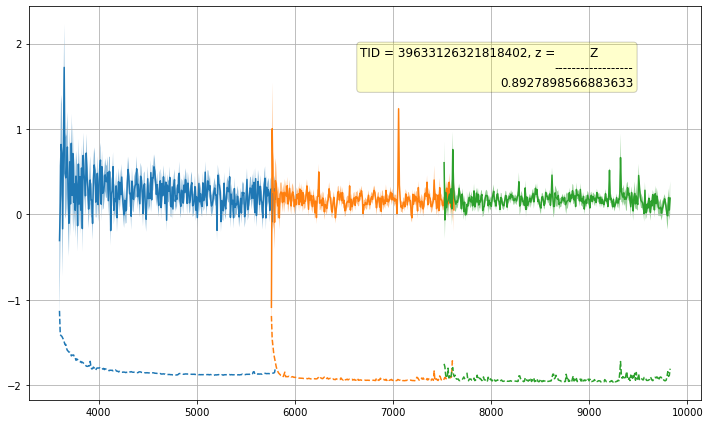

TARGETID=39633126321818425
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321818425         0        107 ... 60256.45965609 60256.45965609


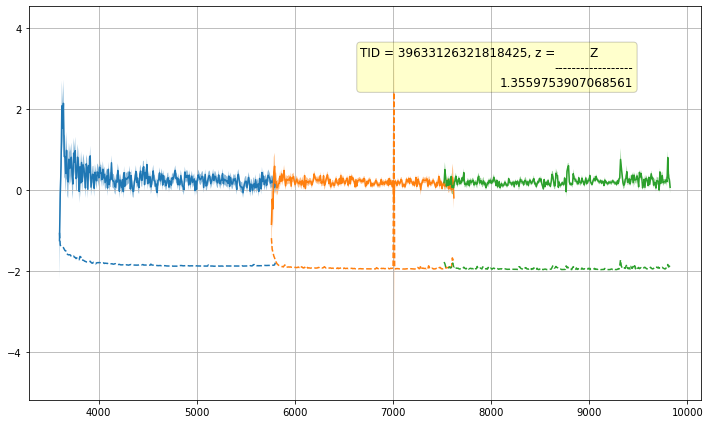

TARGETID=39633126321818668
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321818668         0         95 ... 60256.45965609 60256.45965609


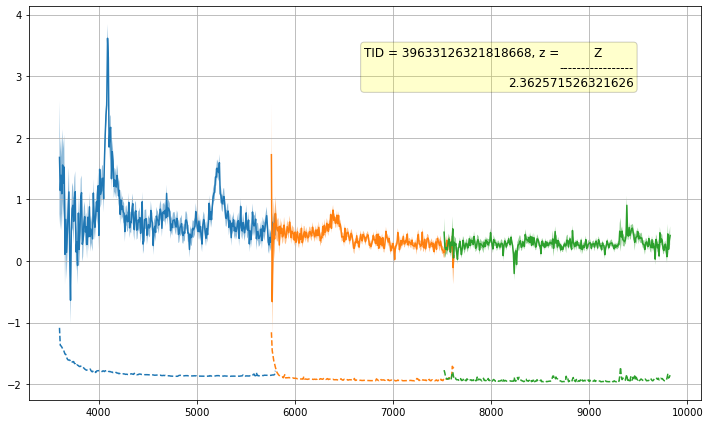

TARGETID=39633126321818730
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321818730         0        130 ... 60256.45965609 60256.45965609


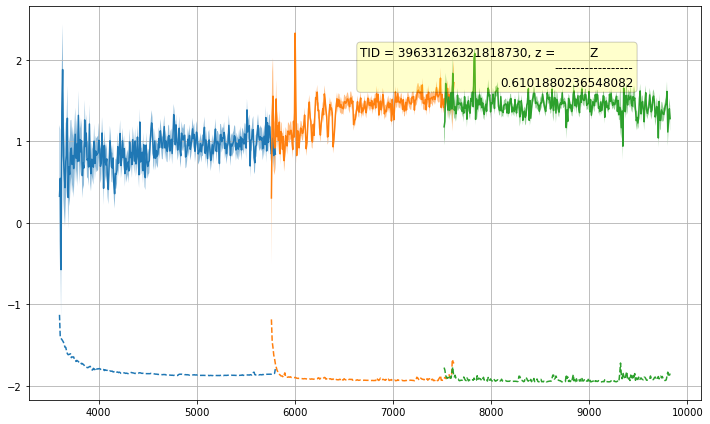

TARGETID=39633126321819035
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321819035         0        142 ... 60256.45965609 60256.45965609


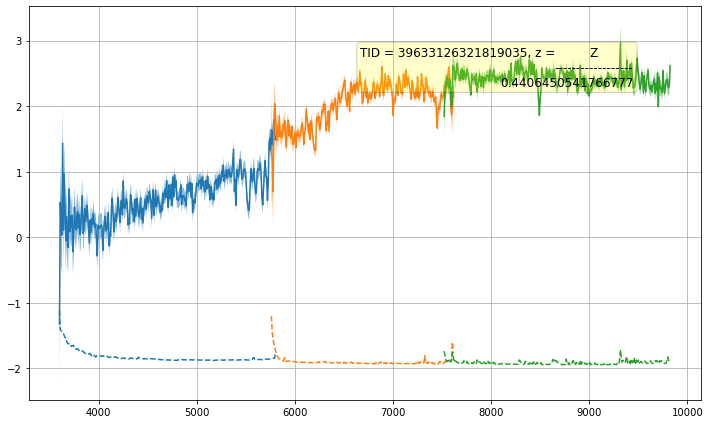

TARGETID=39633126321819135
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321819135         0        117 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


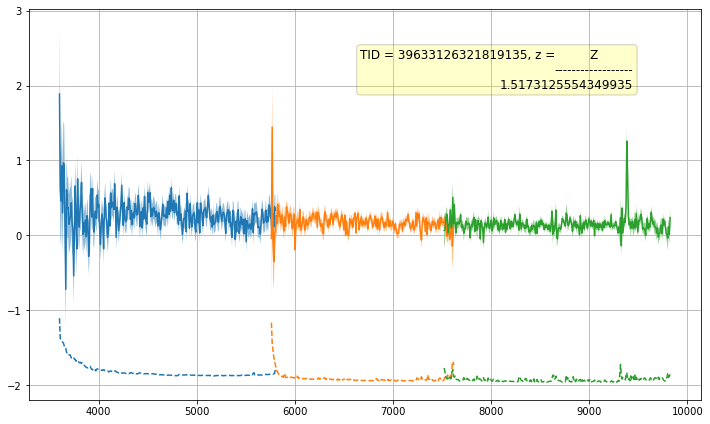

TARGETID=39633126321819144
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321819144         0        106 ... 60256.45965609 60256.45965609


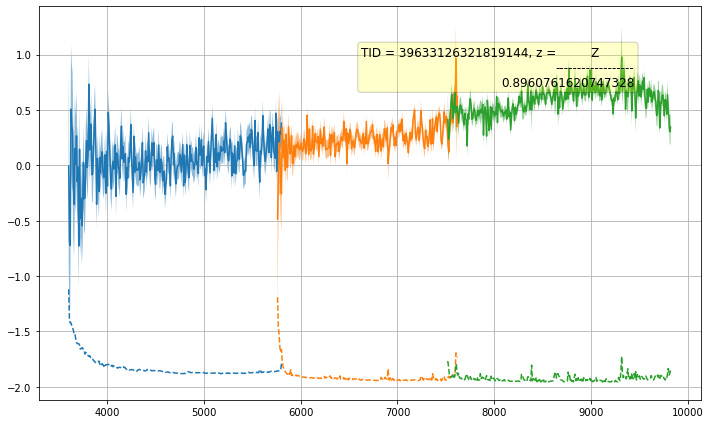

TARGETID=39633126321819457
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321819457         0         94 ... 60256.45965609 60256.45965609


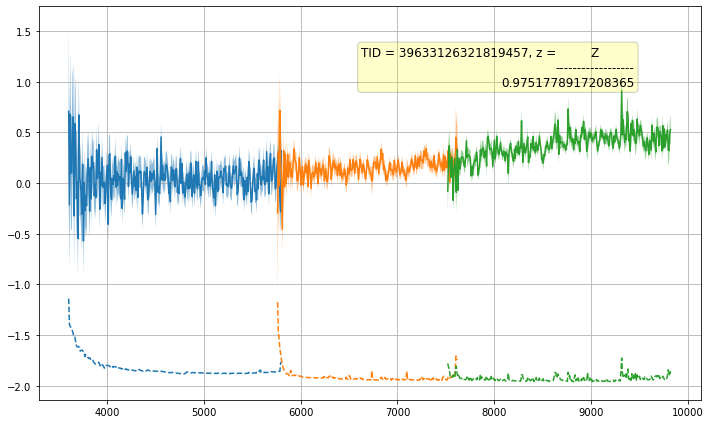

TARGETID=39633126321819560
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321819560         0         84 ... 60256.45965609 60256.45965609


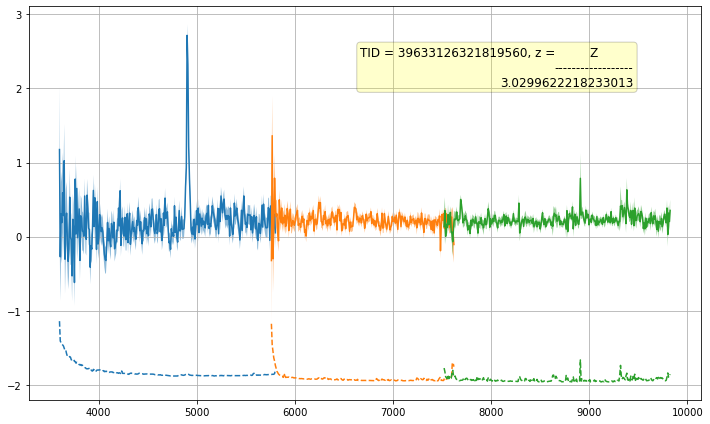

TARGETID=39633126321819644
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321819644         0         83 ... 60256.45965609 60256.45965609


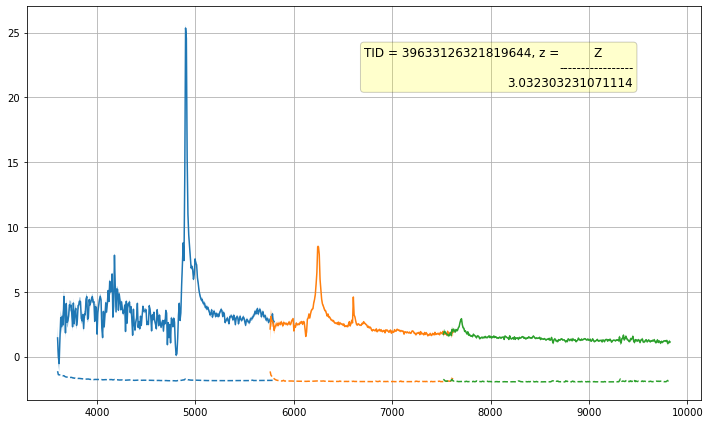

TARGETID=39633126321819683
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126321819683         0        105 ... 60256.45965609 60256.45965609


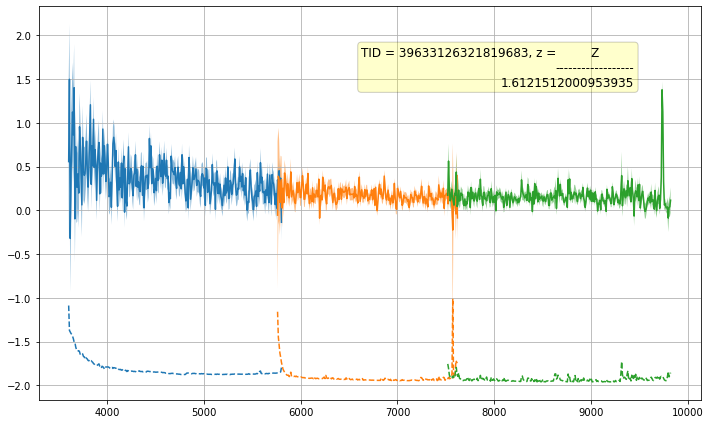

TARGETID=39633126326010210
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326010210         0        128 ... 60256.45965609 60256.45965609


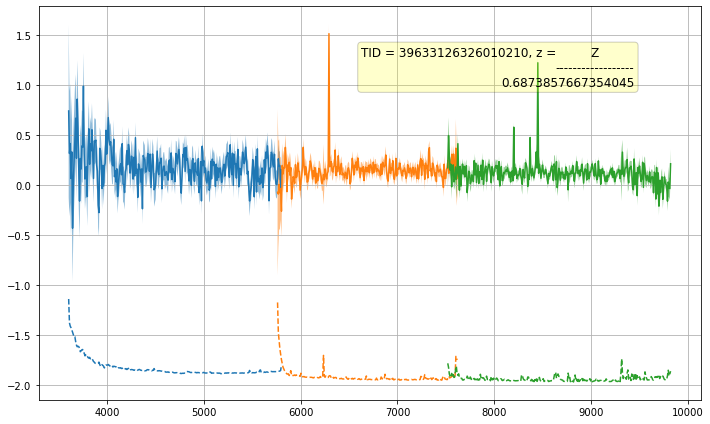

TARGETID=39633126326010257
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326010257         0        140 ... 60256.45965609 60256.45965609


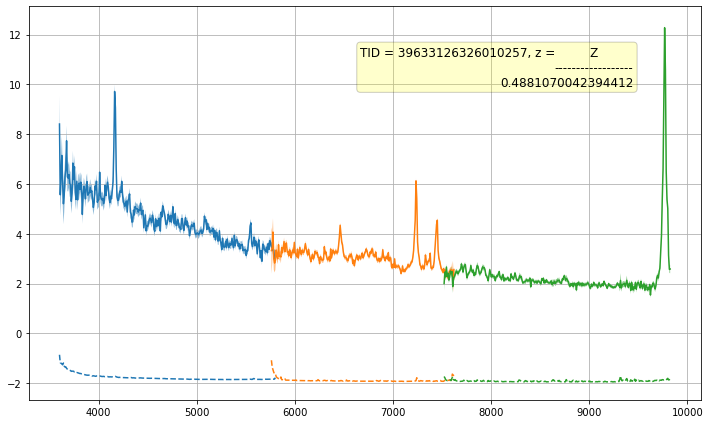

TARGETID=39633126326010311
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326010311         0         93 ... 60256.45965609 60256.45965609


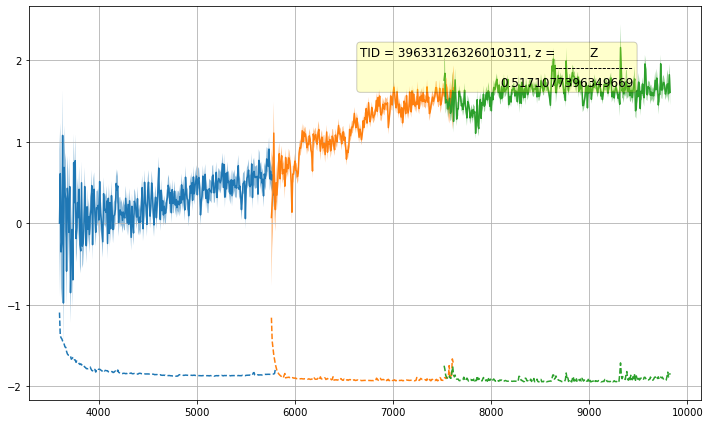

TARGETID=39633126326010337
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326010337         0        116 ... 60256.45965609 60256.45965609


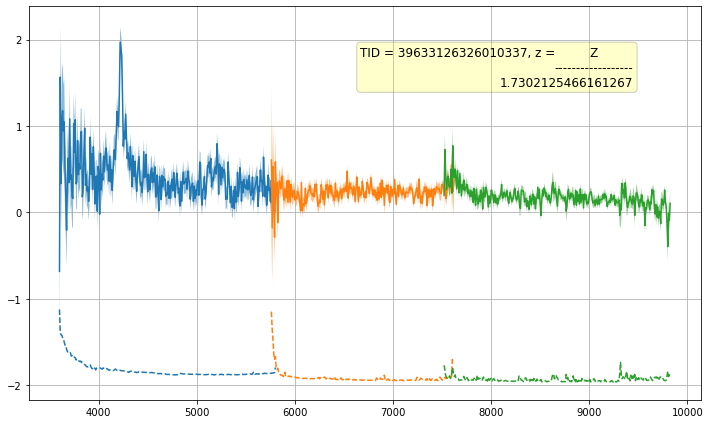

TARGETID=39633126326010338
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326010338         0         64 ... 60256.45965609 60256.45965609


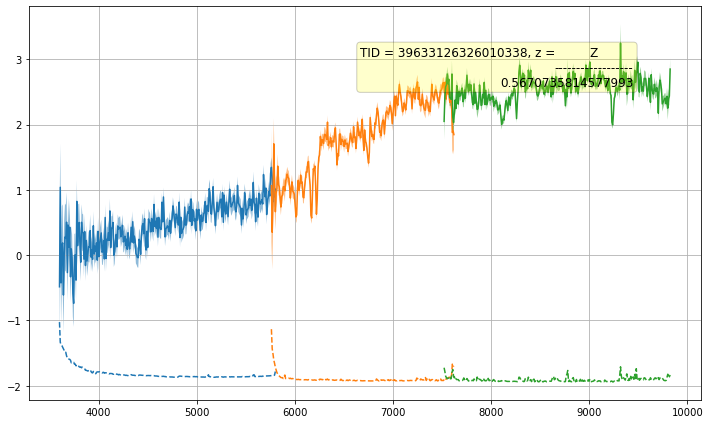

TARGETID=39633126326010419
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326010419         0        104 ... 60256.45965609 60256.45965609


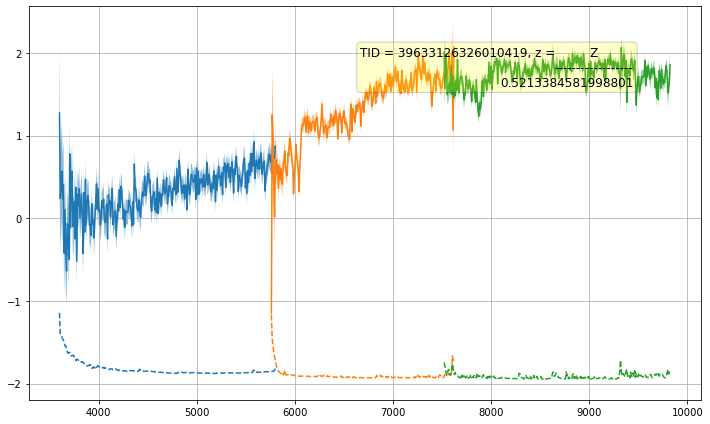

TARGETID=39633126326011030
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326011030         0         92 ... 60256.45965609 60256.45965609


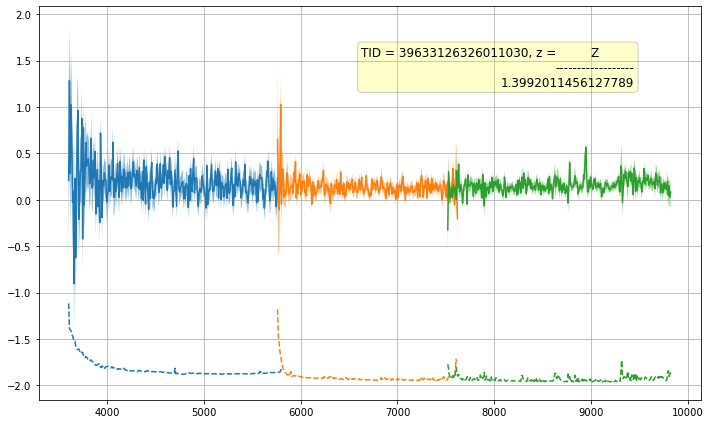

TARGETID=39633126326011032
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326011032         0        127 ... 60256.45965609 60256.45965609


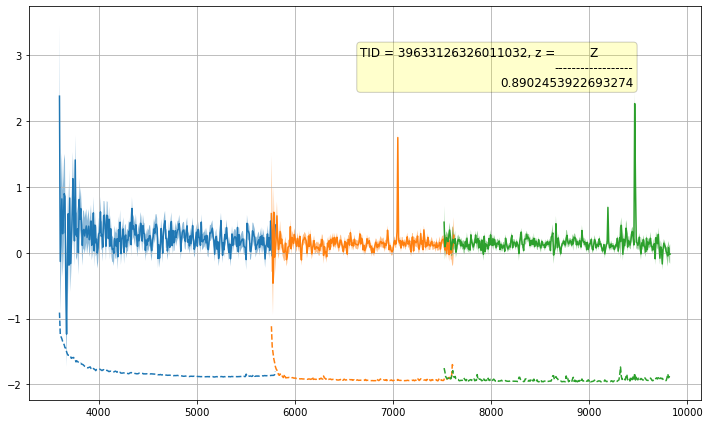

TARGETID=39633126326011179
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326011179         0        115 ... 60256.45965609 60256.45965609


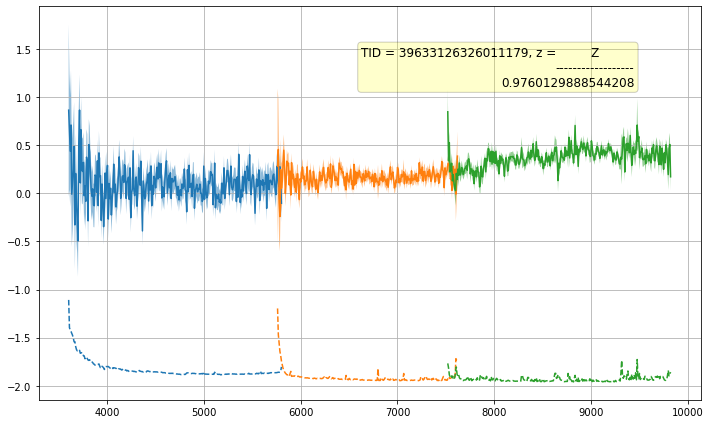

TARGETID=39633126326011245
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326011245         0         63 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


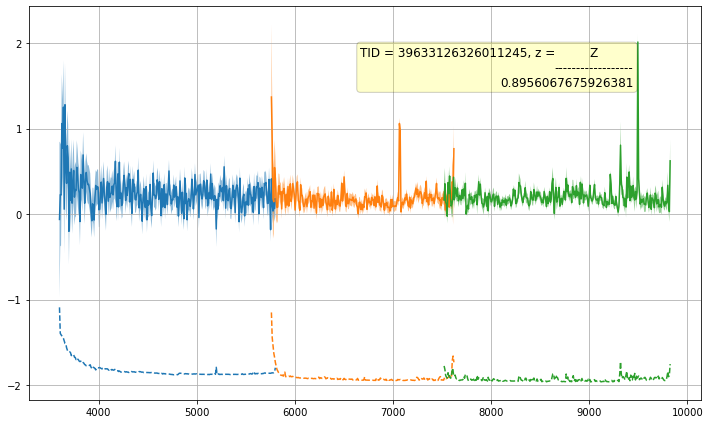

TARGETID=39633126326011317
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326011317         0        114 ... 60256.45965609 60256.45965609


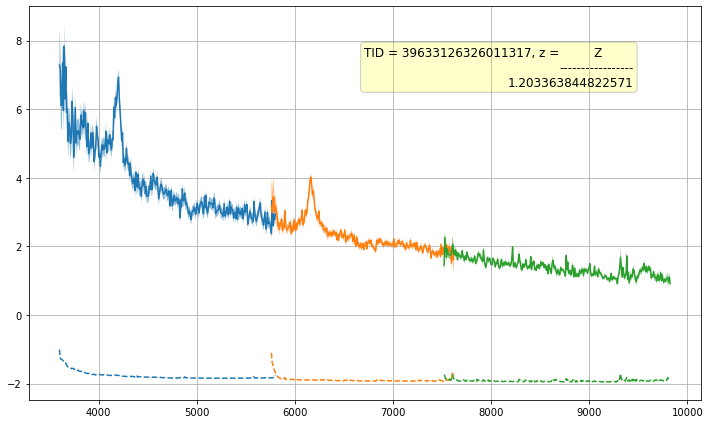

TARGETID=39633126326011345
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326011345         0         81 ... 60256.45965609 60256.45965609


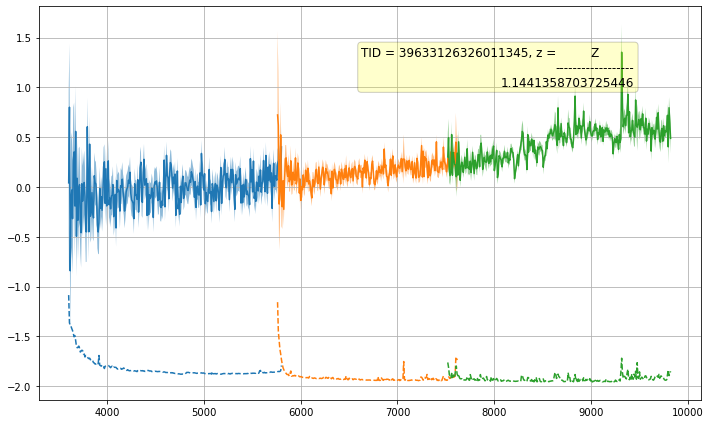

TARGETID=39633126326011508
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326011508         0         72 ... 60256.45965609 60256.45965609


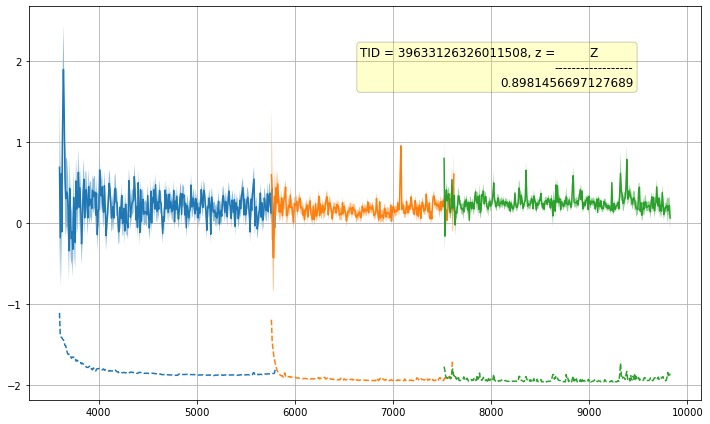

TARGETID=39633126326011631
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326011631         0         91 ... 60256.45965609 60256.45965609


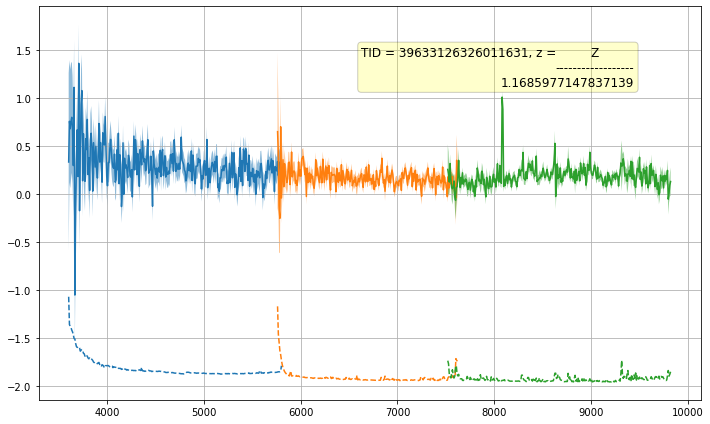

TARGETID=39633126326011727
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326011727         0        103 ... 60256.45965609 60256.45965609


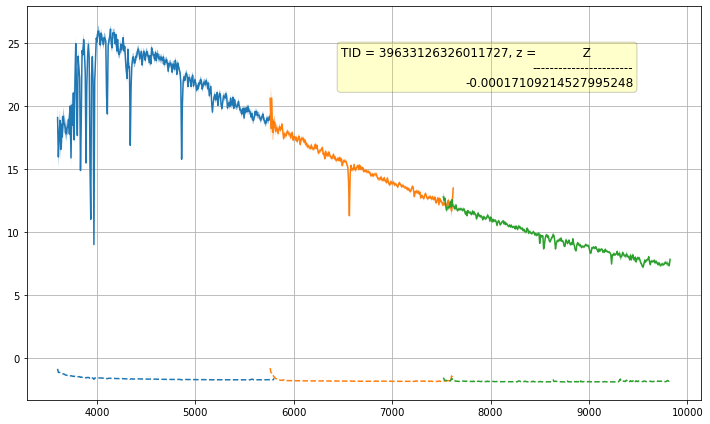

TARGETID=39633126326012016
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326012016         0         71 ... 60256.45965609 60256.45965609


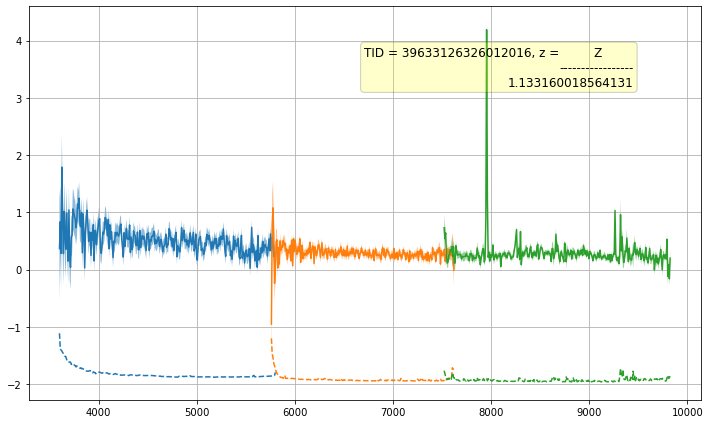

TARGETID=39633126326012077
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326012077         0        102 ... 60256.45965609 60256.45965609


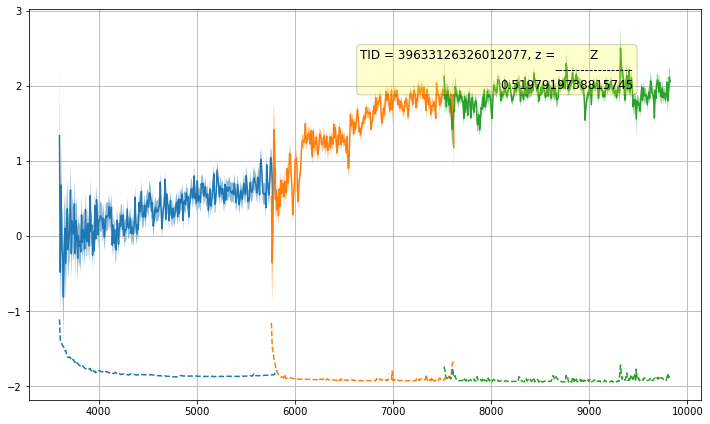

TARGETID=39633126326012329
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326012329         0        113 ... 60256.45965609 60256.45965609


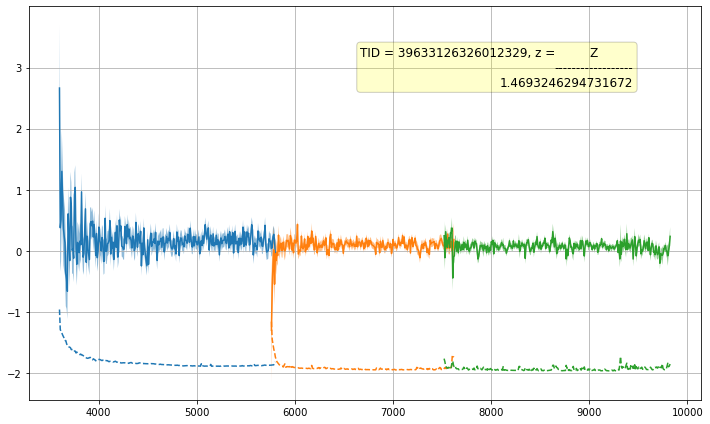

TARGETID=39633126326012410
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326012410         0        101 ... 60256.45965609 60256.45965609


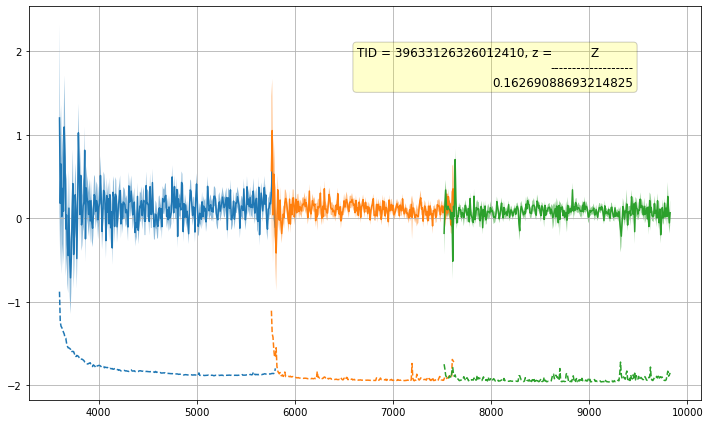

TARGETID=39633126326012452
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326012452         0         90 ... 60256.45965609 60256.45965609


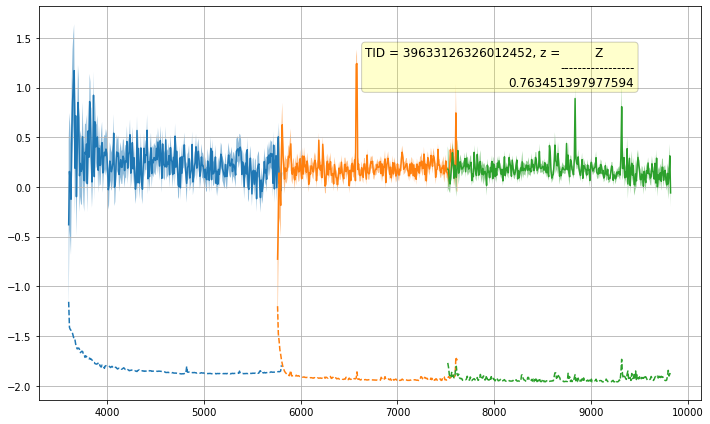

TARGETID=39633126326012855
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633126326012855         0        112 ... 60256.45965609 60256.45965609


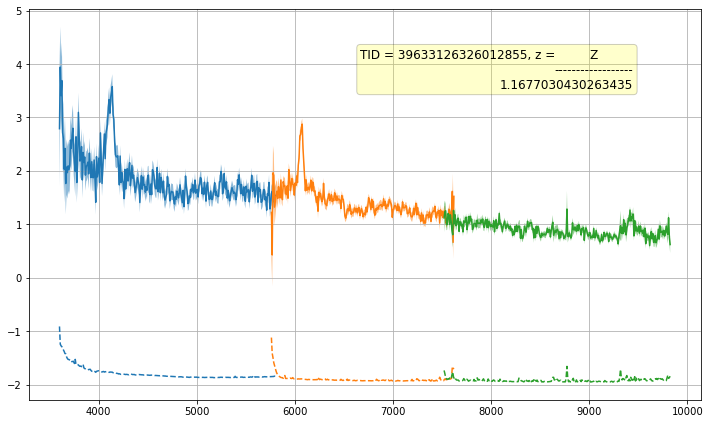

TARGETID=39633130759391693
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130759391693         0         53 ... 60256.45965609 60256.45965609


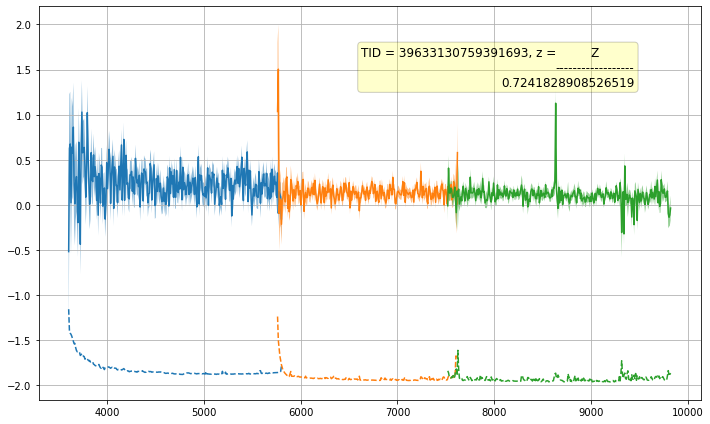

TARGETID=39633130759391974
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130759391974         0         61 ... 60256.45965609 60256.45965609


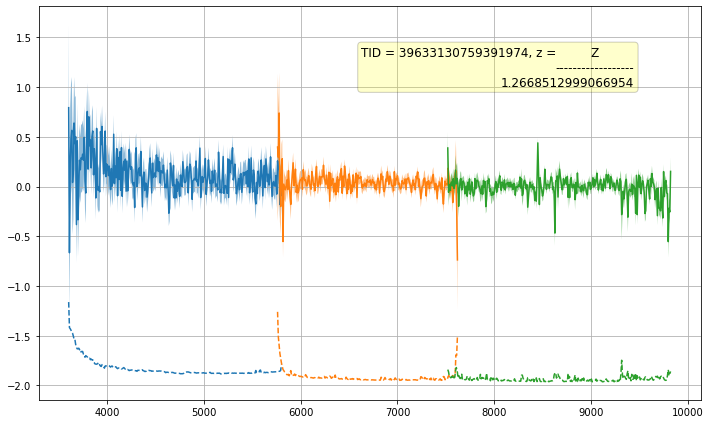

TARGETID=39633130759392223
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130759392223         0         31 ... 60256.45965609 60256.45965609


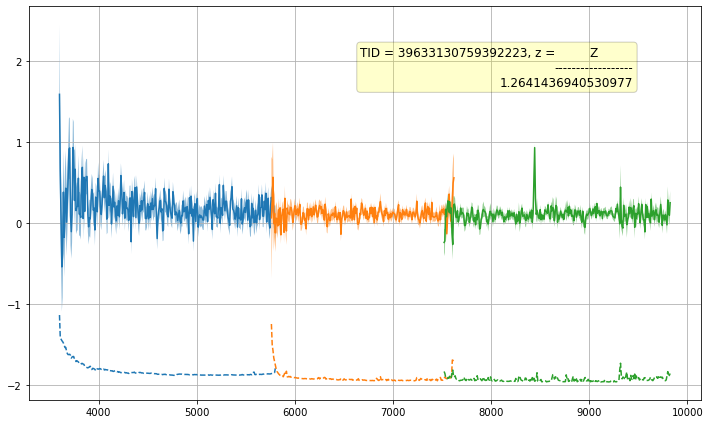

TARGETID=39633130759392324
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130759392324         0         45 ... 60256.45965609 60256.45965609


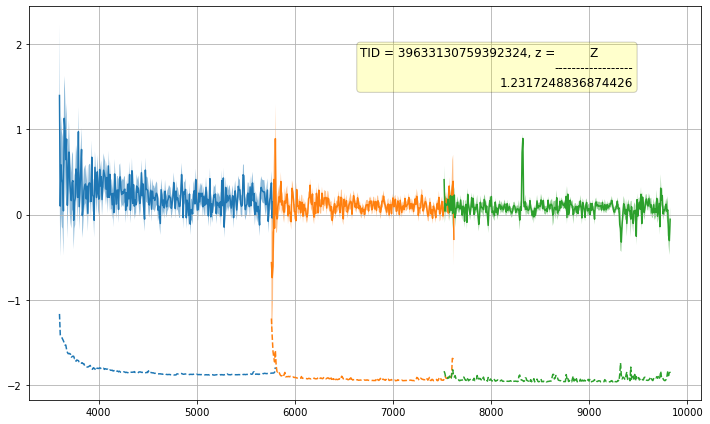

TARGETID=39633130759392332
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130759392332         0         69 ... 60256.45965609 60256.45965609


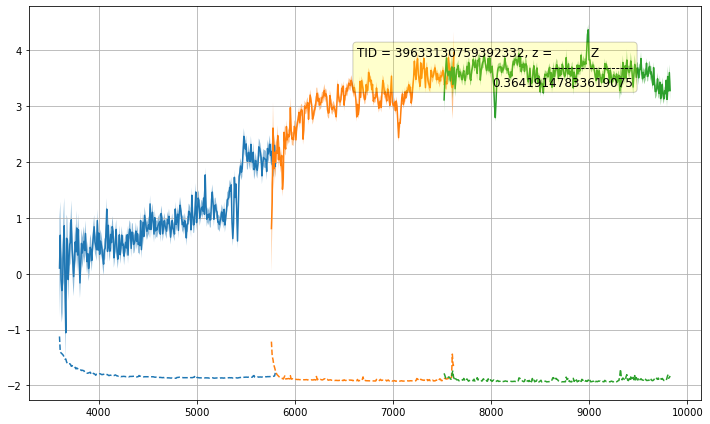

TARGETID=39633130759392384
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130759392384         0         52 ... 60256.45965609 60256.45965609


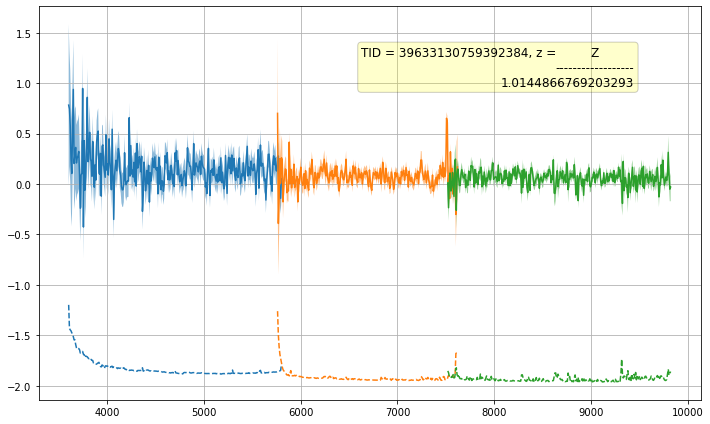

TARGETID=39633130759392432
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130759392432         0         60 ... 60256.45965609 60256.45965609


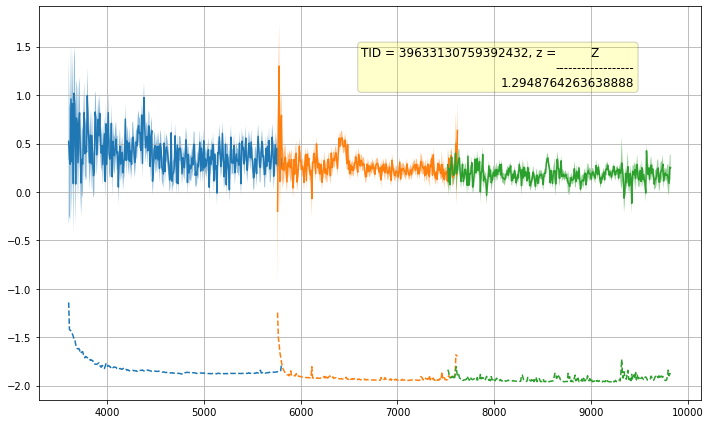

TARGETID=39633130759392998
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130759392998         0         37 ... 60256.45965609 60256.45965609


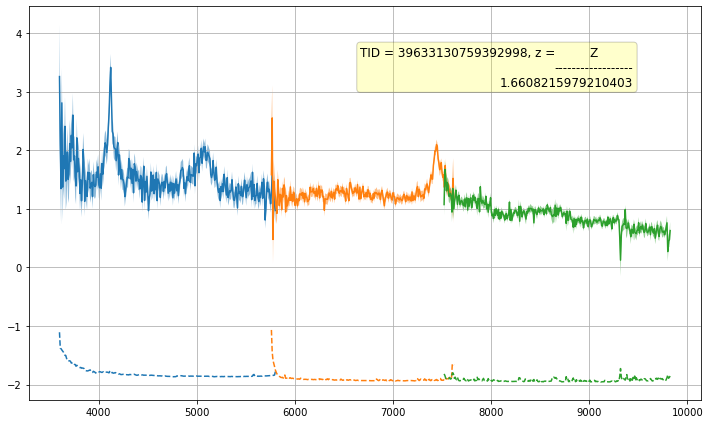

TARGETID=39633130759393003
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130759393003         0         44 ... 60256.45965609 60256.45965609


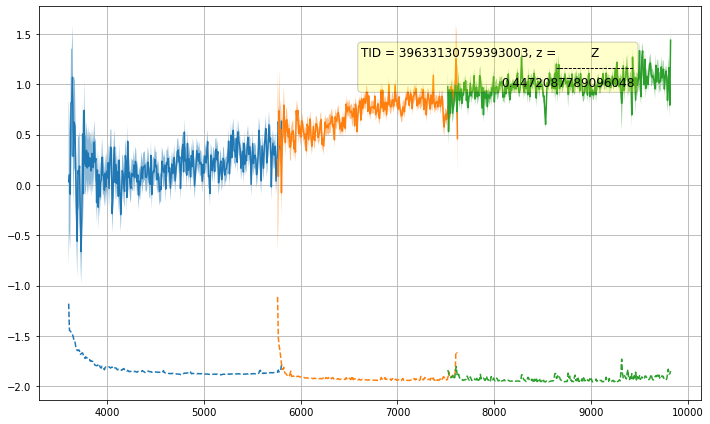

TARGETID=39633130763583518
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763583518         0         51 ... 60256.45965609 60256.45965609


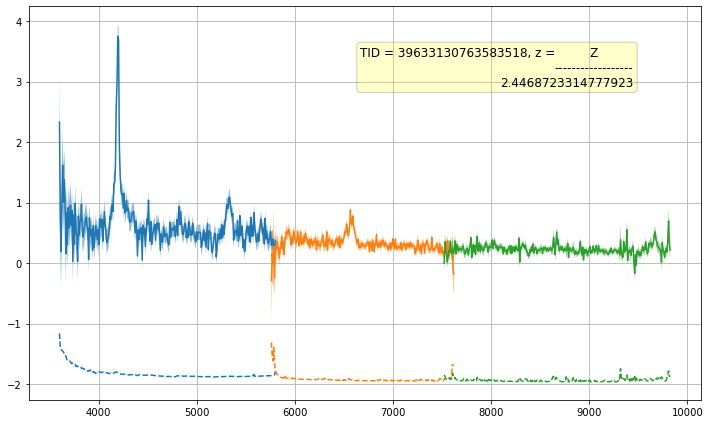

TARGETID=39633130763583920
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763583920         0         36 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


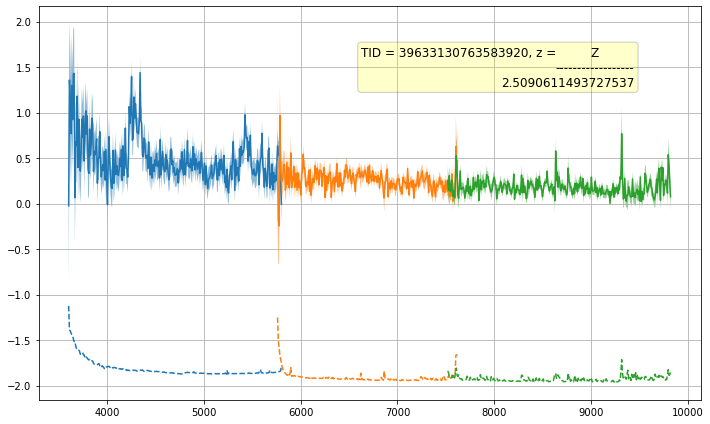

TARGETID=39633130763583985
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763583985         0         67 ... 60256.45965609 60256.45965609


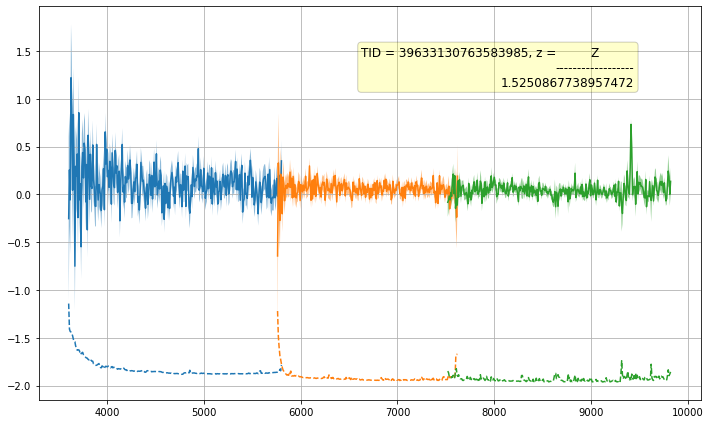

TARGETID=39633130763584254
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584254         0         50 ... 60256.45965609 60256.45965609


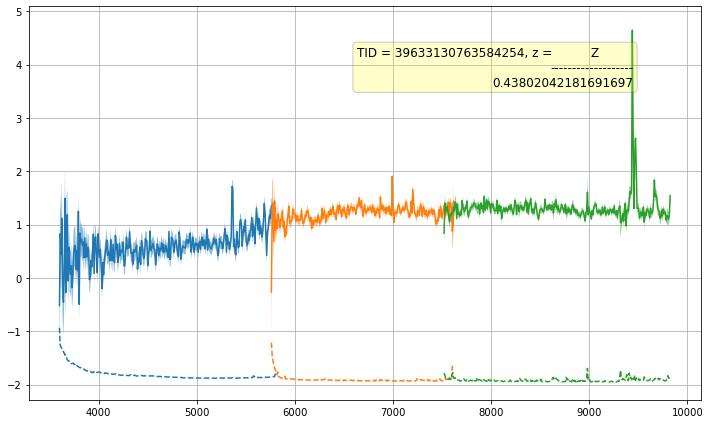

TARGETID=39633130763584270
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584270         0         24 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


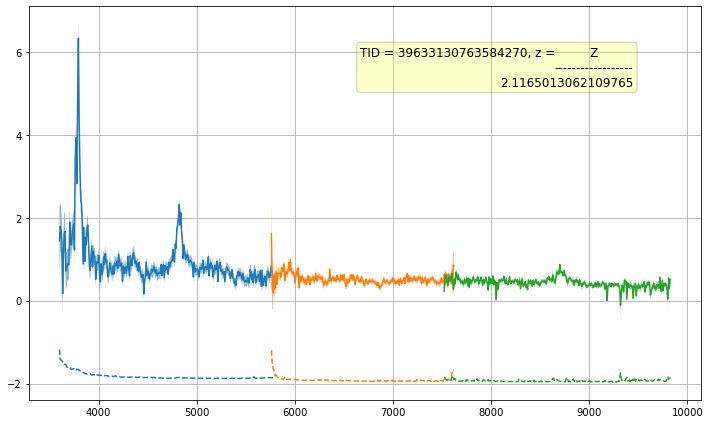

TARGETID=39633130763584272
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584272         0         35 ... 60256.45965609 60256.45965609


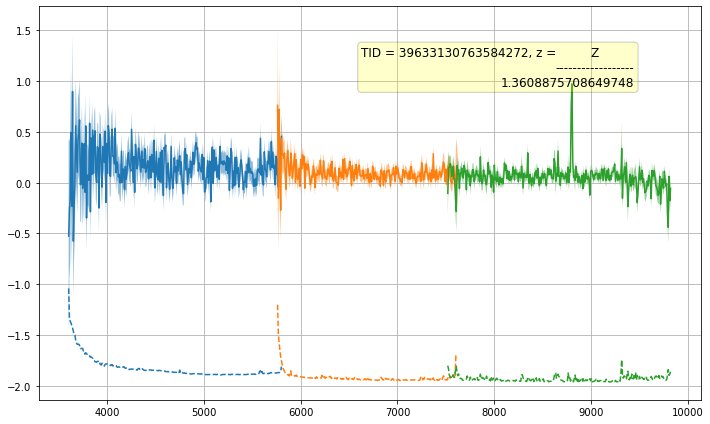

TARGETID=39633130763584372
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584372         0         58 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


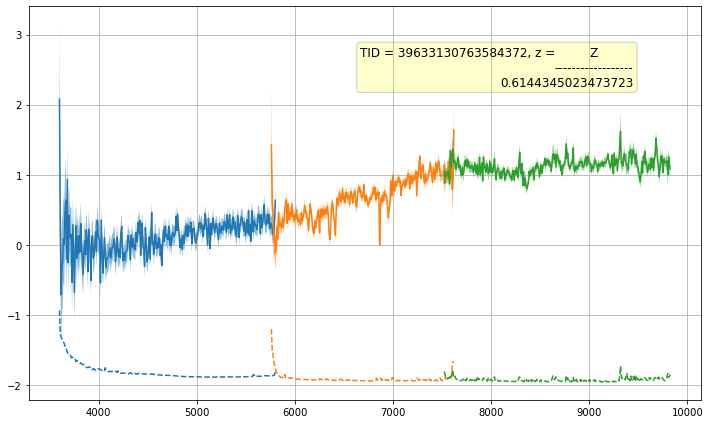

TARGETID=39633130763584380
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584380         0         29 ... 60256.45965609 60256.45965609


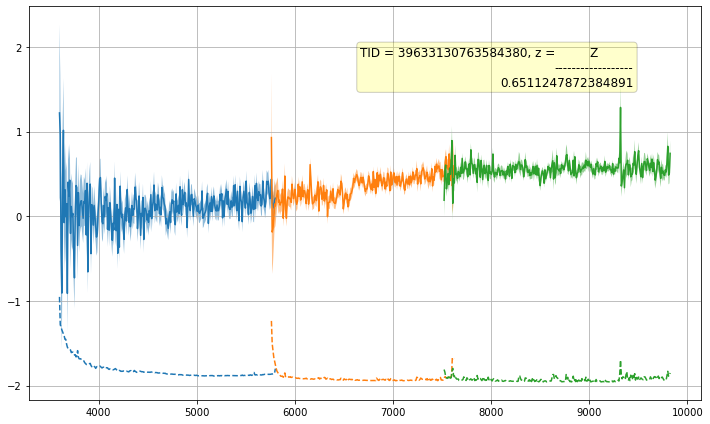

TARGETID=39633130763584539
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584539         0         66 ... 60256.45965609 60256.45965609


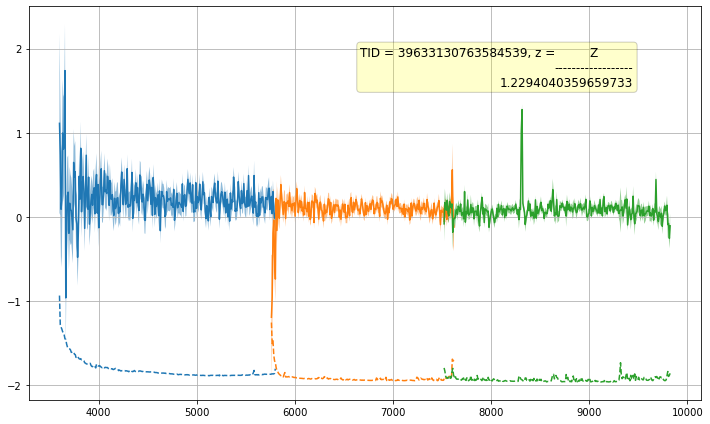

TARGETID=39633130763584602
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584602         0         42 ... 60256.45965609 60256.45965609


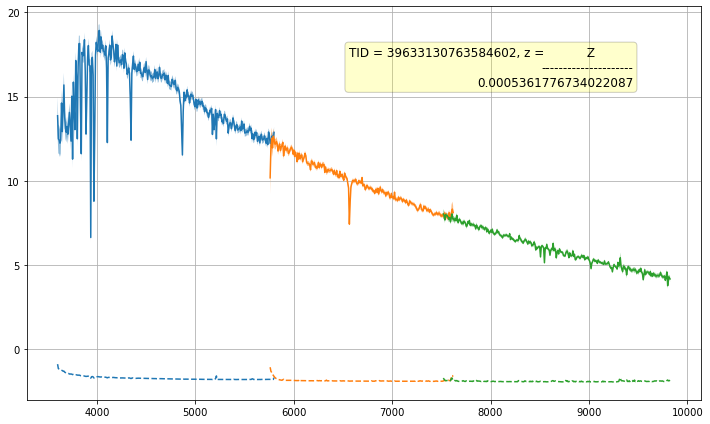

TARGETID=39633130763584670
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584670         0         49 ... 60256.45965609 60256.45965609


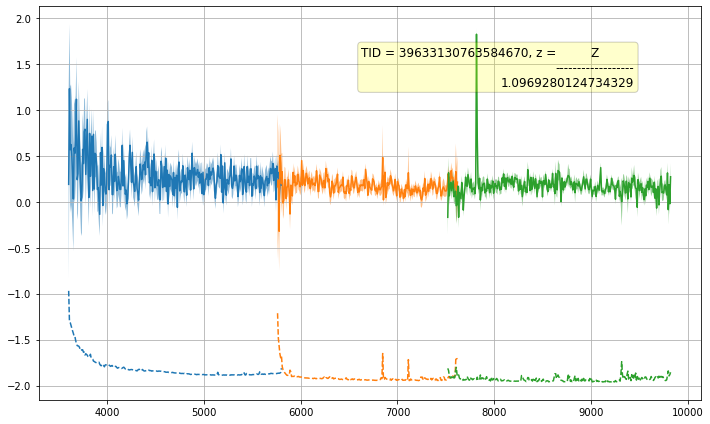

TARGETID=39633130763584900
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584900         0         28 ... 60256.45965609 60256.45965609


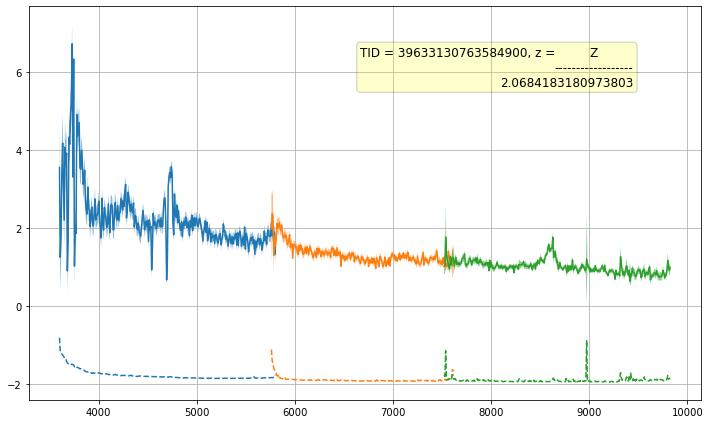

TARGETID=39633130763584912
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584912         0         34 ... 60256.45965609 60256.45965609


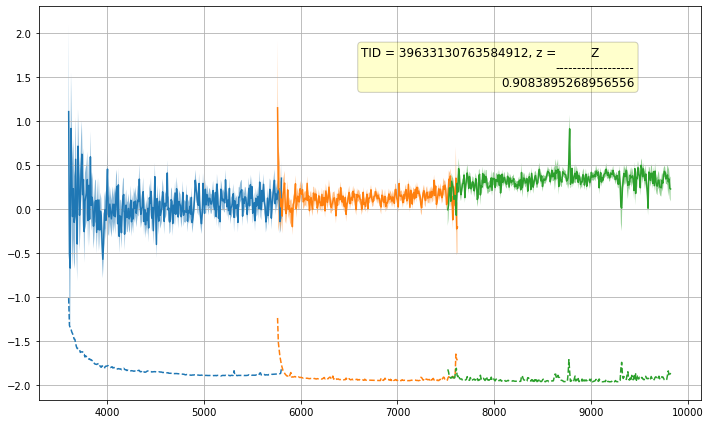

TARGETID=39633130763584989
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763584989         0         65 ... 60256.45965609 60256.45965609


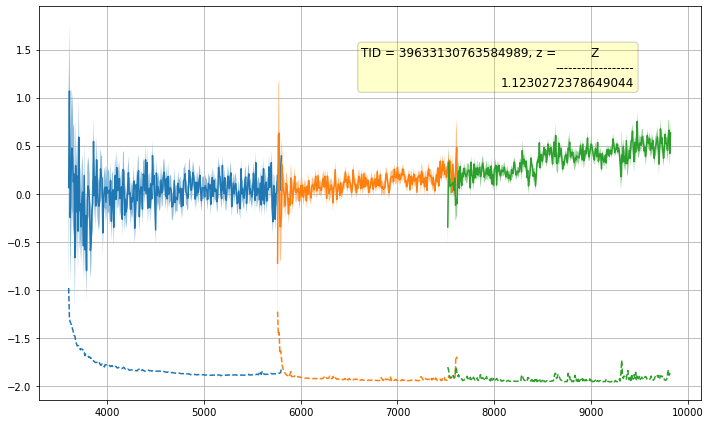

TARGETID=39633130763585007
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763585007         0         41 ... 60256.45965609 60256.45965609


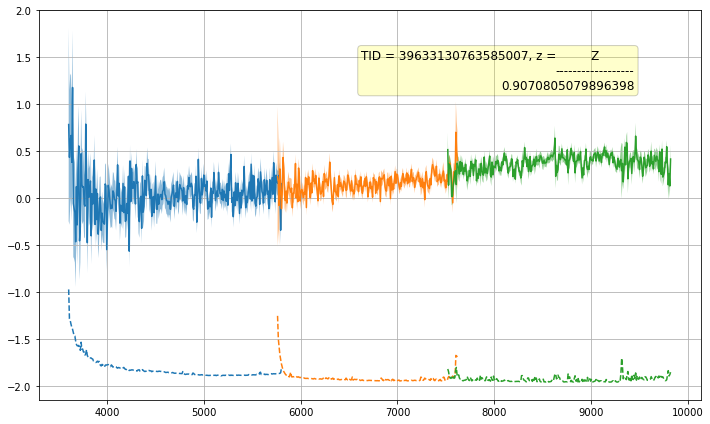

TARGETID=39633130763585013
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763585013         0         57 ... 60256.45965609 60256.45965609


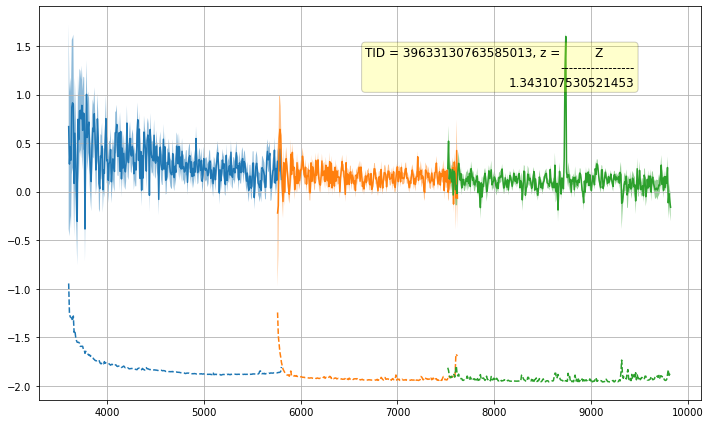

TARGETID=39633130763585155
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763585155         0         27 ... 60256.45965609 60256.45965609


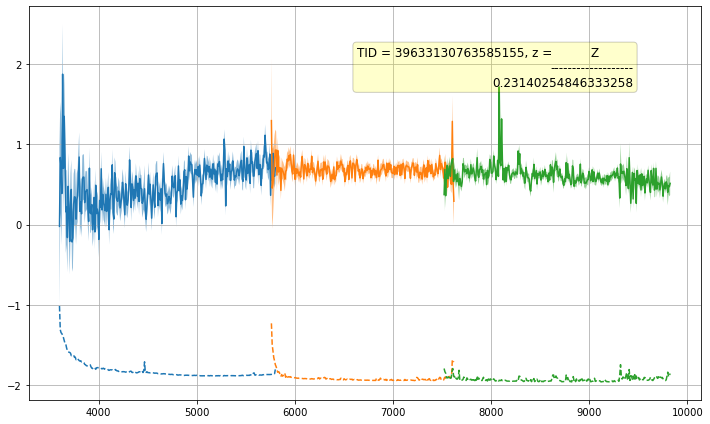

TARGETID=39633130763585336
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763585336         0         56 ... 60256.45965609 60256.45965609


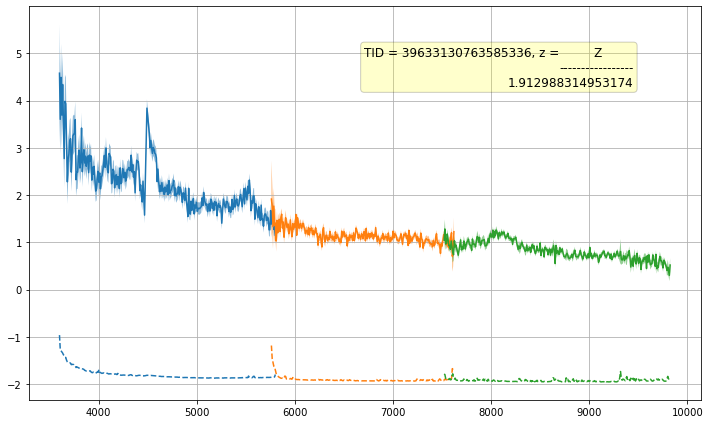

TARGETID=39633130763585597
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763585597         0         16 ... 60256.45965609 60256.45965609


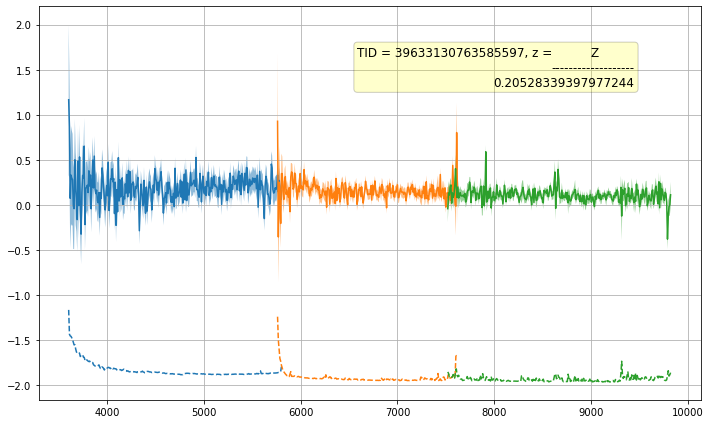

TARGETID=39633130763585646
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763585646         0         33 ... 60256.45965609 60256.45965609


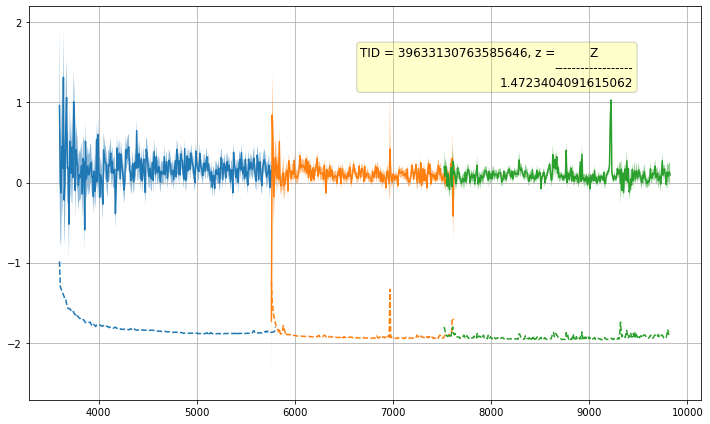

TARGETID=39633130763585674
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763585674         0         21 ... 60256.45965609 60256.45965609


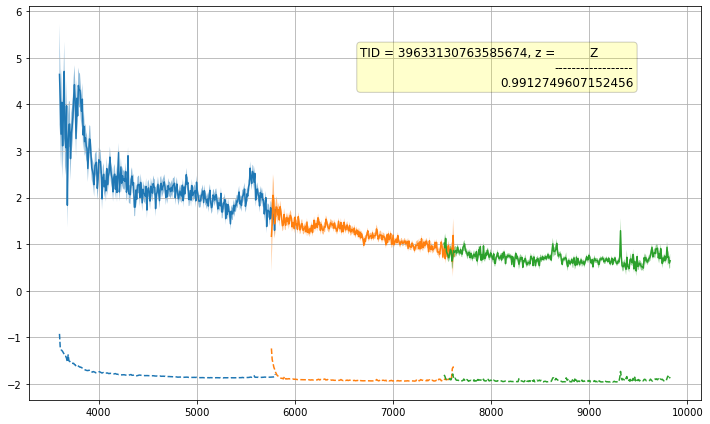

TARGETID=39633130763585809
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763585809         0         40 ... 60256.45965609 60256.45965609


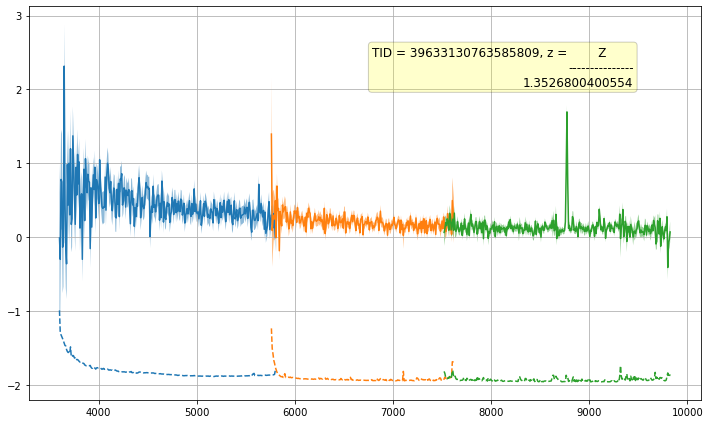

TARGETID=39633130763585958
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763585958         0         26 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


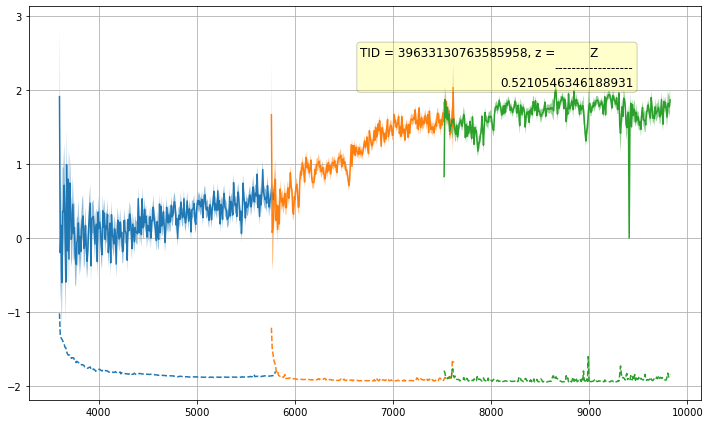

TARGETID=39633130763586143
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763586143         0         32 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


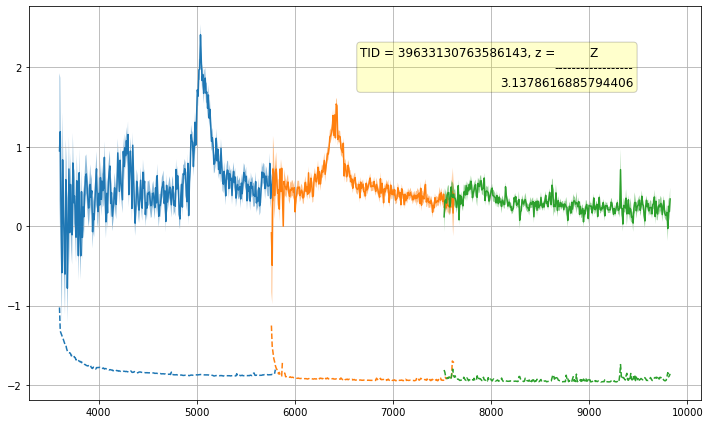

TARGETID=39633130763586492
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763586492         0         39 ... 60256.45965609 60256.45965609


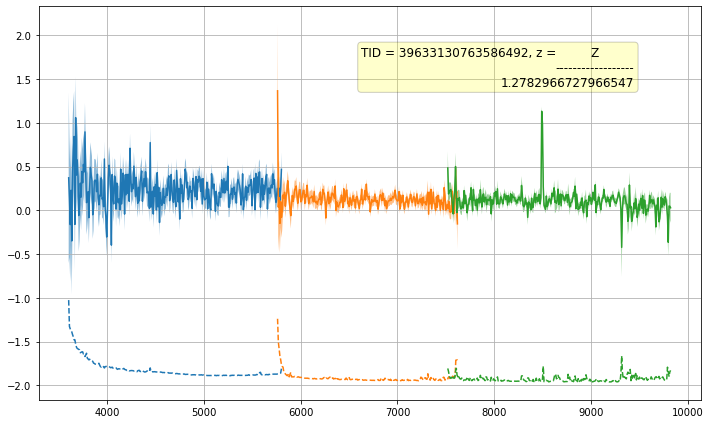

TARGETID=39633130763586771
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763586771         0         46 ... 60256.45965609 60256.45965609


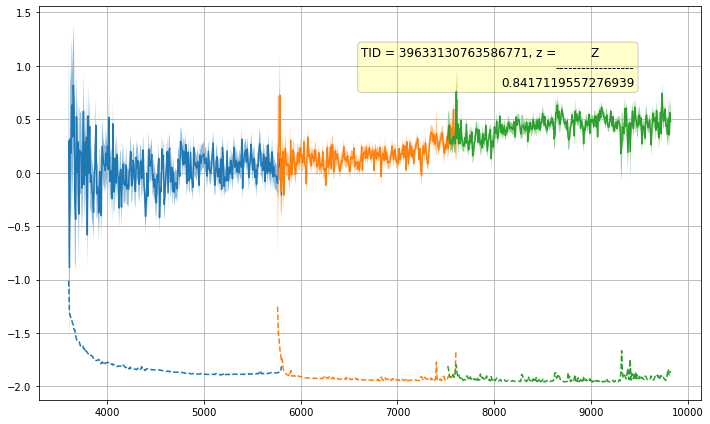

TARGETID=39633130763586847
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633130763586847         0         54 ... 60256.45965609 60256.45965609


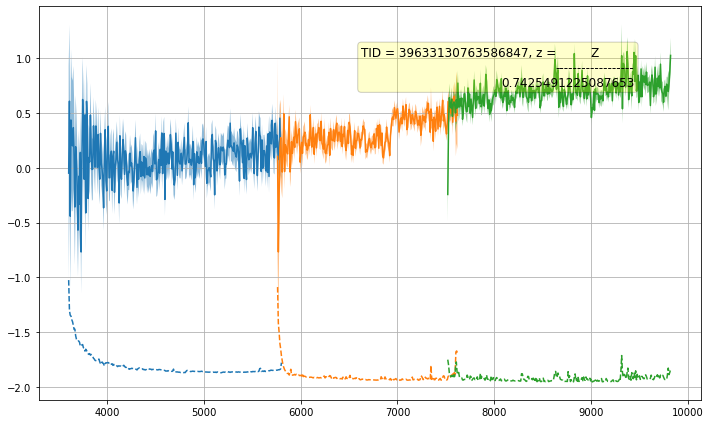

TARGETID=39633135184381883
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184381883         0         19 ... 60256.45965609 60256.45965609


/tmp/ipykernel_1106745/3540593773.py:35: RuntimeWarning: divide by zero encountered in true_divide
  plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
/tmp/ipykernel_1106745/3540593773.py:36: RuntimeWarning: divide by zero encountered in true_divide
  rflux+1./np.sqrt(rivar), alpha=0.5)
/tmp/ipykernel_1106745/3540593773.py:38: RuntimeWarning: divide by zero encountered in true_divide
  plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,


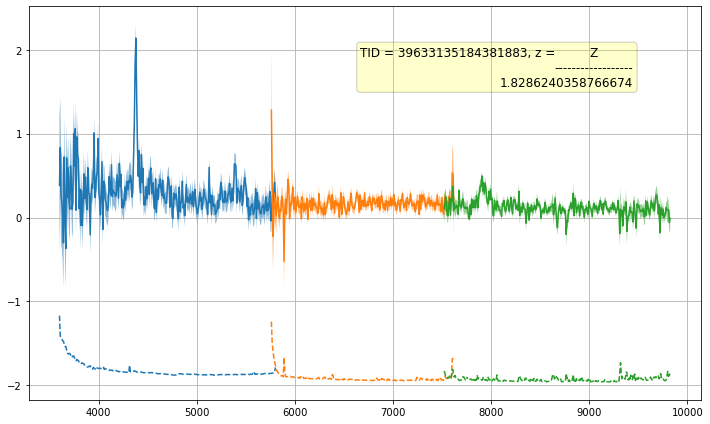

TARGETID=39633135184382033
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382033         0         15 ... 60256.45965609 60256.45965609


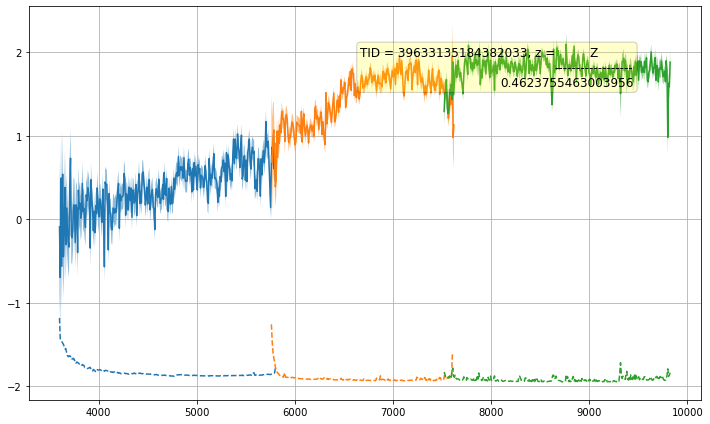

TARGETID=39633135184382100
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382100         0         10 ... 60256.45965609 60256.45965609


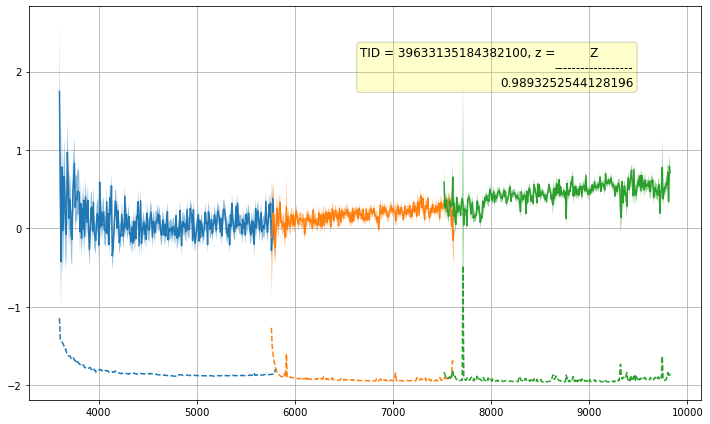

TARGETID=39633135184382164
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382164         0          7 ... 60256.45965609 60256.45965609


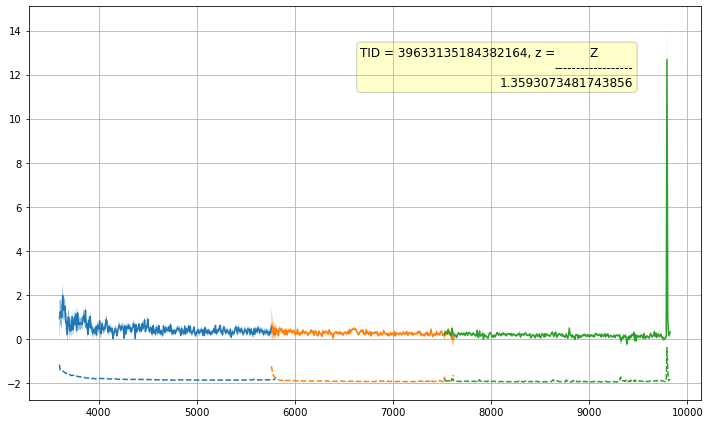

TARGETID=39633135184382279
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382279         0         14 ... 60256.45965609 60256.45965609


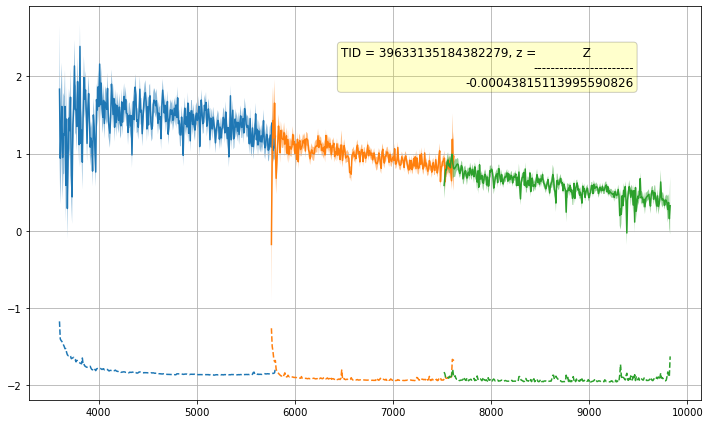

TARGETID=39633135184382548
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382548         0          6 ... 60256.45965609 60256.45965609


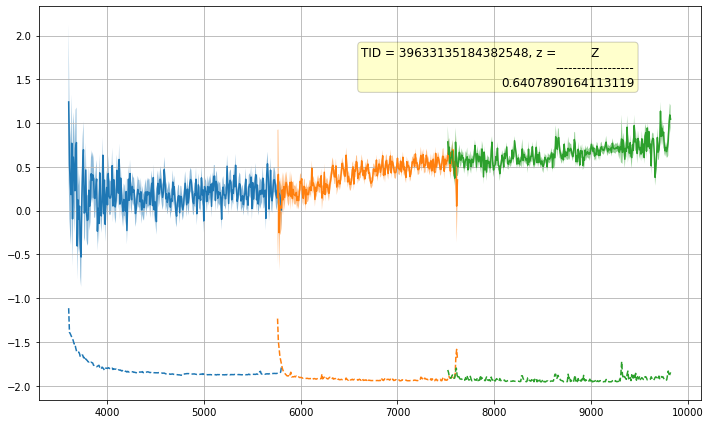

TARGETID=39633135184382596
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382596         0         18 ... 60256.45965609 60256.45965609


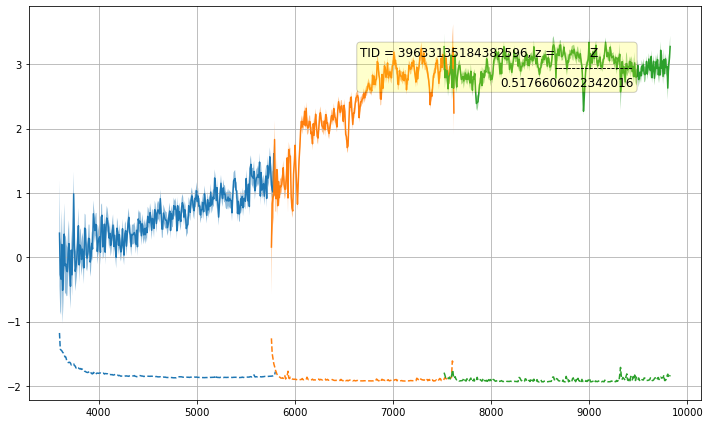

TARGETID=39633135184382648
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382648         0          4 ... 60256.45965609 60256.45965609


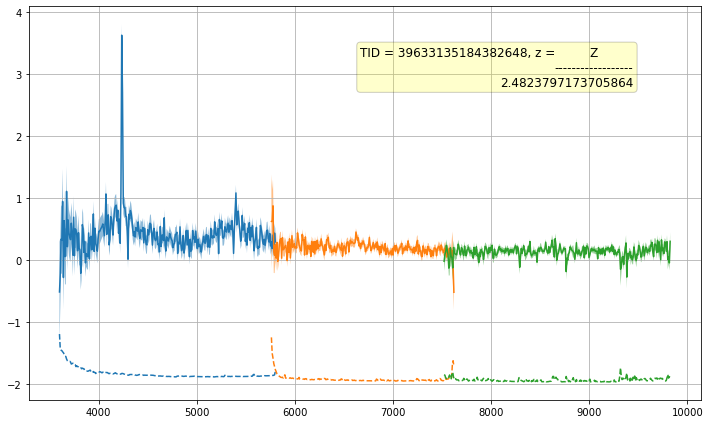

TARGETID=39633135184382676
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382676         0          2 ... 60256.45965609 60256.45965609


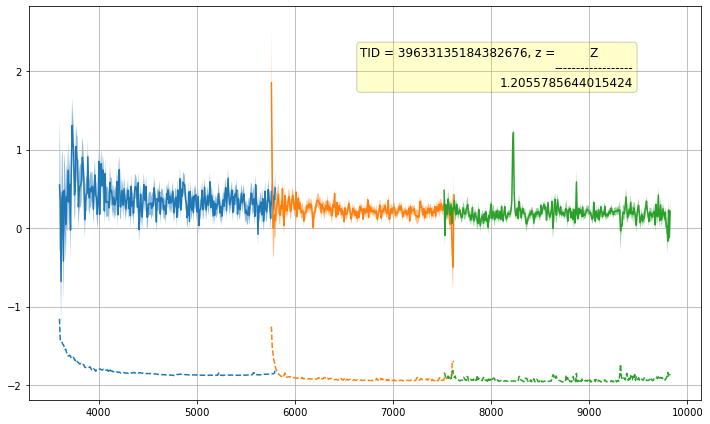

TARGETID=39633135184382834
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382834         0          0 ... 60256.45965609 60256.45965609


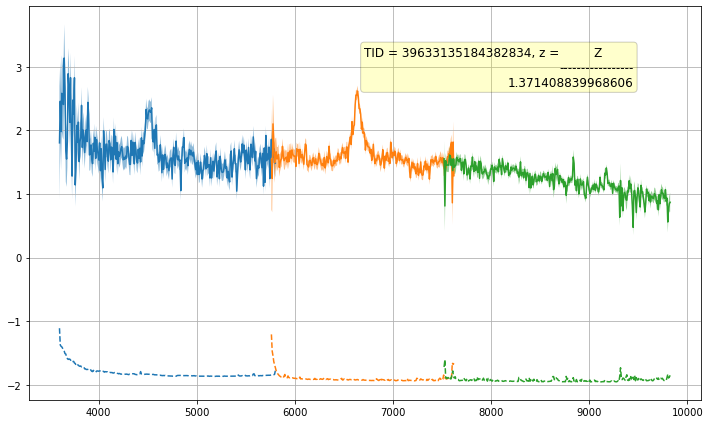

TARGETID=39633135184382944
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184382944         0         13 ... 60256.45965609 60256.45965609


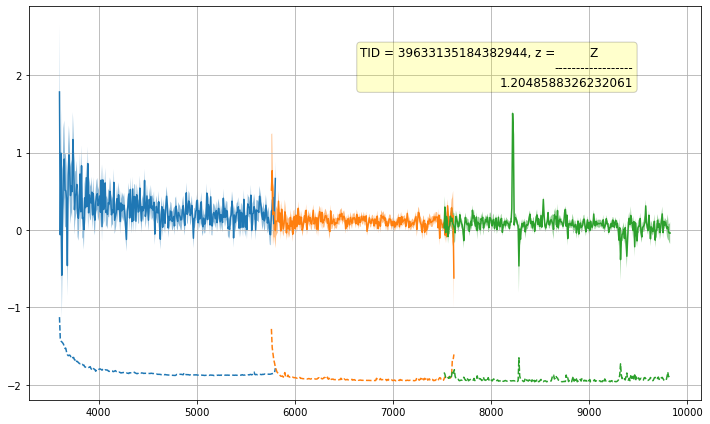

TARGETID=39633135184383037
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184383037         0          1 ... 60256.45965609 60256.45965609


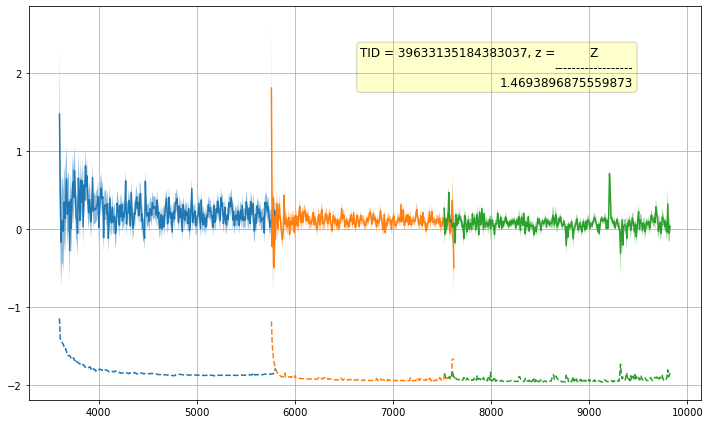

TARGETID=39633135184383048
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184383048         0          3 ... 60256.45965609 60256.45965609


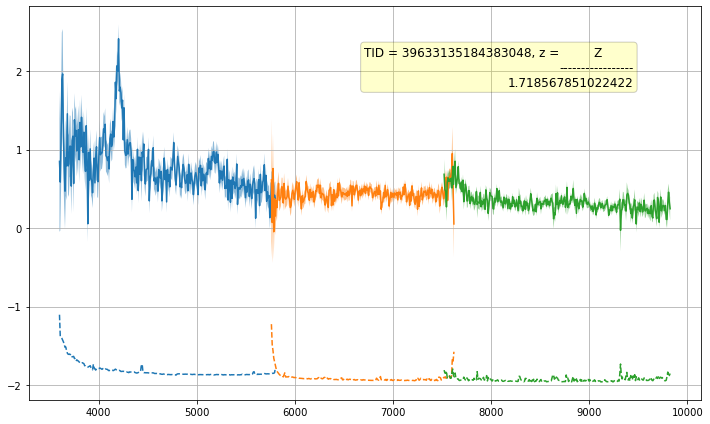

TARGETID=39633135184383248
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184383248         0          9 ... 60256.45965609 60256.45965609


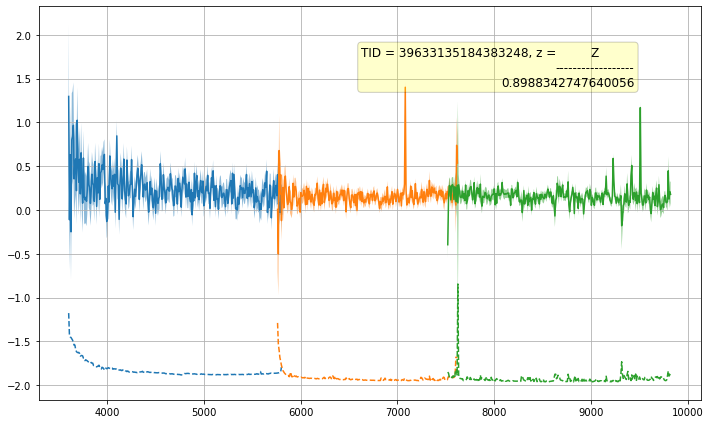

TARGETID=39633135184383293
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184383293         0         17 ... 60256.45965609 60256.45965609


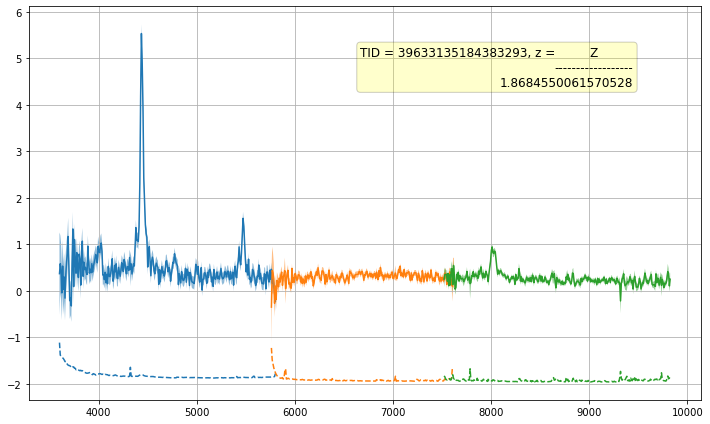

TARGETID=39633135184383365
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184383365         0          8 ... 60256.45965609 60256.45965609


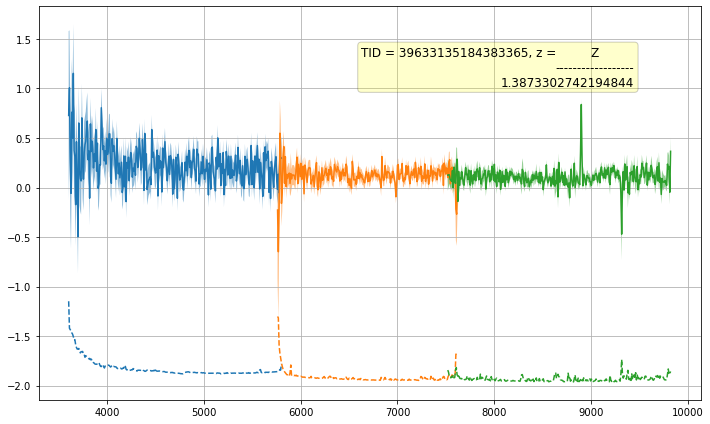

TARGETID=39633135184383529
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135184383529         0          5 ... 60256.45965609 60256.45965609


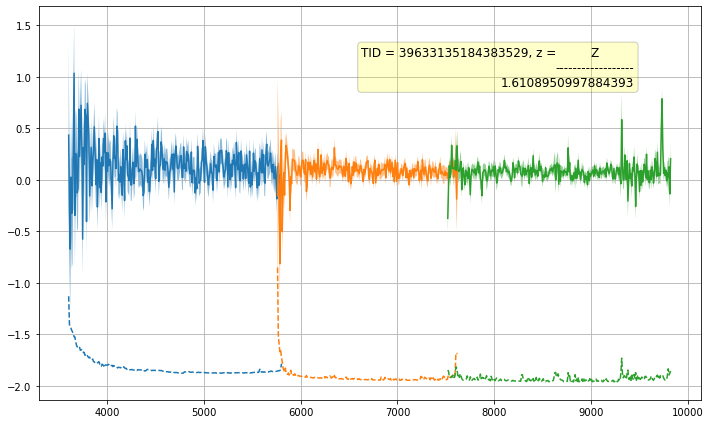

TARGETID=39633135188574262
     TARGETID     PETAL_LOC DEVICE_LOC ...    MAX_MJD        MEAN_MJD   
----------------- --------- ---------- ... -------------- --------------
39633135188574262         0         12 ... 60256.45965609 60256.45965609


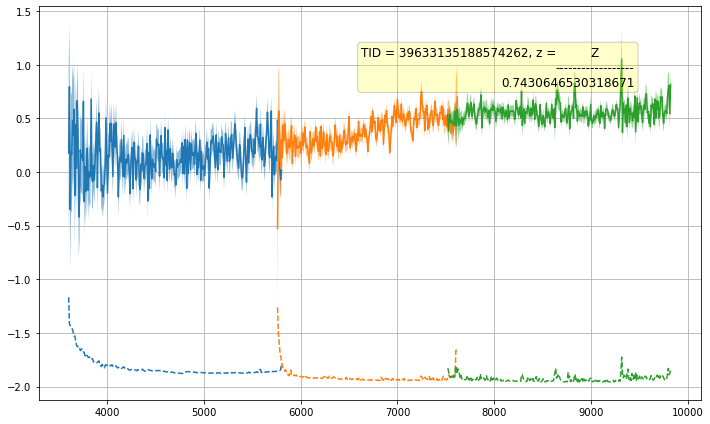

In [16]:
rebin = 10
errors = True
wavescale = 1.0
for tid in targetids :
    line="TARGETID={}".format(tid)

    fig=plt.figure(figsize=[10,6])
    ax = fig.add_subplot(111)
    print(line)
    something_to_show = False
    jj=np.where(spec.fibermap["TARGETID"]==tid)[0]
    
    zz = np.where(redshifts["TARGETID"]==tid)[0]
    redrock_z = redshifts["Z"][zz]
    
    if len(jj)==0 :
        print("TARGETID {} not in spectra".format(tid))
        continue
    something_to_show = True

   

    for j in jj :
        for b in spec._bands :
            i=np.where(spec.ivar[b][j]*(spec.mask[b][j]==0)>1./100.**2)[0]
            if i.size<10 : continue
            if rebin is not None and rebin>0:
                rwave=np.linspace(spec.wave[b][0],spec.wave[b][-1],spec.wave[b].size//rebin)
                rflux,rivar = resample_flux(rwave,spec.wave[b],spec.flux[b][j],ivar=spec.ivar[b][j]*(spec.mask[b][j]==0))
            else:
                rwave = spec.wave[b][i]
                rflux = spec.flux[b][j, i]
                rivar = spec.ivar[b][j, i]
            if errors:
                plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
                                     rflux+1./np.sqrt(rivar), alpha=0.5)
                line, = plt.plot(wavescale*rwave, rflux)
                plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,
                             color=line.get_color(), linestyle='--')
            else:
                plt.plot(wavescale*rwave, rflux)

            c=np.polyfit(spec.wave[b][i],spec.flux[b][j,i],3)
            pol=np.poly1d(c)(spec.wave[b][i])

        print(spec.fibermap[jj])

    plt.grid()
    props = dict(boxstyle='round', facecolor='yellow', alpha=0.2)
    bla="TID = {}, z = {}".format(tid, redrock_z)
    
    plt.text(0.9,0.9,bla,fontsize=12, bbox=props,transform = ax.transAxes,verticalalignment='top', horizontalalignment='right')

    plt.tight_layout()
    plt.show()

In [ ]:
for tid in targetids :
    line="TARGETID={}".format(tid)

    fig=plt.figure(figsize=[10,6])
    ax = fig.add_subplot(111)
    print(line)
    something_to_show = False
    jj=np.where(spec.fibermap["TARGETID"]==tid)[0]
        if len(jj)==0 :
            print("TARGETID {} not in spectra".format(tid))
            continue
        something_to_show = True
        if "FIBER" in spec.fibermap.dtype.names :
            fiber=spec.fibermap["FIBER"][jj[0]]
        else :
            log.warning("no FIBER column in spectra file FIBERMAP")
            fiber=-1
        wavescale=1.
        if args.rest_frame :
            wavescale = 1./(1+zval)

        for j in jj :
            for b in spec._bands :

                i=np.where(spec.ivar[b][j]*(spec.mask[b][j]==0)>1./100.**2)[0]
                if i.size<10 : continue
                if args.rebin is not None and args.rebin>0:
                    rwave=np.linspace(spec.wave[b][0],spec.wave[b][-1],spec.wave[b].size//args.rebin)
                    rflux,rivar = resample_flux(rwave,spec.wave[b],spec.flux[b][j],ivar=spec.ivar[b][j]*(spec.mask[b][j]==0))
                else:
                    rwave = spec.wave[b][i]
                    rflux = spec.flux[b][j, i]
                    rivar = spec.ivar[b][j, i]
                if args.errors:
                    plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
                                     rflux+1./np.sqrt(rivar), alpha=0.5)
                    line, = plt.plot(wavescale*rwave, rflux)
                    plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,
                             color=line.get_color(), linestyle='--')
                else:
                    plt.plot(wavescale*rwave, rflux)

                c=np.polyfit(spec.wave[b][i],spec.flux[b][j,i],3)
                pol=np.poly1d(c)(spec.wave[b][i])

        print(spec.fibermap[jj])

    if not something_to_show :
        log.error("no data to show")
        sys.exit(1)
    if redshifts is not None :
        for band in spectra[0].bands:
            plt.plot(wavescale*spectra[0].wave[band],model_flux[band],"-",alpha=0.6)
            for elem in lines :
                line=(1+zval)*lines[elem]
                if line>spectra[0].wave[band][0] and line<spectra[0].wave[band][-1] :
                    plt.axvline(wavescale*line,color="red",linestyle="--",alpha=0.4)
                    y=np.interp(wavescale*line,wavescale*spectra[0].wave[band],model_flux[band])
                    plt.text(wavescale*(line+60),y*1.1,elem.split("-")[0],color="red")
    if args.rest_frame :
        plt.xlabel("rest-frame wavelength [A]")
    else :
        plt.xlabel("wavelength [A]")
    plt.grid()
    props = dict(boxstyle='round', facecolor='yellow', alpha=0.2)
    bla="TID = {}".format(tid)
    bla+="\nFIBER = {}".format(fiber)
    if redshifts is not None :
        bla+="\nZ  = {:4.3f}".format(zval)
    plt.text(0.9,0.9,bla,fontsize=12, bbox=props,transform = ax.transAxes,verticalalignment='top', horizontalalignment='right')
    if args.ylim is not None:
        plt.ylim(args.ylim[0], args.ylim[1])

    if args.title is not None:
        plt.title(args.title)

    plt.tight_layout()
    plt.show()


In [ ]:
parser = argparse.ArgumentParser(formatter_class=argparse.ArgumentDefaultsHelpFormatter,
                                 description="Display spectra, looping over targets if targetid not set, and optionally show best fit from redrock"
)
parser.add_argument('-i','--infile', type = str, default = None, required = True, nargs="*",
                    help = 'path to spectra file(s)')
parser.add_argument('-t','--targetid', type = int, default = None, required = False,
                    help = 'plot specific targetid')
parser.add_argument('--rebin',type = int, default = None, required = False,
                    help = 'rebin')
parser.add_argument('--redrock',type = str, default = None, required = False,
                    help = 'redrock file')
parser.add_argument('--spectype',type = str, default = None, required = False,
                    help = 'spectype to select')
parser.add_argument('--ylim', type=float, default=None, required=False, nargs=2,
                    help = 'ymin ymax for plot')
parser.add_argument('--title', type=str, default=None, required=False,
                    help = 'plot title')
parser.add_argument('--rest-frame', action='store_true',
                    help = 'show rest-frame wavelength')
parser.add_argument('--errors', action='store_true',
                    help = 'show error bars')
parser.add_argument('--only-valid', action='store_true',
                    help = 'show error bars')
parser.add_argument('--zrange', type=float, default=None, required=False, nargs=2,
                    help = 'zmin zmax (if with redredock)')


args        = parser.parse_args()

log = get_logger()

if  args.redrock is not None :
    #- Load redrock templates
    templates = dict()
    for filename in redrock.templates.find_templates():
        tx = redrock.templates.Template(filename)
        templates[(tx.template_type, tx.sub_type)] = tx

if args.redrock is None and args.rest_frame :
    args.rest_frame = False
    print("cannot show rest-frame wavelength without a redrock file")

spectra = []
for filename in args.infile :
    spec=read_spectra(filename)
    if args.only_valid :
        if "FIBERSTATUS" in spec.fibermap.dtype.names :
            good=(spec.fibermap["FIBERSTATUS"]==0)
        elif "COADD_FIBERSTATUS" in spec.fibermap.dtype.names :
            good=(spec.fibermap["COADD_FIBERSTATUS"]==0)
        else :
            log.error("cannot find FIBERSTATUS nor COADD_FIBERSTATUS in fibermap")
        spec=spec[good]
    spectra.append(spec)

targetids=None
if ( targetids is None ) and ( args.targetid is not None ) :
    targetids=[args.targetid,]

redshifts=None
if  args.redrock is not None :
    try:
        redshifts=read_table(args.redrock, "REDSHIFTS")
    except KeyError:
        redshifts=read_table(args.redrock, "ZBEST")
    except OSError:
        redshifts=read_table(args.redrock, "ZBEST")

if ( targetids is None ) and ( redshifts is not None ) and ( args.spectype is not None ):
    selection = np.where((redshifts["SPECTYPE"]==args.spectype)&(redshifts["ZWARN"]==0))[0]
    targetids=np.unique(spectra[0].fibermap["TARGETID"][selection])

if targetids is None :
    targetids=np.unique(spectra[0].fibermap["TARGETID"])

if redshifts is not None and args.zrange is not None :
    selection = np.in1d(spectra[0].fibermap["TARGETID"],targetids)&(redshifts["Z"]>=args.zrange[0])&(redshifts["Z"]<=args.zrange[1])
    targetids=np.unique(spectra[0].fibermap["TARGETID"][selection])


lines = {
    'Ha'      : 6562.8,
    'Hb'       : 4862.68,
    'Hg'       : 4340.464,
    'Hd'       : 4101.734,
    'OIII-b'       :  5006.843,
    'OIII-a'       : 4958.911,
    'MgII'    : 2799.49,
    'OII'         : 3728,
    'CIII'  : 1909.,
    'CIV'    : 1549.06,
    'SiIV'  : 1393.76018,
    'LYA'         : 1215.67,
    'LYB'         : 1025.72
}



for tid in targetids :
    line="TARGETID={}".format(tid)

    model_flux=dict()
    if redshifts is not None :
        j=np.where(redshifts["TARGETID"]==tid)[0][0]
        line += " Z={} SPECTYPE={} ZWARN={}".format(redshifts["Z"][j],redshifts["SPECTYPE"][j],redshifts["ZWARN"][j])
        zval=redshifts["Z"][j]
        tx = templates[(redshifts['SPECTYPE'][j], redshifts['SUBTYPE'][j])]
        for band in spectra[0].bands:
            model_flux[band] = np.zeros(spectra[0].wave[band].shape)
            coeff = redshifts['COEFF'][j][0:tx.nbasis]
            model = tx.flux.T.dot(coeff).T
            mx = resample_flux(spectra[0].wave[band], tx.wave*(1+redshifts['Z'][j]), model)
            k=np.where(spectra[0].fibermap["TARGETID"]==tid)[0][0]
            model_flux[band] = spectra[0].R[band][k].dot(mx)

    fig=plt.figure(figsize=[10,6])
    ax = fig.add_subplot(111)
    print(line)
    something_to_show = False
    for spec in spectra :
        jj=np.where(spec.fibermap["TARGETID"]==tid)[0]
        if len(jj)==0 :
            log.warning("TARGETID {} not in spectra".format(tid))
            continue
        something_to_show = True
        if "FIBER" in spec.fibermap.dtype.names :
            fiber=spec.fibermap["FIBER"][jj[0]]
        else :
            log.warning("no FIBER column in spectra file FIBERMAP")
            fiber=-1
        wavescale=1.
        if args.rest_frame :
            wavescale = 1./(1+zval)

        for j in jj :
            for b in spec._bands :

                i=np.where(spec.ivar[b][j]*(spec.mask[b][j]==0)>1./100.**2)[0]
                if i.size<10 : continue
                if args.rebin is not None and args.rebin>0:
                    rwave=np.linspace(spec.wave[b][0],spec.wave[b][-1],spec.wave[b].size//args.rebin)
                    rflux,rivar = resample_flux(rwave,spec.wave[b],spec.flux[b][j],ivar=spec.ivar[b][j]*(spec.mask[b][j]==0))
                else:
                    rwave = spec.wave[b][i]
                    rflux = spec.flux[b][j, i]
                    rivar = spec.ivar[b][j, i]
                if args.errors:
                    plt.fill_between(wavescale*rwave, rflux-1./np.sqrt(rivar),
                                     rflux+1./np.sqrt(rivar), alpha=0.5)
                    line, = plt.plot(wavescale*rwave, rflux)
                    plt.plot(wavescale*rwave, 1/np.sqrt(rivar)-2,
                             color=line.get_color(), linestyle='--')
                else:
                    plt.plot(wavescale*rwave, rflux)

                c=np.polyfit(spec.wave[b][i],spec.flux[b][j,i],3)
                pol=np.poly1d(c)(spec.wave[b][i])

        print(spec.fibermap[jj])

    if not something_to_show :
        log.error("no data to show")
        sys.exit(1)
    if redshifts is not None :
        for band in spectra[0].bands:
            plt.plot(wavescale*spectra[0].wave[band],model_flux[band],"-",alpha=0.6)
            for elem in lines :
                line=(1+zval)*lines[elem]
                if line>spectra[0].wave[band][0] and line<spectra[0].wave[band][-1] :
                    plt.axvline(wavescale*line,color="red",linestyle="--",alpha=0.4)
                    y=np.interp(wavescale*line,wavescale*spectra[0].wave[band],model_flux[band])
                    plt.text(wavescale*(line+60),y*1.1,elem.split("-")[0],color="red")
    if args.rest_frame :
        plt.xlabel("rest-frame wavelength [A]")
    else :
        plt.xlabel("wavelength [A]")
    plt.grid()
    props = dict(boxstyle='round', facecolor='yellow', alpha=0.2)
    bla="TID = {}".format(tid)
    bla+="\nFIBER = {}".format(fiber)
    if redshifts is not None :
        bla+="\nZ  = {:4.3f}".format(zval)
    plt.text(0.9,0.9,bla,fontsize=12, bbox=props,transform = ax.transAxes,verticalalignment='top', horizontalalignment='right')
    if args.ylim is not None:
        plt.ylim(args.ylim[0], args.ylim[1])

    if args.title is not None:
        plt.title(args.title)

    plt.tight_layout()
    plt.show()


plt.show()